<a href="https://colab.research.google.com/github/frnocentini/brain-tumor-object-dectection/blob/main/Scratch_7_layers_Earl_Stop.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [3]:
%cd '/content/drive/MyDrive/dataset brain tumor/dataset'

/content/drive/MyDrive/dataset brain tumor/dataset


In [4]:
!unzip 'axial_t1wce_2_class' -d '/dataset unzipped'

Archive:  axial_t1wce_2_class.zip
  inflating: /dataset unzipped/axial_t1wce_2_class/axial_t1wce_2_class.yaml  
   creating: /dataset unzipped/axial_t1wce_2_class/images/
   creating: /dataset unzipped/axial_t1wce_2_class/images/test/
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_101.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_109.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_111.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_117.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_121.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_126.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_134.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00019_66.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00019_75.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/image

In [5]:
!unzip 'coronal_t1wce_2_class' -d '/dataset unzipped'

Archive:  coronal_t1wce_2_class.zip
  inflating: /dataset unzipped/coronal_t1wce_2_class/coronal_t1wce_2_class.yaml  
   creating: /dataset unzipped/coronal_t1wce_2_class/images/
   creating: /dataset unzipped/coronal_t1wce_2_class/images/test/
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/13.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/15.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/17.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/19.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/20.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/23.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/33.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/34.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/35.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/36.jpg  
  inflating: /d

In [6]:
!unzip 'sagittal_t1wce_2_class' -d '/dataset unzipped'

Archive:  sagittal_t1wce_2_class.zip
   creating: /dataset unzipped/sagittal_t1wce_2_class/images/
   creating: /dataset unzipped/sagittal_t1wce_2_class/images/test/
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_102.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_121.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_140.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_159.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_110.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_129.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_147.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_166.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00003_154.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00003_173.jpg  
  inflating: /

In [7]:
# Data Manipulation
import numpy as np
import pandas as pd
import os
# Visualization/Image Processing
import cv2
import matplotlib.pyplot as plt
from tqdm import tqdm
# Machine Learning
import tensorflow as tf
from tensorflow.keras.layers import Conv2D, Input, BatchNormalization, Flatten, MaxPool2D, MaxPooling2D, Dense, Activation, Dropout
from PIL import Image
# Other
from pathlib import Path
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from sklearn.utils import shuffle
from sklearn.model_selection import train_test_split
from tensorflow import keras
from tensorflow.keras.applications import EfficientNetB0
from tensorflow.keras.applications.vgg16 import VGG16
from tensorflow.keras.models import Model
import xml.etree.ElementTree as ET
from tensorflow.keras.models import Sequential
from tensorflow.keras import layers
import imutils
from PIL import Image, ImageEnhance

In [8]:
%cd '/dataset unzipped'

/dataset unzipped


In [9]:
def crop_brain_contour(image, plot=False):
    
    #import imutils
    #import cv2
    #from matplotlib import pyplot as plt
    
    brightness = 30
    image = np.int16(image)
    image = image + brightness
    image = np.clip(image,0,255)
    image = np.uint8(image)
    #image_enhance = ImageEnhance.Brightness(image)
    #factor = 1.5
    #image = image_enhance.enhance(factor)

    # Convert the image to grayscale, and blur it slightl
    
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    gray = cv2.GaussianBlur(gray, (5, 5), 0)

    # Threshold the image, then perform a series of erosions +
    # dilations to remove any small regions of noise
    #thresh = cv2.adaptiveThreshold(gray, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY,11,2)
    thresh = cv2.threshold(gray, 30, 255, cv2.THRESH_BINARY)[1]
    #thresh = cv2.erode(thresh, None, iterations=2)
    #thresh = cv2.dilate(thresh, None, iterations=2)

    # Find contours in thresholded image, then grab the largest one
    cnts = cv2.findContours(thresh.copy(), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    cnts = imutils.grab_contours(cnts)
    c = max(cnts, key=cv2.contourArea)
    

    # Find the extreme points
    extLeft = tuple(c[c[:, :, 0].argmin()][0])
    extRight = tuple(c[c[:, :, 0].argmax()][0])
    extTop = tuple(c[c[:, :, 1].argmin()][0])
    extBot = tuple(c[c[:, :, 1].argmax()][0])
    
    # crop new image out of the original image using the four extreme points (left, right, top, bottom)
    new_image = image[extTop[1]:extBot[1], extLeft[0]:extRight[0]]            

    if plot:
        plt.figure()

        plt.subplot(1, 2, 1)
        plt.imshow(image)
        
        plt.tick_params(axis='both', which='both', 
                        top=False, bottom=False, left=False, right=False,
                        labelbottom=False, labeltop=False, labelleft=False, labelright=False)
        
        plt.title('Original Image')
            
        plt.subplot(1, 2, 2)
        plt.imshow(new_image)

        plt.tick_params(axis='both', which='both', 
                        top=False, bottom=False, left=False, right=False,
                        labelbottom=False, labeltop=False, labelleft=False, labelright=False)

        plt.title('Cropped Image')
        
        plt.show()

    #add contrast
    #kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE,(3,3))
    # Top Hat Transform
    #topHat = cv2.morphologyEx(new_image, cv2.MORPH_TOPHAT, kernel)
    # Black Hat Transform
    #blackHat = cv2.morphologyEx(new_image, cv2.MORPH_BLACKHAT, kernel)
    
    #new_image = new_image + topHat - blackHat
    
    return new_image,extLeft,extRight,extTop,extBot

In [10]:
#Codice per rendere l'immagine quadrata 
def make_square(im, fill_color=(0, 0, 0, 0)):
    x, y = im.shape[0], im.shape[1]
    size = max(x, y)
    BLACK = [0, 0, 0]
    new_im = cv2.copyMakeBorder(im,int((size-y)/2),int((size-y)/2),int((size-x)/2),int((size-x)/2),cv2.BORDER_CONSTANT, value = BLACK)
    return new_im

In [11]:
#Bounding box with one tumor
lab = ['axial_t1wce_2_class','coronal_t1wce_2_class', 'sagittal_t1wce_2_class']
X_train = []
bb = []
count = 0;
temp_array  = []
extLeft_coords_x = []
extLeft_coords_y = []
extRight_coords_x = []
extRight_coords_y = []
extTop_coords_x = []
extTop_coords_y = []
extBot_coords_x = []
extBot_coords_y = []
image_width = []
image_height = []


extLeft_coords_x_test = []
extLeft_coords_y_test = []
extRight_coords_x_test = []
extRight_coords_y_test = []
extTop_coords_x_test = []
extTop_coords_y_test = []
extBot_coords_x_test = []
extBot_coords_y_test = []
images_width_test = []
images_height_test = []
width_new_im = []
height_new_im = []
traslazione_x_test = []
traslazione_y_test = []

image_size = 224

for i in lab:
    folderPath = os.path.join('./',i,'images','train')
    for j in sorted(os.listdir(folderPath)):
        #load the image
        img = cv2.imread(os.path.join(folderPath,j))
        image_width.append(img.shape[1])
        image_height.append(img.shape[0])
        # crop the brain and ignore the unnecessary rest part of the image
        image,extLeft,extRight,extTop,extBot = crop_brain_contour(img,False)
        extLeft_coords_x.append(extLeft[0])
        extLeft_coords_y.append(extLeft[1])
        extRight_coords_x.append(extRight[0])
        extRight_coords_y.append(extRight[1])
        extTop_coords_x.append(extTop[0])
        extTop_coords_y.append(extTop[1])
        extBot_coords_x.append(extBot[0])
        extBot_coords_y.append(extBot[1])
        # resize image
        image = cv2.resize(image, dsize=(image_size, image_size), interpolation=cv2.INTER_CUBIC)
        #if img.shape[0] != img.shape[1]:
            #img = make_square(img, fill_color=(0, 0, 0, 0))
        #img = cv2.resize(img,(image_size, image_size))
        X_train.append(image)

image_index = 0
#bb_train = np.zeros((len(X_train),4))
bb_list = []
duplicate_img = []
for i in lab:
    labelsPath = os.path.join('./',i,'labels','train')
    for j in sorted(os.listdir(labelsPath)):
        with open(os.path.join(labelsPath,j), encoding="utf-8") as f:
            lbls_array = []
            for line in f:
                num = list(map(float,line.split(" ")))
                temp_array = []
                for k in num:
                    temp_array.append(k)
                temp_array.pop(0)
                 
                temp_array[0] = temp_array[0]*image_width[count] #centro x immagine originale
                temp_array[0] = temp_array[0]-extLeft_coords_x[count]
                temp_array[0] = (temp_array[0]/(extRight_coords_x[count]-extLeft_coords_x[count]))*image_size
                
                temp_array[1] = temp_array[1]*image_height[count]
                temp_array[1] = temp_array[1]-extTop_coords_y[count]
                temp_array[1] = (temp_array[1]/(extBot_coords_y[count]-extTop_coords_y[count]))*image_size
                
                temp_array[2] = temp_array[2]*(image_width[count])
                temp_array[2] = (temp_array[2]/(extRight_coords_x[count]-extLeft_coords_x[count]))*image_size
                
                
                temp_array[3] = temp_array[3]*(image_height[count])
                temp_array[3] = (temp_array[3]/(extBot_coords_y[count]-extTop_coords_y[count]))*image_size                 
            
                lbls_array.append(temp_array)

                #print(temp_array)
                #bb_train[image_index] = np.array([temp_array])
                #print(bb_train[image_index])

            bb_list.append(temp_array)
            duplicate_img.append(lbls_array)
            image_index += 1
            count += 1

#Codice per duplicare le immagini con due bounding box
print('Dimensione delle liste prima di duplicare le immagini:')
print('X_train: ', len(X_train))
print('bb_list: ', len(bb_list))

for i in range(len(X_train)):
  if(len(duplicate_img[i]) == 2):
    X_train.append(X_train[i])
    bb_list.append(duplicate_img[i][0])  #dentro bb_list è già stata inserita la seconda label, quindi ora insieriamo la prima per l'immagine duplicata
bb_train = np.zeros((len(X_train),4))

for j in range(len(bb_list)):
  bb_train[j] = np.array([bb_list[j]])

#Dimensione delle liste dopo la duplicazione delle immagini:
print('Dimensione delle liste dopo la duplicazione delle immagini:')
print('X_train: ', len(X_train))
print('bb_train: ', len(bb_train))

X_test = []
for i in lab:
    folderPath = os.path.join('./',i,'images','test')
    for j in sorted(os.listdir(folderPath)):
        #load the image
        img = cv2.imread(os.path.join(folderPath,j))
        images_width_test.append(img.shape[1])
        images_height_test.append(img.shape[0])
        # crop the brain and ignore the unnecessary rest part of the image
        image_test,extLeft_test,extRight_test,extTop_test,extBot_test = crop_brain_contour(img,False)
        extLeft_coords_x_test.append(extLeft_test[0])
        extLeft_coords_y_test.append(extLeft_test[1])
        extRight_coords_x_test.append(extRight_test[0])
        extRight_coords_y_test.append(extRight_test[1])
        extTop_coords_x_test.append(extTop_test[0])
        extTop_coords_y_test.append(extTop_test[1])
        extBot_coords_x_test.append(extBot_test[0])
        extBot_coords_y_test.append(extBot_test[1])
        # resize image
        image_test = cv2.resize(image_test, dsize=(image_size, image_size), interpolation=cv2.INTER_CUBIC)
        #if img.shape[0] != img.shape[1]:
            #img = make_square(img, fill_color=(0, 0, 0, 0))
        #img = cv2.resize(img,(image_size, image_size))
        X_test.append(image_test)

image_index = 0
count_test = 0;
#bb_test = np.zeros((len(X_test),4))
bb_list = []
duplicate_img = []
for i in lab:
    labelsPath = os.path.join('./',i,'labels','test')
    for j in sorted(os.listdir(labelsPath)):
        with open(os.path.join(labelsPath,j), encoding="utf-8") as f:
            lbls_array = []
            for line in f:
                num = list(map(float,line.split(" ")))
                temp_array = []
                for k in num:
                    temp_array.append(k)
                temp_array.pop(0)
                #width_new_im.append(extRight_coords_x_test[count_test]-extLeft_coords_x_test[count_test])
                #height_new_im.append(extBot_coords_y_test[count_test]-extTop_coords_y_test[count_test])
                
                
                temp_array[0] = temp_array[0]*images_width_test[count_test] #centro x immagine originale
                temp_array[0] = temp_array[0]-extLeft_coords_x_test[count_test]
                temp_array[0] = (temp_array[0]/(extRight_coords_x_test[count_test]-extLeft_coords_x_test[count_test]))*image_size
                
                temp_array[1] = temp_array[1]*images_height_test[count_test]
                temp_array[1] = temp_array[1]-extTop_coords_y_test[count_test]
                temp_array[1] = (temp_array[1]/(extBot_coords_y_test[count_test]-extTop_coords_y_test[count_test]))*image_size
                
                temp_array[2] = temp_array[2]*(images_width_test[count_test])
                temp_array[2] = (temp_array[2]/(extRight_coords_x_test[count_test]-extLeft_coords_x_test[count_test]))*image_size
                
                
                temp_array[3] = temp_array[3]*(images_height_test[count_test])
                temp_array[3] = (temp_array[3]/(extBot_coords_y_test[count_test]-extTop_coords_y_test[count_test]))*image_size                 
            
                lbls_array.append(temp_array)

                #bb_test[image_index] = np.array([temp_array])
                #print(bb_test[image_index])

            bb_list.append(temp_array)
            duplicate_img.append(lbls_array)
            image_index += 1
            count_test += 1

#Codice per duplicare le immagini con due bounding box
print('Dimensione delle liste prima di duplicare le immagini:')
print('X_test: ', len(X_test))
print('bb_list: ', len(bb_list))

for i in range(len(X_test)):
  if(len(duplicate_img[i]) == 2):
    X_test.append(X_test[i])
    bb_list.append(duplicate_img[i][0])  #dentro bb_list è già stata inserita la seconda label, quindi ora insieriamo la prima per l'immagine duplicata

bb_test = np.zeros((len(X_test),4))

for j in range(len(bb_test)):
  bb_test[j] = np.array([bb_list[j]])

#Dimensione delle liste dopo la duplicazione delle immagini:
print('Dimensione delle liste dopo la duplicazione delle immagini:')
print('X_test: ', len(X_test))
print('bb_test: ', len(bb_test))

#print(bb_test[30])
#print(extRight_coords_x_test[30])
#print(extLeft_coords_x_test[30])
     


Dimensione delle liste prima di duplicare le immagini:
X_train:  878
bb_list:  878
Dimensione delle liste dopo la duplicazione delle immagini:
X_train:  919
bb_train:  919
Dimensione delle liste prima di duplicare le immagini:
X_test:  223
bb_list:  223
Dimensione delle liste dopo la duplicazione delle immagini:
X_test:  237
bb_test:  237


In [12]:
#prepare dataset 
train_dataset = ImageDataGenerator()
val_dataset = ImageDataGenerator()
test_dataset = ImageDataGenerator()

In [13]:
datagen = ImageDataGenerator(
  rescale = 1./255,
  #rotation_range = 5,
  shear_range = 0.02,
  #zoom_range = 0.02, 
  samplewise_center = True,
  samplewise_std_normalization = True
  #horizontal_flip=True
)

val_data_gen = ImageDataGenerator(rescale = 1./255)

In [14]:
#array conversion
X_train = np.array(X_train)
X_test = np.array(X_test)

In [15]:
#Shuffle
X_train, bb_train = shuffle(X_train, bb_train)

In [16]:
#Validation set created
X_train, X_val, bb_train, bb_val = train_test_split(X_train, bb_train, test_size = 0.1, shuffle = False)

In [17]:
tf.keras.backend.set_image_data_format('channels_last')
BATCH_SIZE = 32
#save_path = os.path.join('./', 'model_from_scratch')
train_dataset = train_dataset.flow(X_train, bb_train, batch_size = BATCH_SIZE)
val_dataset = val_dataset.flow(X_val, bb_val, batch_size = BATCH_SIZE)
test_dataset = test_dataset.flow(X_test, bb_test)

In [18]:
input_ = Input(shape=[image_size,image_size, 3])

x = input_

for i in range(7):
    n_filters = 2**(i + 3)
    x = Conv2D(n_filters, 3, activation='relu', padding='same')(x)
    x = BatchNormalization()(x)
    x = MaxPool2D(2, padding='same')(x)

x = Dropout(0.5)(x)
x = Flatten()(x)
x = Dense(256, activation='relu')(x)
x = Dense(32, activation='relu')(x)
output = Dense(4, name='coords')(x)

model = tf.keras.models.Model(input_, output)
model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 conv2d (Conv2D)             (None, 224, 224, 8)       224       
                                                                 
 batch_normalization (BatchN  (None, 224, 224, 8)      32        
 ormalization)                                                   
                                                                 
 max_pooling2d (MaxPooling2D  (None, 112, 112, 8)      0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 112, 112, 16)      1168      
                                                                 
 batch_normalization_1 (Batc  (None, 112, 112, 16)     64    

In [19]:
# Draw the predicted bounding boxes
def display_image(img, bbox_coords, pred_coords):
    if len(bbox_coords) == 4: #in rosso
        xmin, ymin, height, width = bbox_coords
        img = cv2.rectangle(img, (int(xmin-height/2), int(ymin-width/2)), (int(xmin+height/2), int(ymin+width/2)), (255, 0, 0), 1)
    print(len(pred_coords))    
    if len(pred_coords) == 4: #in verde
        xmin1, ymin1, height1, width1 = pred_coords
        img = cv2.rectangle(img, (int(xmin1-height1/2), int(ymin1-width1/2)), (int(xmin1+height1/2), int(ymin1+width1/2)), (0, 255, 0), 1)
    plt.imshow(img)
    plt.xticks([])
    plt.yticks([])

In [20]:
#To test the model
def test_model(model):
    rand_index = np.random.randint(0, bb_test.shape[0])
    pred_bbox = model.predict(X_test)[rand_index]
    img_original = X_test[rand_index]
    img = img_original.copy()
    coords = bb_test[rand_index]
    #example, label = next(datagen)
    #X = example['image']
    #y = label['coords']
    #pred_bbox = model.predict(X)[0]
    #img = X[0]
    #gt_coords = y[0]
    
    display_image(img,bbox_coords = coords, pred_coords=pred_bbox)

def test(model):
    
    plt.figure(figsize=(15,7))
    for i in range(3):
        plt.subplot(1, 3, i + 1)
        test_model(model)    
    plt.show()

class ShowTestImages(tf.keras.callbacks.Callback):
    def on_epoch_end(self, epoch, logs=None):
        test(self.model)
        

In [21]:
%cd '../content/drive/MyDrive'
! mkdir  model_checkpoint_SCRATCH

save_path = './model_checkpoint_SCRATCH/model_SCRATCH.h5'
     

/content/drive/MyDrive
mkdir: cannot create directory ‘model_checkpoint_SCRATCH’: File exists


In [22]:
callbacks_list = [
    keras.callbacks.ModelCheckpoint(
    save_format = 'h5',
    filepath=save_path,
    monitor='val_IoU',
    verbose=1,
    mode = 'max',
    save_best_only=True
    ),
    ShowTestImages()
]

In [23]:
METRIC_THRESH = 0.3

def raw_iou(y_true, y_pred):
    results = []
    for i in range(0,y_true.shape[0]):


        boxTrue_width = y_true[i,2]
        boxTrue_height = y_true[i,3]
        x_boxTrue_tleft = y_true[i,0]-boxTrue_width/2  # numpy index selection
        y_boxTrue_tleft = y_true[i,1]-boxTrue_height/2
    
        area_boxTrue = (boxTrue_width * boxTrue_height)

        # boxPred
        boxPred_width = y_pred[i,2]
        boxPred_height = y_pred[i,3]
        x_boxPred_tleft = y_pred[i,0]-boxPred_width/2  
        y_boxPred_tleft = y_pred[i,1]-boxPred_height/2
    
        area_boxPred = (boxPred_width * boxPred_height)


        # calculate the bottom right coordinates for boxTrue and boxPred

        # boxTrue
        x_boxTrue_br = x_boxTrue_tleft + boxTrue_width
        y_boxTrue_br = y_boxTrue_tleft + boxTrue_height # Version 2 revision

        # boxPred
        x_boxPred_br = x_boxPred_tleft + boxPred_width
        y_boxPred_br = y_boxPred_tleft + boxPred_height # Version 2 revision


        # calculate the top left and bottom right coordinates for the intersection box, boxInt

        # boxInt - top left coords
        x_boxInt_tleft = np.max([x_boxTrue_tleft,x_boxPred_tleft])
        y_boxInt_tleft = np.max([y_boxTrue_tleft,y_boxPred_tleft]) # Version 2 revision

        # boxInt - bottom right coords
        x_boxInt_br = np.min([x_boxTrue_br,x_boxPred_br])
        y_boxInt_br = np.min([y_boxTrue_br,y_boxPred_br]) 

        # Calculate the area of boxInt, i.e. the area of the intersection 
        # between boxTrue and boxPred.
        # The np.max() function forces the intersection area to 0 if the boxes don't overlap.
        
        
        # Version 2 revision
        area_of_intersection = \
        np.max([0,(x_boxInt_br - x_boxInt_tleft)]) * np.max([0,(y_boxInt_br - y_boxInt_tleft)])

        iou = np.mean(area_of_intersection / ((area_boxTrue + area_boxPred) - area_of_intersection)).astype(np.float32)


        # This must match the type used in py_func
        results.append(iou)
    return np.mean(results)
def IoU(y_true, y_pred):
    iou = tf.numpy_function(raw_iou, [y_true, y_pred], tf.float32)
    return iou

In [24]:
model.compile(
    loss={
        'coords': 'mae'
    },
    optimizer=tf.keras.optimizers.Adam(1e-3),
    metrics=[IoU]
)

Epoch 1/200
25/26 [===========================>..] - ETA: 0s - loss: 32.3934 - IoU: 0.0672
Epoch 1: val_IoU improved from -inf to 0.00335, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 30ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4


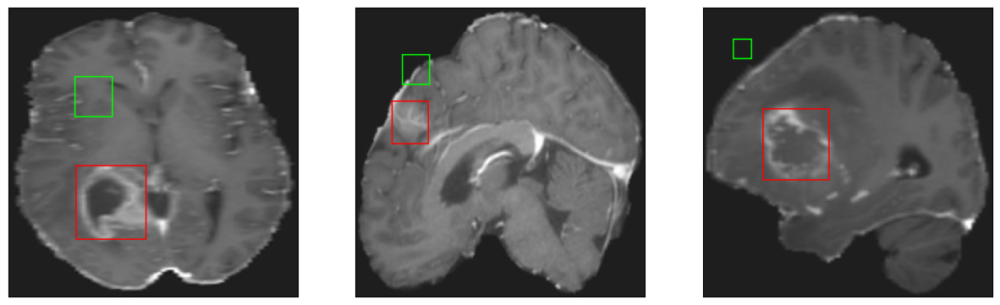

26/26 [==============================] - 20s 168ms/step - loss: 32.0565 - IoU: 0.0681 - val_loss: 45.5657 - val_IoU: 0.0034
Epoch 2/200
25/26 [===========================>..] - ETA: 0s - loss: 19.7336 - IoU: 0.1632
Epoch 2: val_IoU improved from 0.00335 to 0.10779, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


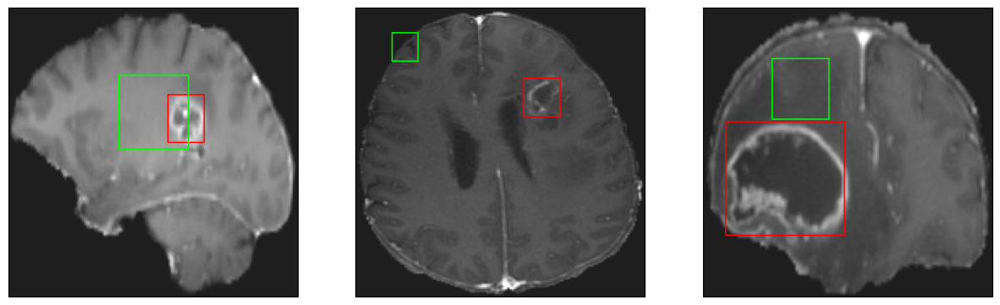

26/26 [==============================] - 3s 122ms/step - loss: 19.5116 - IoU: 0.1691 - val_loss: 26.6390 - val_IoU: 0.1078
Epoch 3/200
25/26 [===========================>..] - ETA: 0s - loss: 15.7975 - IoU: 0.2560
Epoch 3: val_IoU did not improve from 0.10779
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


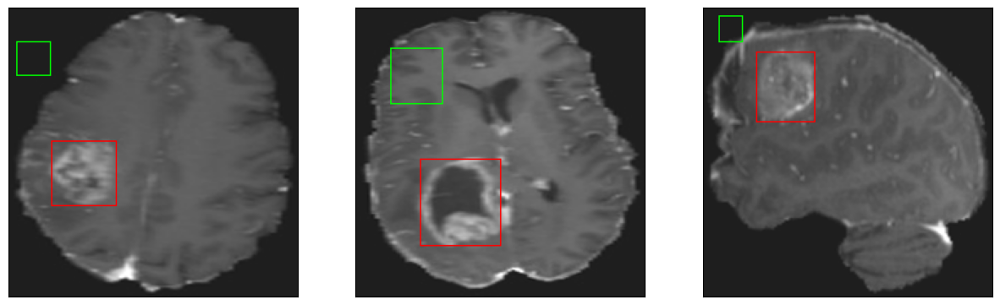

26/26 [==============================] - 2s 88ms/step - loss: 15.7183 - IoU: 0.2590 - val_loss: 41.1466 - val_IoU: 0.0156
Epoch 4/200
25/26 [===========================>..] - ETA: 0s - loss: 13.6348 - IoU: 0.3056
Epoch 4: val_IoU did not improve from 0.10779
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


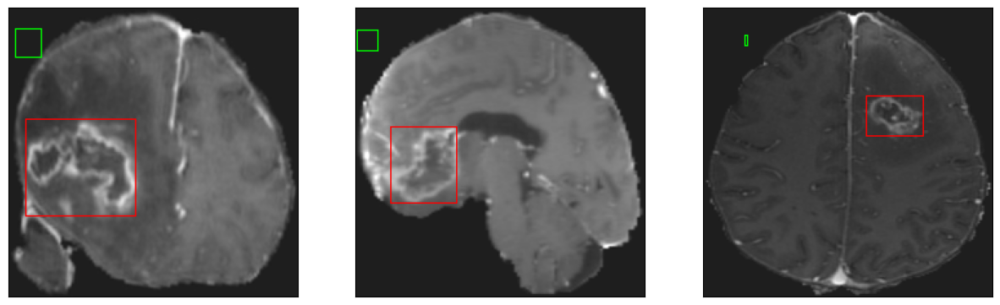

26/26 [==============================] - 2s 88ms/step - loss: 13.6652 - IoU: 0.3061 - val_loss: 59.0570 - val_IoU: 0.0000e+00
Epoch 5/200
25/26 [===========================>..] - ETA: 0s - loss: 12.8701 - IoU: 0.3340
Epoch 5: val_IoU did not improve from 0.10779
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


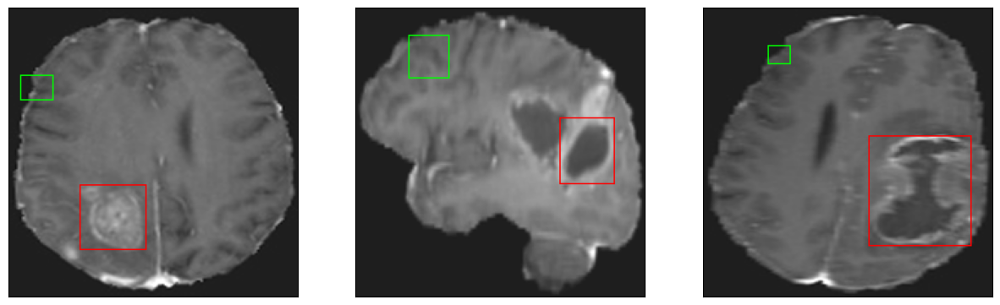

26/26 [==============================] - 2s 90ms/step - loss: 12.8930 - IoU: 0.3328 - val_loss: 50.3301 - val_IoU: 2.4322e-04
Epoch 6/200
25/26 [===========================>..] - ETA: 0s - loss: 11.7460 - IoU: 0.3648
Epoch 6: val_IoU did not improve from 0.10779
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4


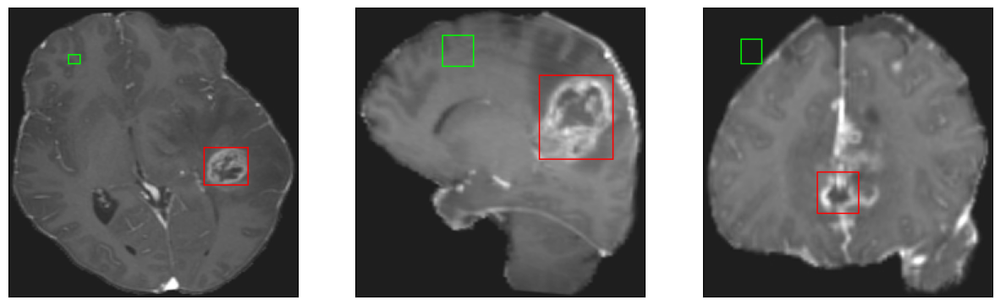

26/26 [==============================] - 3s 100ms/step - loss: 11.6642 - IoU: 0.3657 - val_loss: 54.6888 - val_IoU: 0.0000e+00
Epoch 7/200
26/26 [==============================] - ETA: 0s - loss: 11.1409 - IoU: 0.3757
Epoch 7: val_IoU did not improve from 0.10779
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


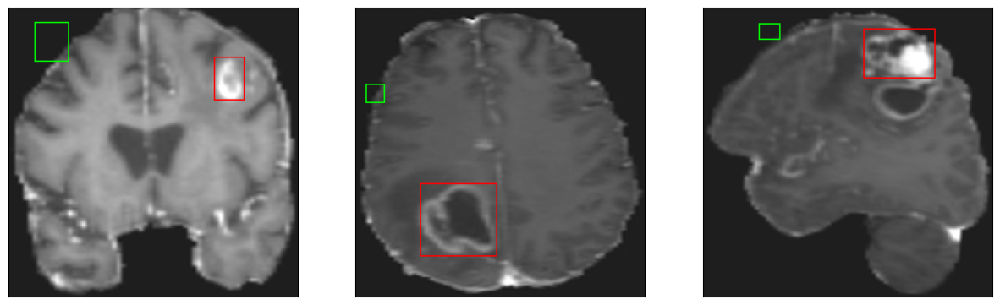

26/26 [==============================] - 2s 93ms/step - loss: 11.1409 - IoU: 0.3757 - val_loss: 48.7301 - val_IoU: 3.9160e-04
Epoch 8/200
26/26 [==============================] - ETA: 0s - loss: 10.6323 - IoU: 0.3941
Epoch 8: val_IoU did not improve from 0.10779
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


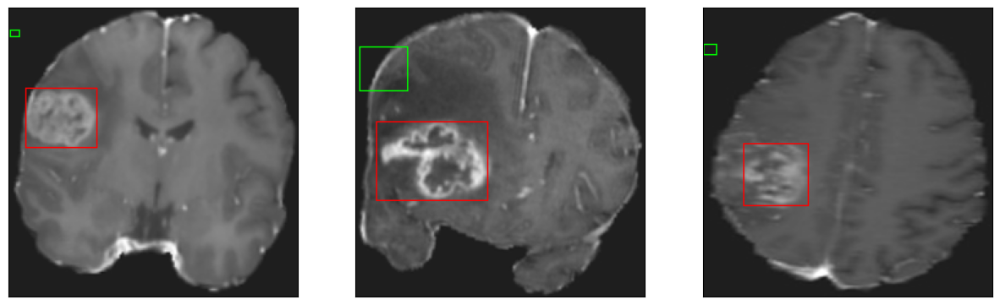

26/26 [==============================] - 2s 91ms/step - loss: 10.6323 - IoU: 0.3941 - val_loss: 48.5885 - val_IoU: 2.6150e-04
Epoch 9/200
26/26 [==============================] - ETA: 0s - loss: 10.1464 - IoU: 0.4113
Epoch 9: val_IoU did not improve from 0.10779
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


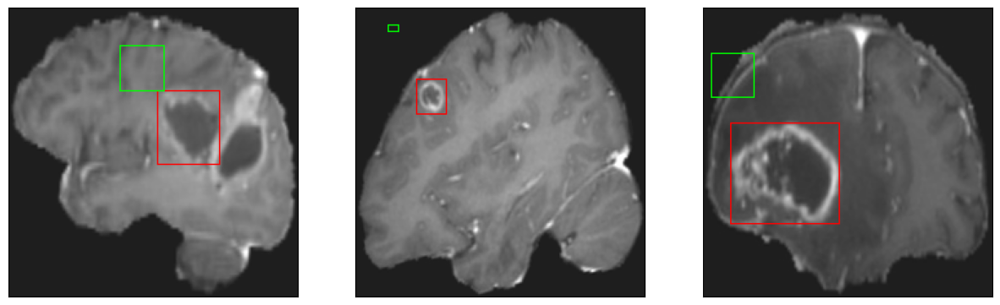

26/26 [==============================] - 3s 112ms/step - loss: 10.1464 - IoU: 0.4113 - val_loss: 45.4086 - val_IoU: 0.0022
Epoch 10/200
26/26 [==============================] - ETA: 0s - loss: 9.7712 - IoU: 0.4268
Epoch 10: val_IoU did not improve from 0.10779
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 12ms/step
4


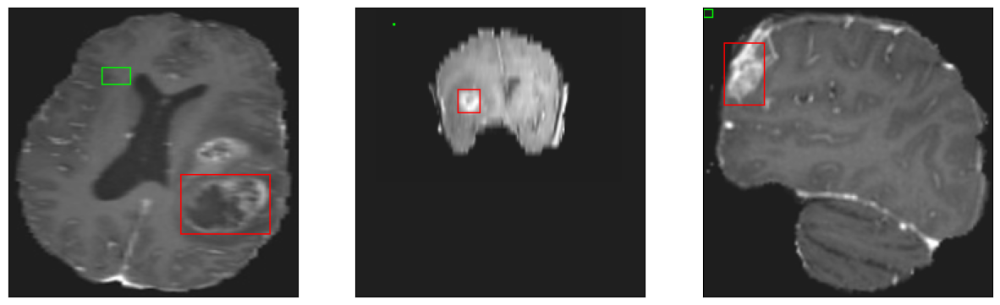

26/26 [==============================] - 3s 112ms/step - loss: 9.7712 - IoU: 0.4268 - val_loss: 51.9984 - val_IoU: 5.9207e-04
Epoch 11/200
26/26 [==============================] - ETA: 0s - loss: 9.5633 - IoU: 0.4197
Epoch 11: val_IoU did not improve from 0.10779
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 6ms/step
4


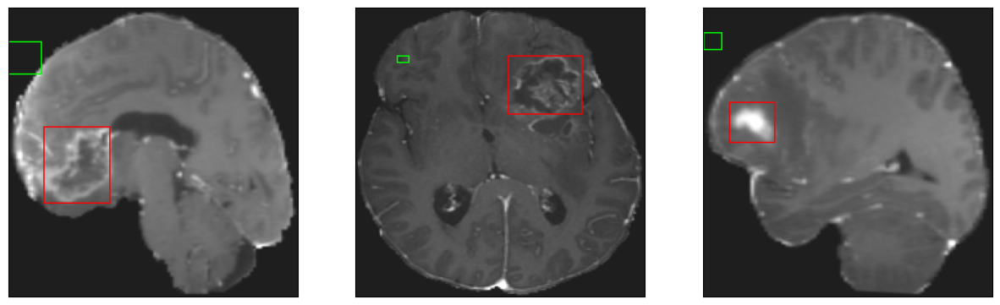

26/26 [==============================] - 3s 110ms/step - loss: 9.5633 - IoU: 0.4197 - val_loss: 41.8869 - val_IoU: 0.0045
Epoch 12/200
25/26 [===========================>..] - ETA: 0s - loss: 8.8249 - IoU: 0.4615
Epoch 12: val_IoU did not improve from 0.10779
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 8ms/step
4


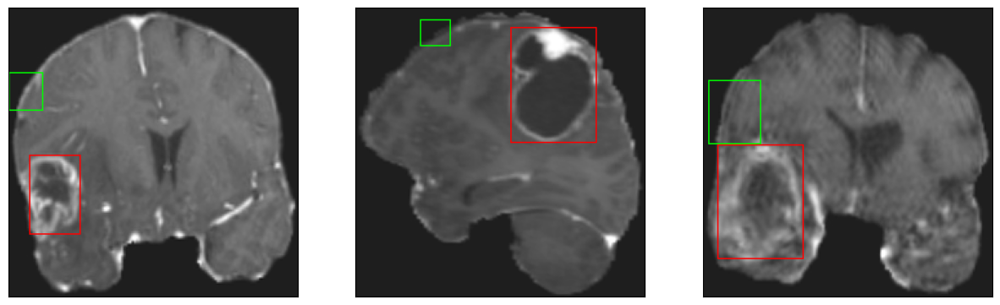

26/26 [==============================] - 3s 111ms/step - loss: 8.8372 - IoU: 0.4609 - val_loss: 43.2402 - val_IoU: 0.0032
Epoch 13/200
25/26 [===========================>..] - ETA: 0s - loss: 8.6766 - IoU: 0.4592
Epoch 13: val_IoU did not improve from 0.10779
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


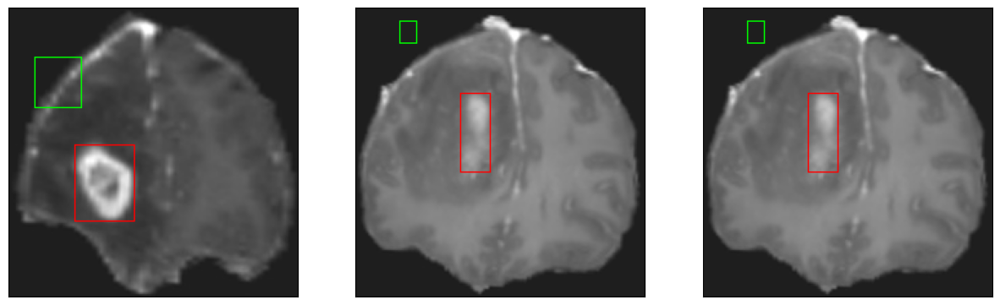

26/26 [==============================] - 2s 95ms/step - loss: 8.6901 - IoU: 0.4568 - val_loss: 44.1017 - val_IoU: 0.0016
Epoch 14/200
26/26 [==============================] - ETA: 0s - loss: 8.3082 - IoU: 0.4715
Epoch 14: val_IoU did not improve from 0.10779
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4


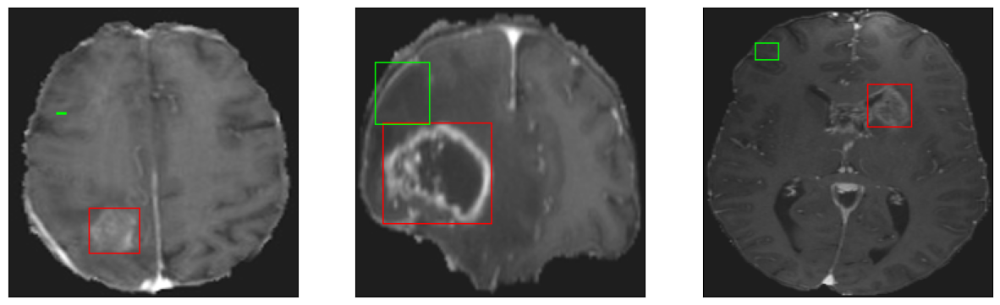

26/26 [==============================] - 3s 104ms/step - loss: 8.3082 - IoU: 0.4715 - val_loss: 43.6647 - val_IoU: 0.0015
Epoch 15/200
26/26 [==============================] - ETA: 0s - loss: 8.3971 - IoU: 0.4703
Epoch 15: val_IoU did not improve from 0.10779
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4


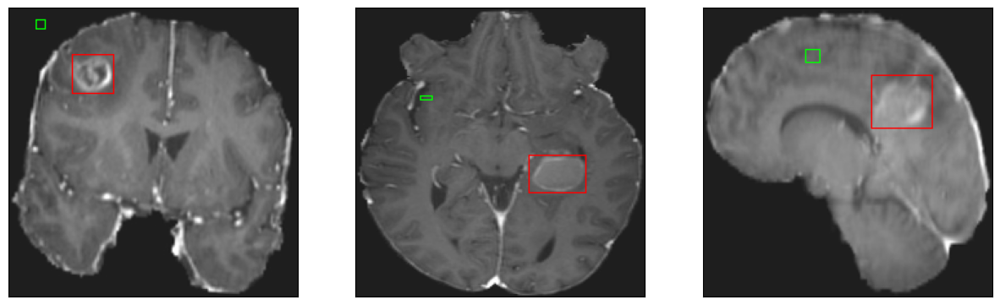

26/26 [==============================] - 3s 126ms/step - loss: 8.3971 - IoU: 0.4703 - val_loss: 42.0401 - val_IoU: 0.0026
Epoch 16/200
25/26 [===========================>..] - ETA: 0s - loss: 8.8353 - IoU: 0.4579
Epoch 16: val_IoU did not improve from 0.10779
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


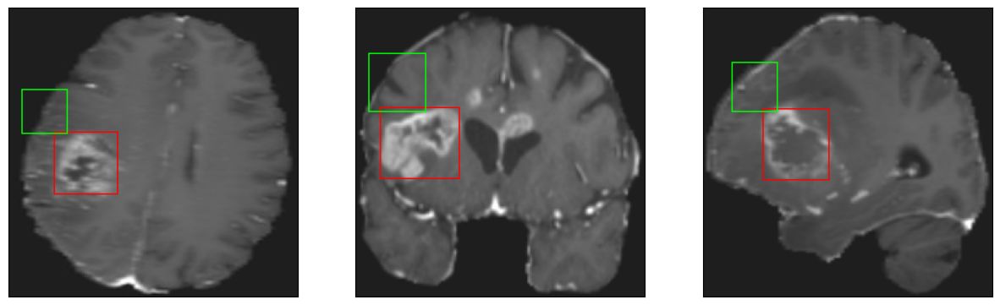

26/26 [==============================] - 2s 94ms/step - loss: 9.0201 - IoU: 0.4496 - val_loss: 24.7148 - val_IoU: 0.0684
Epoch 17/200
26/26 [==============================] - ETA: 0s - loss: 8.1639 - IoU: 0.4768
Epoch 17: val_IoU did not improve from 0.10779
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


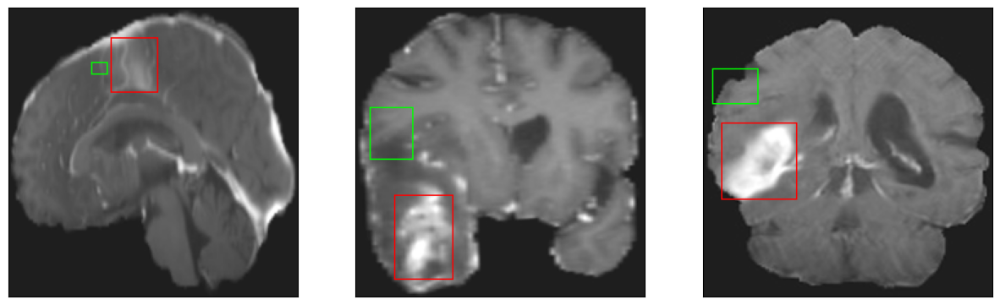

26/26 [==============================] - 2s 97ms/step - loss: 8.1639 - IoU: 0.4768 - val_loss: 37.6889 - val_IoU: 0.0079
Epoch 18/200
26/26 [==============================] - ETA: 0s - loss: 8.1259 - IoU: 0.4753
Epoch 18: val_IoU did not improve from 0.10779
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


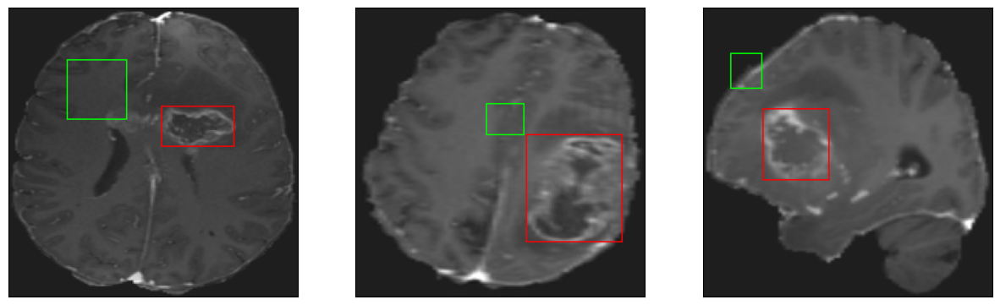

26/26 [==============================] - 2s 91ms/step - loss: 8.1259 - IoU: 0.4753 - val_loss: 31.1852 - val_IoU: 0.0189
Epoch 19/200
25/26 [===========================>..] - ETA: 0s - loss: 8.0560 - IoU: 0.4925
Epoch 19: val_IoU did not improve from 0.10779
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 11ms/step
4


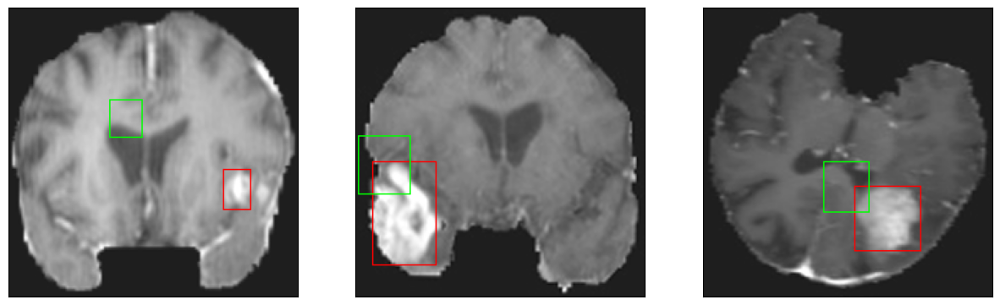

26/26 [==============================] - 3s 114ms/step - loss: 8.0087 - IoU: 0.4926 - val_loss: 21.7048 - val_IoU: 0.0830
Epoch 20/200
26/26 [==============================] - ETA: 0s - loss: 8.0188 - IoU: 0.4788
Epoch 20: val_IoU improved from 0.10779 to 0.19563, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4


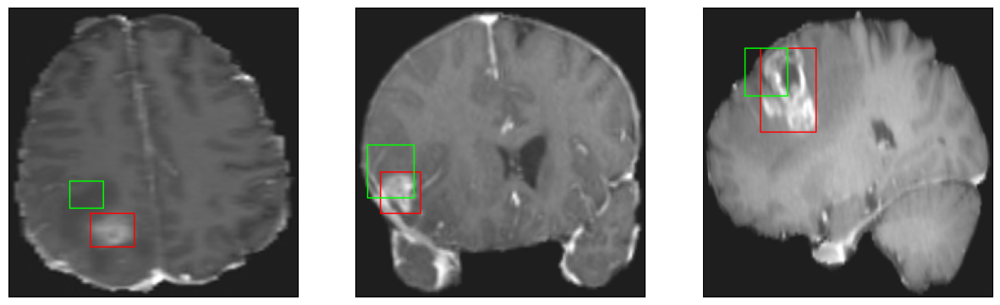

26/26 [==============================] - 4s 154ms/step - loss: 8.0188 - IoU: 0.4788 - val_loss: 15.7303 - val_IoU: 0.1956
Epoch 21/200
26/26 [==============================] - ETA: 0s - loss: 7.2063 - IoU: 0.5145
Epoch 21: val_IoU did not improve from 0.19563
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4


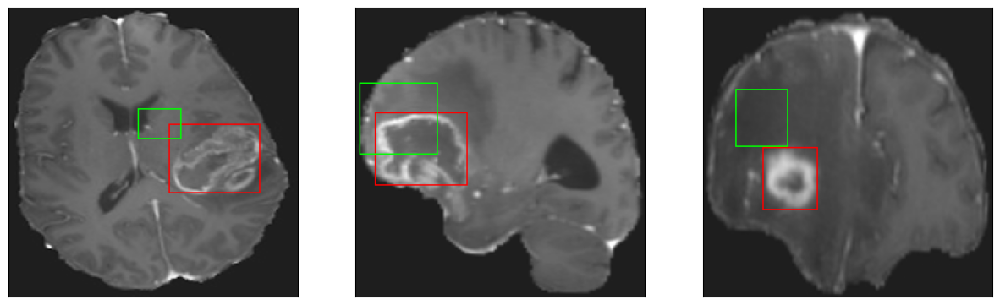

26/26 [==============================] - 3s 100ms/step - loss: 7.2063 - IoU: 0.5145 - val_loss: 21.8860 - val_IoU: 0.0751
Epoch 22/200
26/26 [==============================] - ETA: 0s - loss: 7.2685 - IoU: 0.5178
Epoch 22: val_IoU did not improve from 0.19563
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


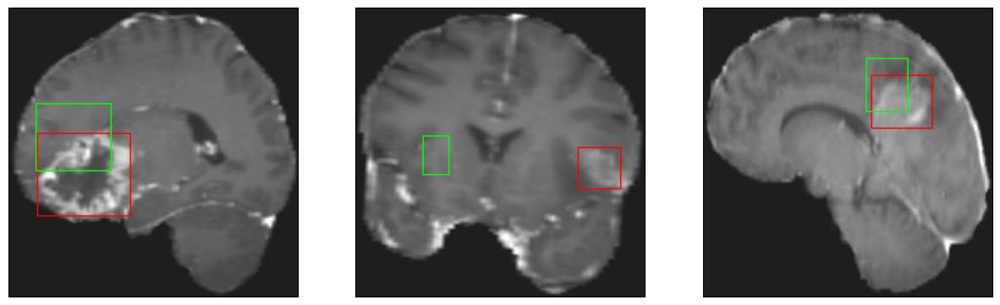

26/26 [==============================] - 3s 100ms/step - loss: 7.2685 - IoU: 0.5178 - val_loss: 14.8329 - val_IoU: 0.1945
Epoch 23/200
26/26 [==============================] - ETA: 0s - loss: 7.5269 - IoU: 0.5029
Epoch 23: val_IoU improved from 0.19563 to 0.33578, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4


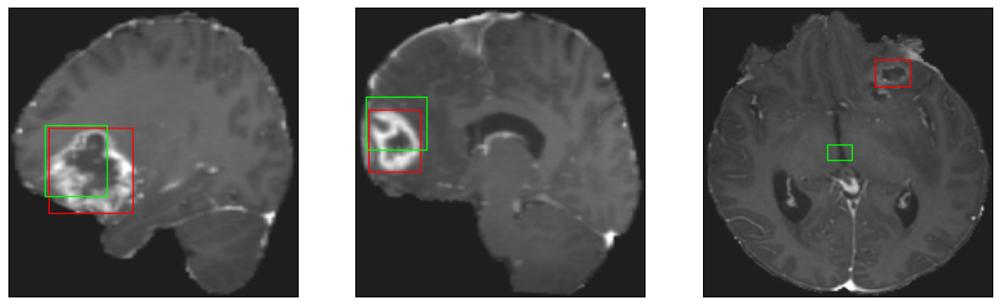

26/26 [==============================] - 3s 130ms/step - loss: 7.5269 - IoU: 0.5029 - val_loss: 11.5007 - val_IoU: 0.3358
Epoch 24/200
25/26 [===========================>..] - ETA: 0s - loss: 7.3708 - IoU: 0.5062
Epoch 24: val_IoU did not improve from 0.33578
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


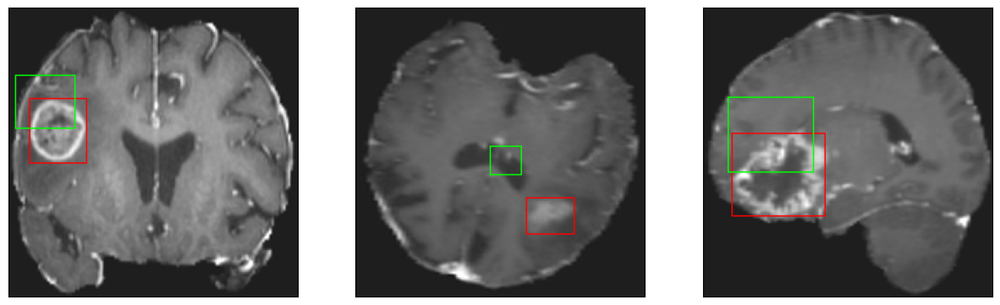

26/26 [==============================] - 3s 96ms/step - loss: 7.3392 - IoU: 0.5080 - val_loss: 17.6170 - val_IoU: 0.1332
Epoch 25/200
25/26 [===========================>..] - ETA: 0s - loss: 6.8769 - IoU: 0.5354
Epoch 25: val_IoU improved from 0.33578 to 0.53323, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


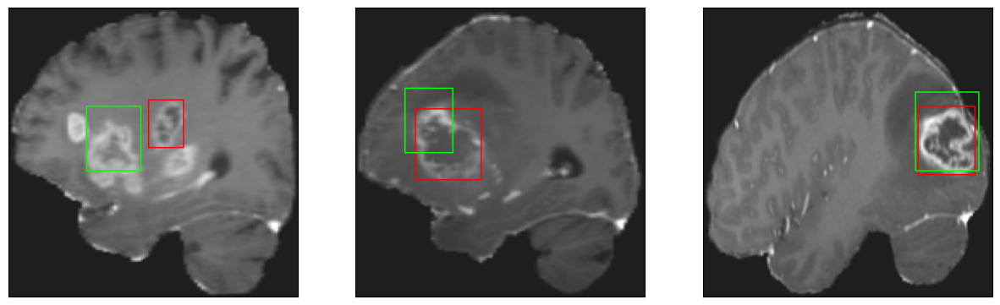

26/26 [==============================] - 3s 110ms/step - loss: 6.8942 - IoU: 0.5346 - val_loss: 8.2076 - val_IoU: 0.5332
Epoch 26/200
25/26 [===========================>..] - ETA: 0s - loss: 6.9138 - IoU: 0.5270
Epoch 26: val_IoU did not improve from 0.53323
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


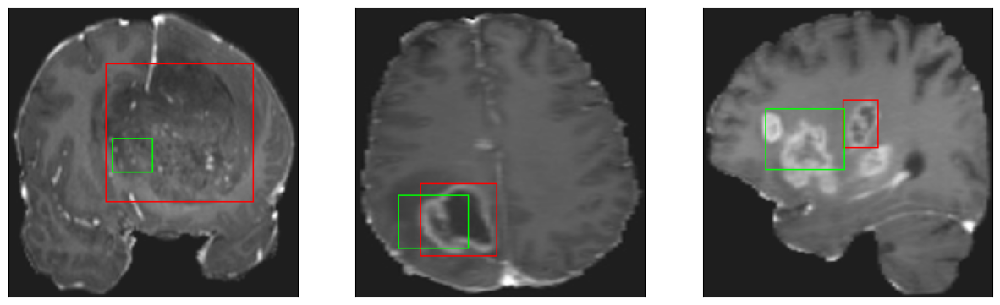

26/26 [==============================] - 3s 101ms/step - loss: 6.9480 - IoU: 0.5246 - val_loss: 9.9666 - val_IoU: 0.4319
Epoch 27/200
25/26 [===========================>..] - ETA: 0s - loss: 6.8774 - IoU: 0.5257
Epoch 27: val_IoU did not improve from 0.53323
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


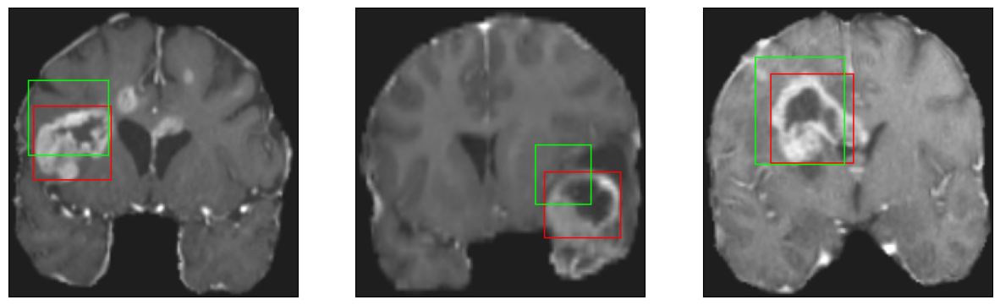

26/26 [==============================] - 3s 114ms/step - loss: 6.8349 - IoU: 0.5280 - val_loss: 10.9361 - val_IoU: 0.4070
Epoch 28/200
26/26 [==============================] - ETA: 0s - loss: 6.8191 - IoU: 0.5317
Epoch 28: val_IoU did not improve from 0.53323
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


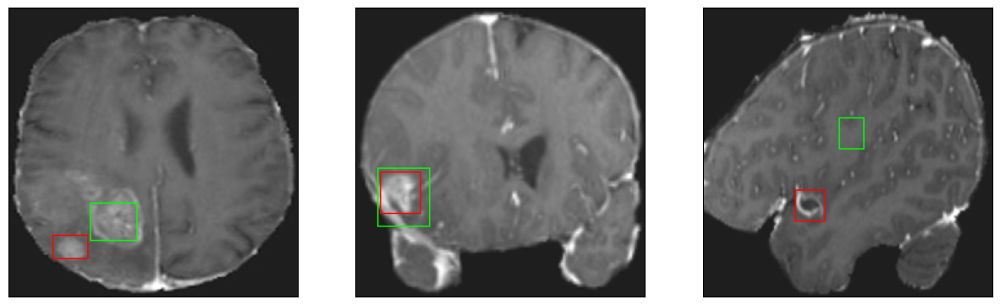

26/26 [==============================] - 3s 105ms/step - loss: 6.8191 - IoU: 0.5317 - val_loss: 8.6902 - val_IoU: 0.4699
Epoch 29/200
25/26 [===========================>..] - ETA: 0s - loss: 6.6788 - IoU: 0.5417
Epoch 29: val_IoU did not improve from 0.53323
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


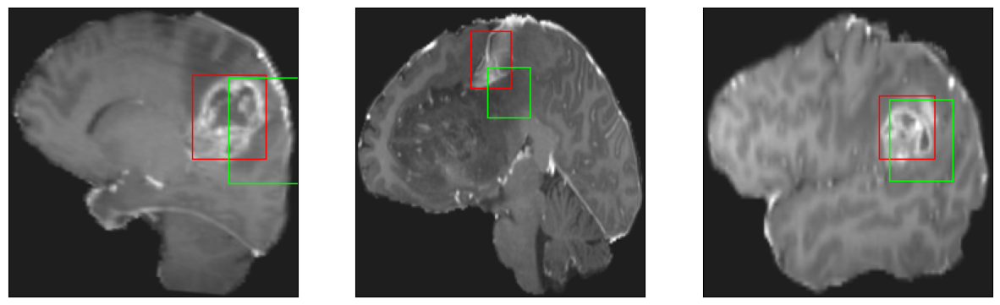

26/26 [==============================] - 3s 102ms/step - loss: 6.6092 - IoU: 0.5449 - val_loss: 13.2066 - val_IoU: 0.2648
Epoch 30/200
26/26 [==============================] - ETA: 0s - loss: 6.2122 - IoU: 0.5663
Epoch 30: val_IoU did not improve from 0.53323
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 10ms/step
4


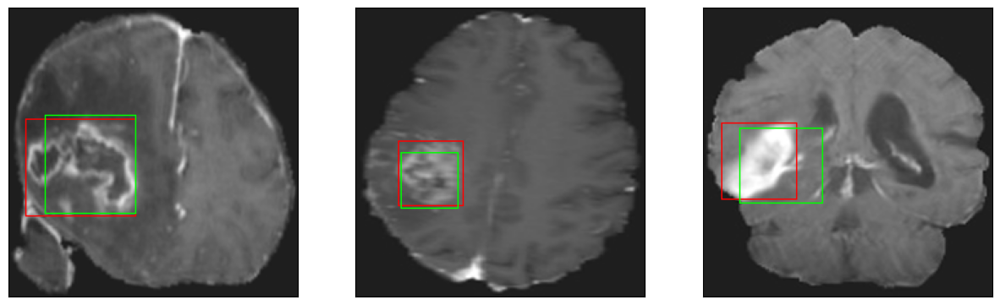

26/26 [==============================] - 3s 116ms/step - loss: 6.2122 - IoU: 0.5663 - val_loss: 9.6957 - val_IoU: 0.4279
Epoch 31/200
25/26 [===========================>..] - ETA: 0s - loss: 7.2277 - IoU: 0.5213
Epoch 31: val_IoU did not improve from 0.53323
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


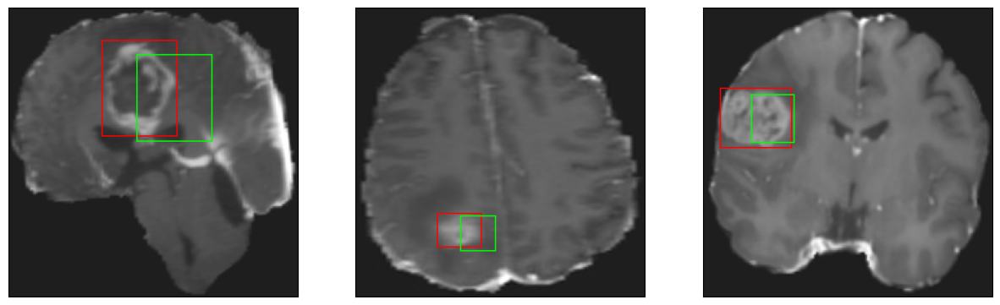

26/26 [==============================] - 3s 112ms/step - loss: 7.2289 - IoU: 0.5215 - val_loss: 9.4579 - val_IoU: 0.4405
Epoch 32/200
25/26 [===========================>..] - ETA: 0s - loss: 6.6995 - IoU: 0.5370
Epoch 32: val_IoU did not improve from 0.53323
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


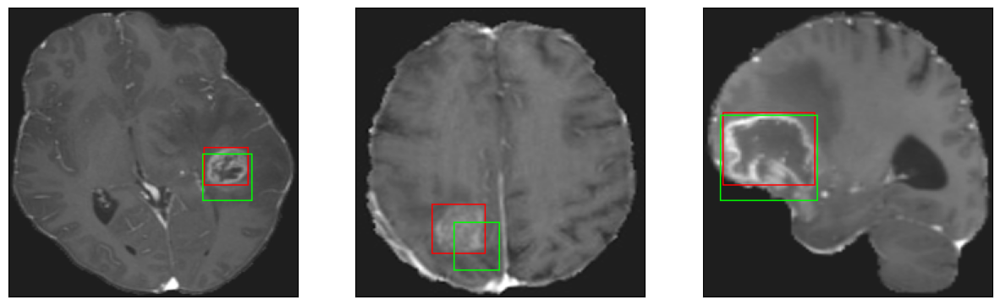

26/26 [==============================] - 3s 103ms/step - loss: 6.6490 - IoU: 0.5378 - val_loss: 9.0330 - val_IoU: 0.4936
Epoch 33/200
25/26 [===========================>..] - ETA: 0s - loss: 6.5986 - IoU: 0.5490
Epoch 33: val_IoU did not improve from 0.53323
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4


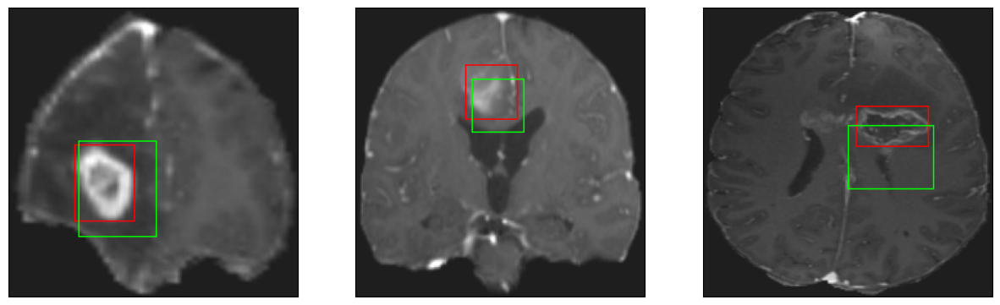

26/26 [==============================] - 3s 102ms/step - loss: 6.5772 - IoU: 0.5498 - val_loss: 12.1460 - val_IoU: 0.3088
Epoch 34/200
26/26 [==============================] - ETA: 0s - loss: 6.6038 - IoU: 0.5464
Epoch 34: val_IoU did not improve from 0.53323
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 10ms/step
4


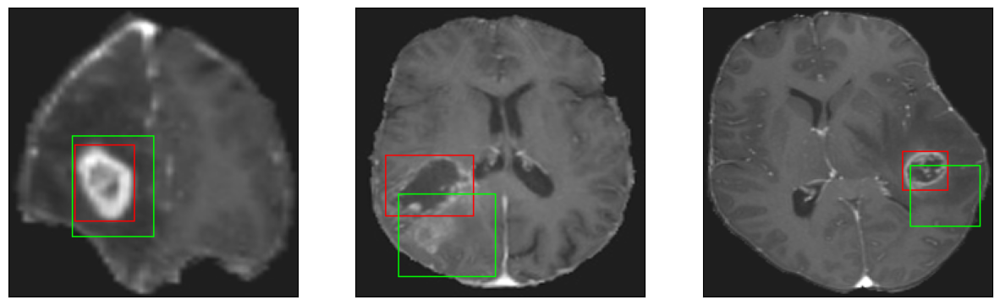

26/26 [==============================] - 3s 122ms/step - loss: 6.6038 - IoU: 0.5464 - val_loss: 16.0087 - val_IoU: 0.3160
Epoch 35/200
26/26 [==============================] - ETA: 0s - loss: 6.2903 - IoU: 0.5617
Epoch 35: val_IoU did not improve from 0.53323
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


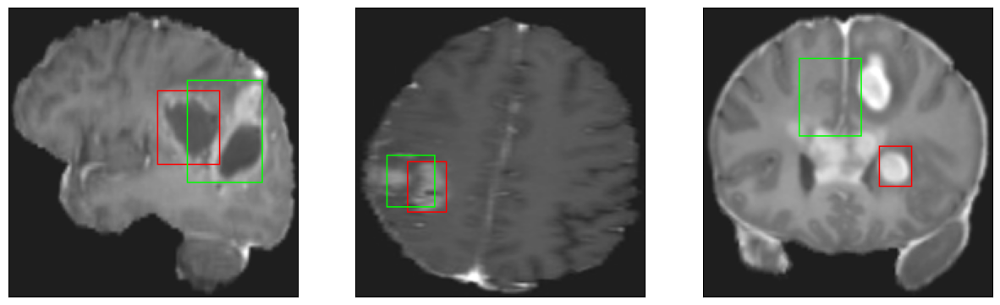

26/26 [==============================] - 3s 115ms/step - loss: 6.2903 - IoU: 0.5617 - val_loss: 8.9493 - val_IoU: 0.4599
Epoch 36/200
25/26 [===========================>..] - ETA: 0s - loss: 6.0110 - IoU: 0.5675
Epoch 36: val_IoU did not improve from 0.53323
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


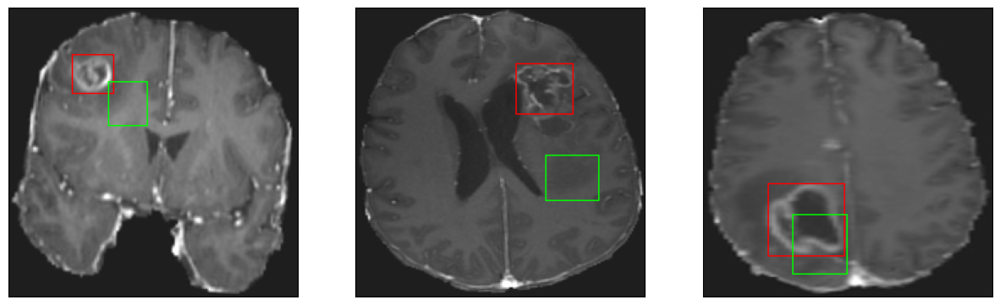

26/26 [==============================] - 3s 99ms/step - loss: 6.0233 - IoU: 0.5669 - val_loss: 15.2632 - val_IoU: 0.2208
Epoch 37/200
26/26 [==============================] - ETA: 0s - loss: 6.1647 - IoU: 0.5533
Epoch 37: val_IoU did not improve from 0.53323
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


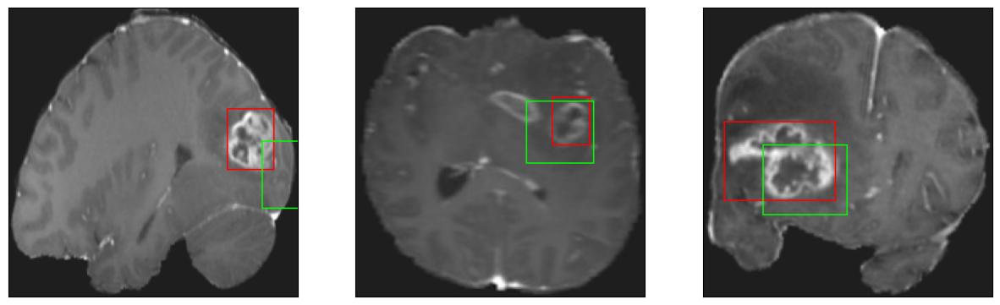

26/26 [==============================] - 3s 102ms/step - loss: 6.1647 - IoU: 0.5533 - val_loss: 13.2975 - val_IoU: 0.2477
Epoch 38/200
25/26 [===========================>..] - ETA: 0s - loss: 6.1516 - IoU: 0.5566
Epoch 38: val_IoU did not improve from 0.53323
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 10ms/step
4


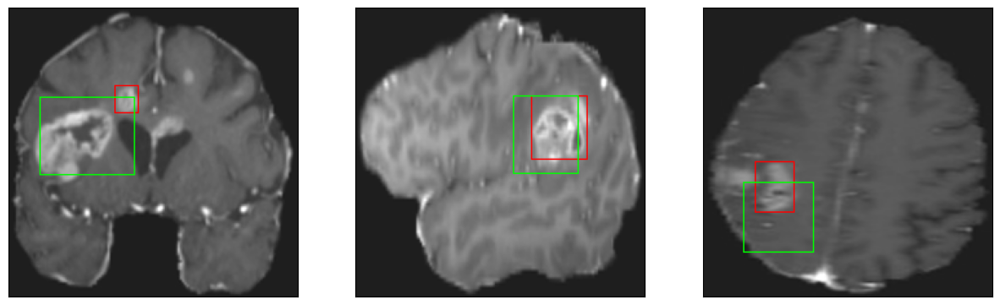

26/26 [==============================] - 3s 128ms/step - loss: 6.1617 - IoU: 0.5576 - val_loss: 12.9805 - val_IoU: 0.3781
Epoch 39/200
26/26 [==============================] - ETA: 0s - loss: 5.7881 - IoU: 0.5800
Epoch 39: val_IoU did not improve from 0.53323
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


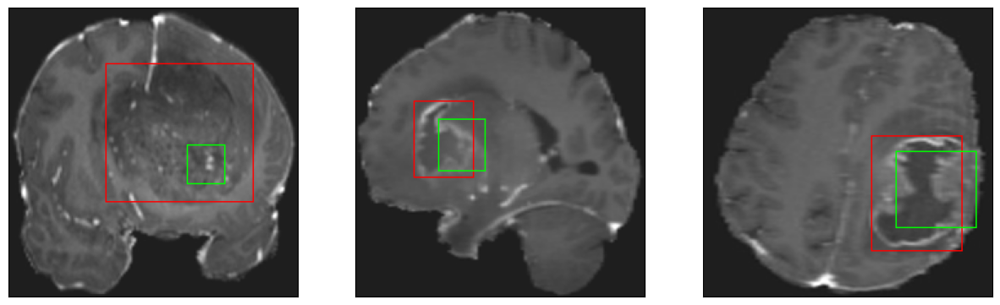

26/26 [==============================] - 3s 113ms/step - loss: 5.7881 - IoU: 0.5800 - val_loss: 11.1218 - val_IoU: 0.3812
Epoch 40/200
26/26 [==============================] - ETA: 0s - loss: 6.5233 - IoU: 0.5489
Epoch 40: val_IoU did not improve from 0.53323
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


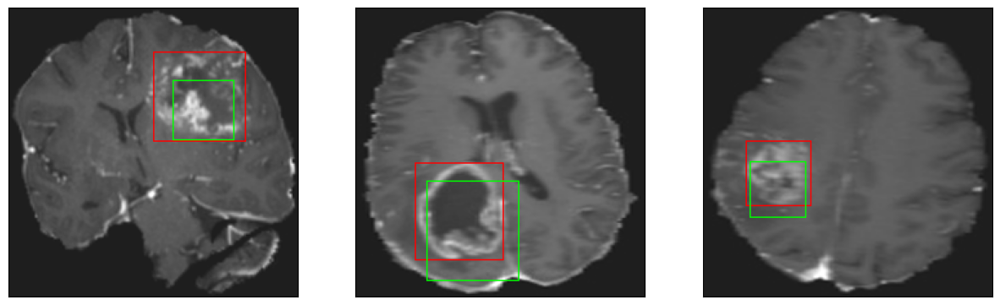

26/26 [==============================] - 3s 131ms/step - loss: 6.5233 - IoU: 0.5489 - val_loss: 9.2892 - val_IoU: 0.4187
Epoch 41/200
26/26 [==============================] - ETA: 0s - loss: 6.2740 - IoU: 0.5572
Epoch 41: val_IoU did not improve from 0.53323
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


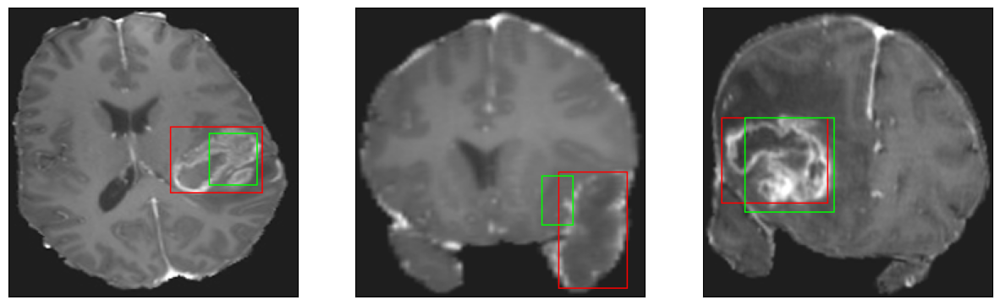

26/26 [==============================] - 3s 109ms/step - loss: 6.2740 - IoU: 0.5572 - val_loss: 8.5963 - val_IoU: 0.4876
Epoch 42/200
26/26 [==============================] - ETA: 0s - loss: 6.2162 - IoU: 0.5556
Epoch 42: val_IoU did not improve from 0.53323
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 10ms/step
4


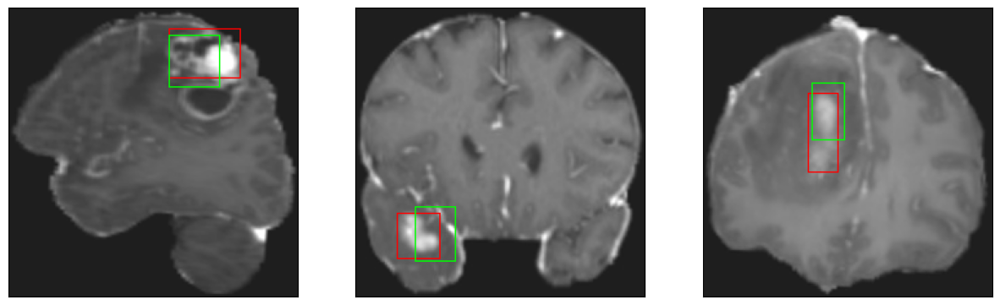

26/26 [==============================] - 3s 130ms/step - loss: 6.2162 - IoU: 0.5556 - val_loss: 8.9233 - val_IoU: 0.4804
Epoch 43/200
25/26 [===========================>..] - ETA: 0s - loss: 5.7528 - IoU: 0.5800
Epoch 43: val_IoU did not improve from 0.53323
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4


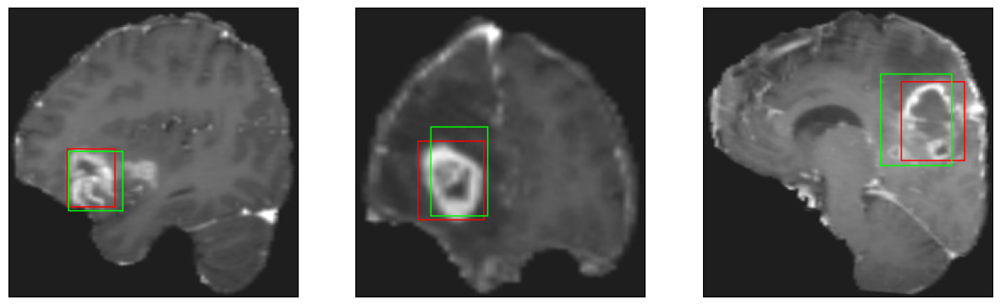

26/26 [==============================] - 3s 108ms/step - loss: 5.7992 - IoU: 0.5786 - val_loss: 9.4025 - val_IoU: 0.4113
Epoch 44/200
25/26 [===========================>..] - ETA: 0s - loss: 5.8729 - IoU: 0.5789
Epoch 44: val_IoU did not improve from 0.53323
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


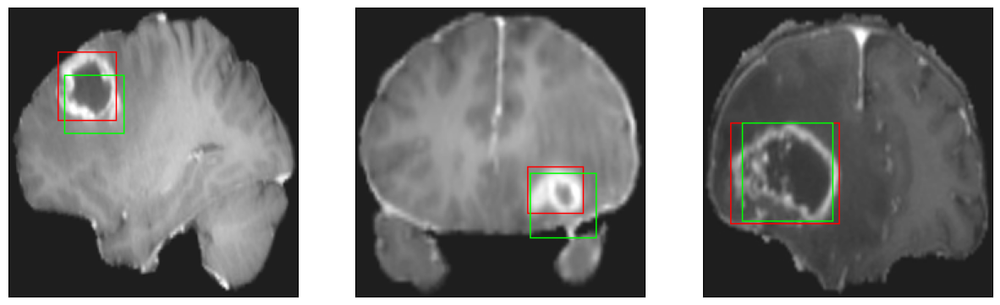

26/26 [==============================] - 3s 98ms/step - loss: 5.8206 - IoU: 0.5813 - val_loss: 8.4076 - val_IoU: 0.4701
Epoch 45/200
25/26 [===========================>..] - ETA: 0s - loss: 5.9910 - IoU: 0.5682
Epoch 45: val_IoU did not improve from 0.53323
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 9ms/step
4


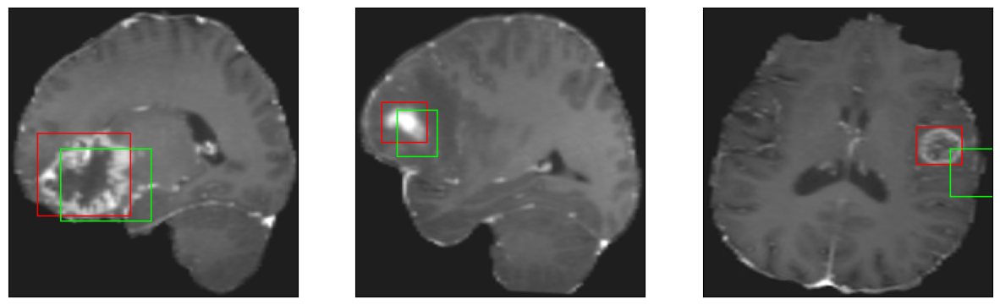

26/26 [==============================] - 3s 110ms/step - loss: 6.0459 - IoU: 0.5667 - val_loss: 13.0441 - val_IoU: 0.2536
Epoch 46/200
25/26 [===========================>..] - ETA: 0s - loss: 5.9259 - IoU: 0.5779
Epoch 46: val_IoU did not improve from 0.53323
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


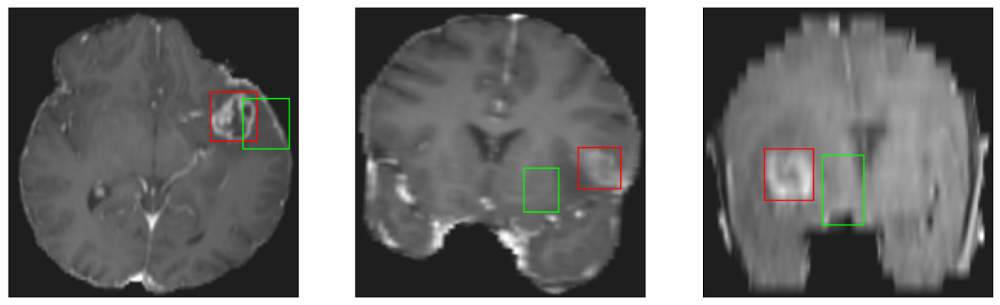

26/26 [==============================] - 3s 105ms/step - loss: 5.9143 - IoU: 0.5770 - val_loss: 13.0080 - val_IoU: 0.2921
Epoch 47/200
25/26 [===========================>..] - ETA: 0s - loss: 6.1080 - IoU: 0.5568
Epoch 47: val_IoU did not improve from 0.53323
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


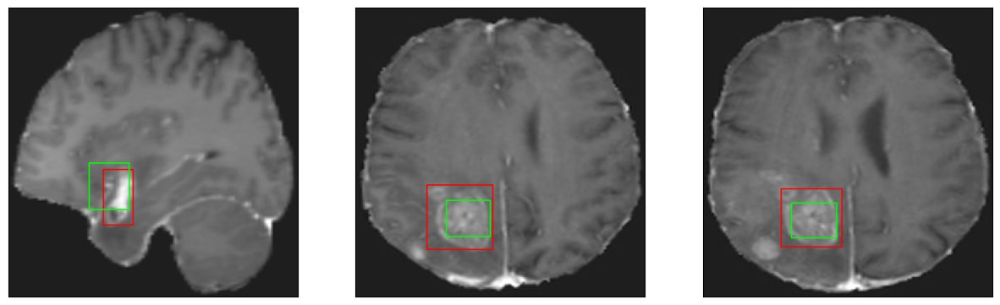

26/26 [==============================] - 3s 105ms/step - loss: 6.1209 - IoU: 0.5550 - val_loss: 8.6784 - val_IoU: 0.4909
Epoch 48/200
26/26 [==============================] - ETA: 0s - loss: 5.6502 - IoU: 0.5955
Epoch 48: val_IoU did not improve from 0.53323
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


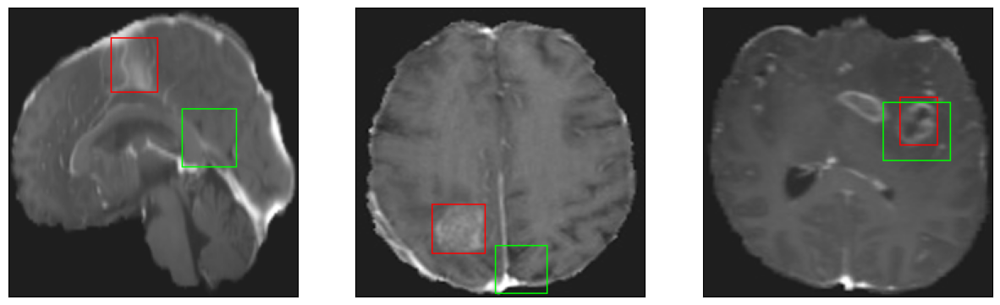

26/26 [==============================] - 3s 109ms/step - loss: 5.6502 - IoU: 0.5955 - val_loss: 16.3761 - val_IoU: 0.2057
Epoch 49/200
25/26 [===========================>..] - ETA: 0s - loss: 5.6570 - IoU: 0.5806
Epoch 49: val_IoU did not improve from 0.53323
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


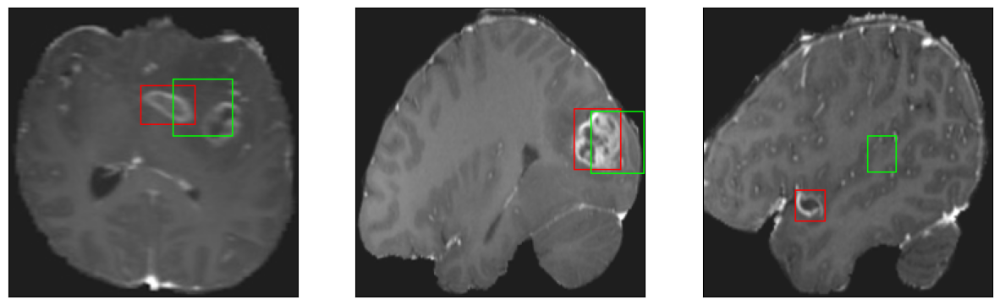

26/26 [==============================] - 3s 111ms/step - loss: 5.6472 - IoU: 0.5826 - val_loss: 10.6402 - val_IoU: 0.3475
Epoch 50/200
26/26 [==============================] - ETA: 0s - loss: 5.4491 - IoU: 0.5982
Epoch 50: val_IoU did not improve from 0.53323
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 8ms/step
4


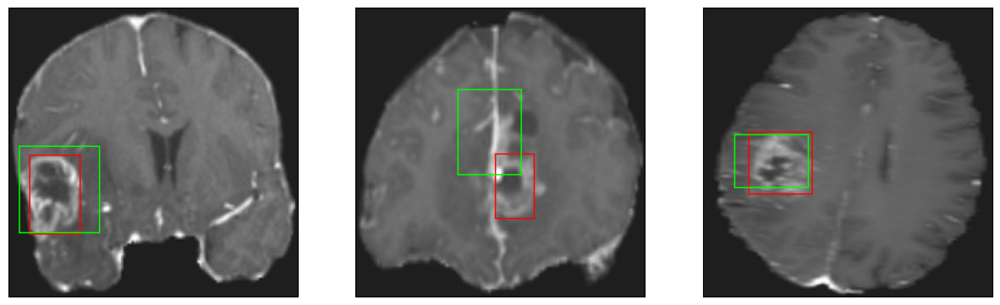

26/26 [==============================] - 3s 131ms/step - loss: 5.4491 - IoU: 0.5982 - val_loss: 10.1156 - val_IoU: 0.4612
Epoch 51/200
26/26 [==============================] - ETA: 0s - loss: 5.7522 - IoU: 0.5782
Epoch 51: val_IoU did not improve from 0.53323
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4


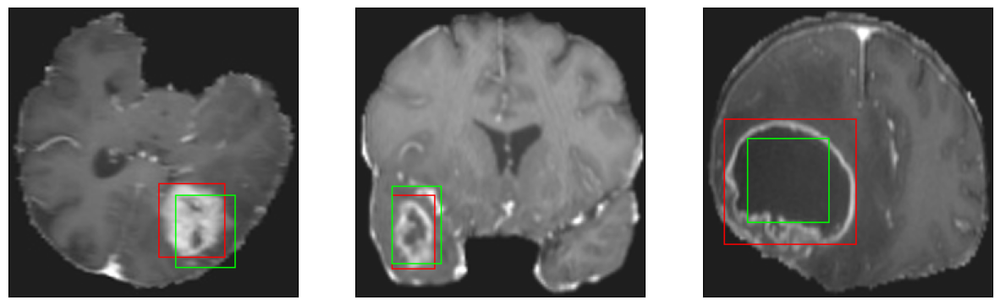

26/26 [==============================] - 3s 105ms/step - loss: 5.7522 - IoU: 0.5782 - val_loss: 7.7462 - val_IoU: 0.5259
Epoch 52/200
25/26 [===========================>..] - ETA: 0s - loss: 5.8081 - IoU: 0.5858
Epoch 52: val_IoU did not improve from 0.53323
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


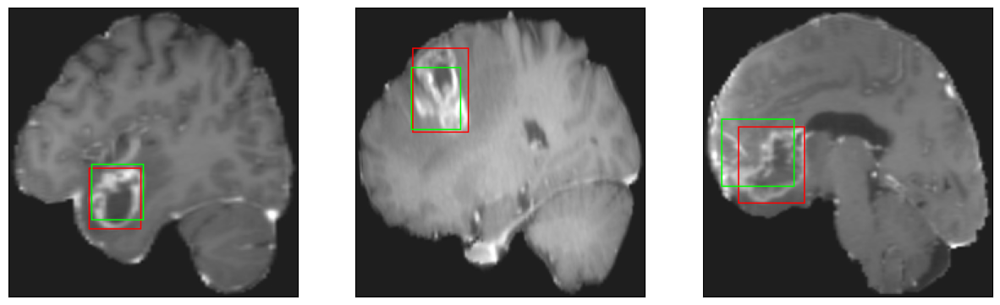

26/26 [==============================] - 3s 106ms/step - loss: 5.7471 - IoU: 0.5874 - val_loss: 8.0428 - val_IoU: 0.5027
Epoch 53/200
25/26 [===========================>..] - ETA: 0s - loss: 5.6748 - IoU: 0.5823
Epoch 53: val_IoU did not improve from 0.53323
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4


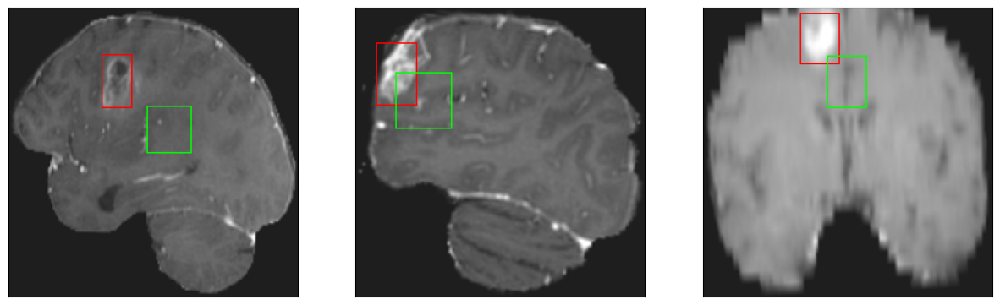

26/26 [==============================] - 3s 104ms/step - loss: 5.6639 - IoU: 0.5820 - val_loss: 13.3164 - val_IoU: 0.2962
Epoch 54/200
25/26 [===========================>..] - ETA: 0s - loss: 5.5038 - IoU: 0.5896
Epoch 54: val_IoU did not improve from 0.53323
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


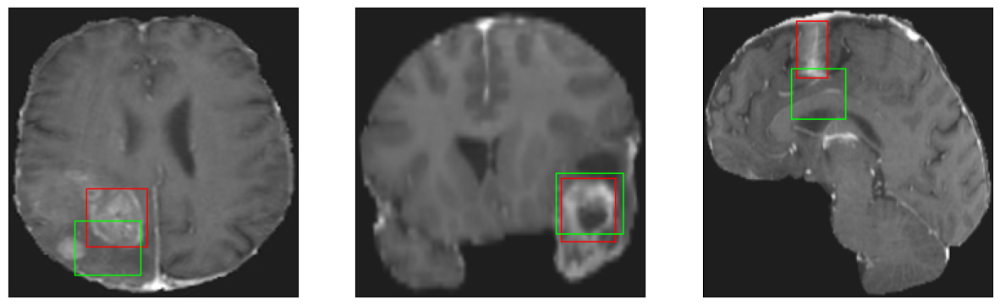

26/26 [==============================] - 3s 107ms/step - loss: 5.5152 - IoU: 0.5906 - val_loss: 9.8490 - val_IoU: 0.4630
Epoch 55/200
25/26 [===========================>..] - ETA: 0s - loss: 5.3483 - IoU: 0.6017
Epoch 55: val_IoU did not improve from 0.53323
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


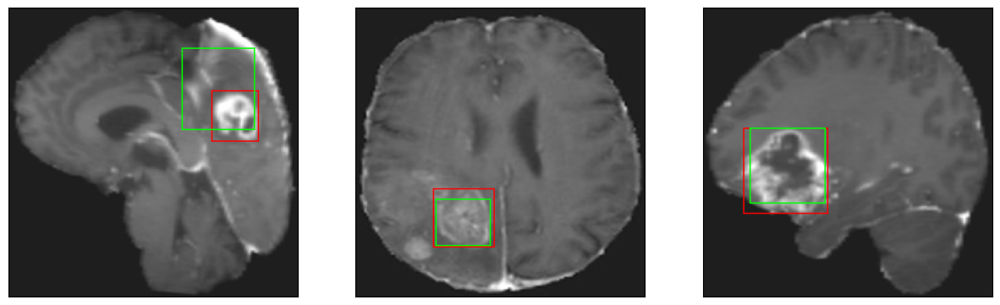

26/26 [==============================] - 3s 105ms/step - loss: 5.3434 - IoU: 0.6016 - val_loss: 8.3971 - val_IoU: 0.4879
Epoch 56/200
26/26 [==============================] - ETA: 0s - loss: 5.3070 - IoU: 0.6025
Epoch 56: val_IoU did not improve from 0.53323
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


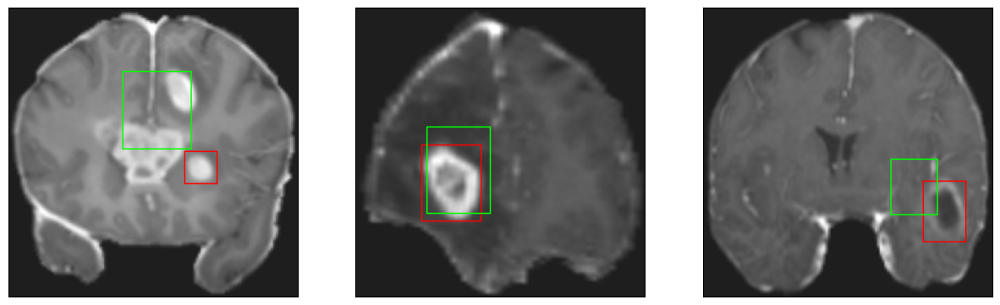

26/26 [==============================] - 3s 120ms/step - loss: 5.3070 - IoU: 0.6025 - val_loss: 8.1694 - val_IoU: 0.4954
Epoch 57/200
26/26 [==============================] - ETA: 0s - loss: 5.5403 - IoU: 0.5886
Epoch 57: val_IoU did not improve from 0.53323
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4


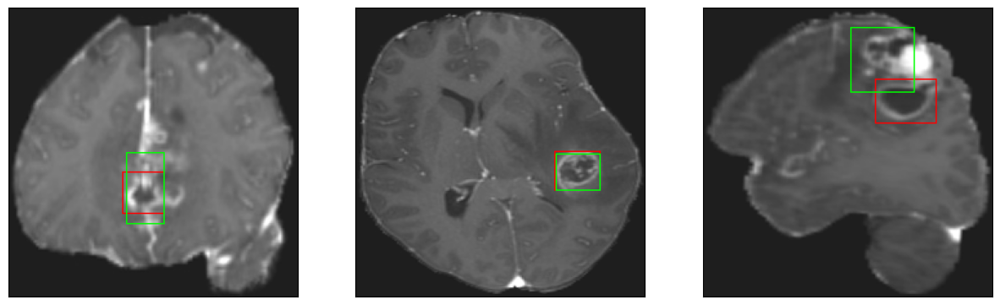

26/26 [==============================] - 3s 119ms/step - loss: 5.5403 - IoU: 0.5886 - val_loss: 8.5086 - val_IoU: 0.5193
Epoch 58/200
26/26 [==============================] - ETA: 0s - loss: 5.5644 - IoU: 0.5816
Epoch 58: val_IoU did not improve from 0.53323
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 8ms/step
4


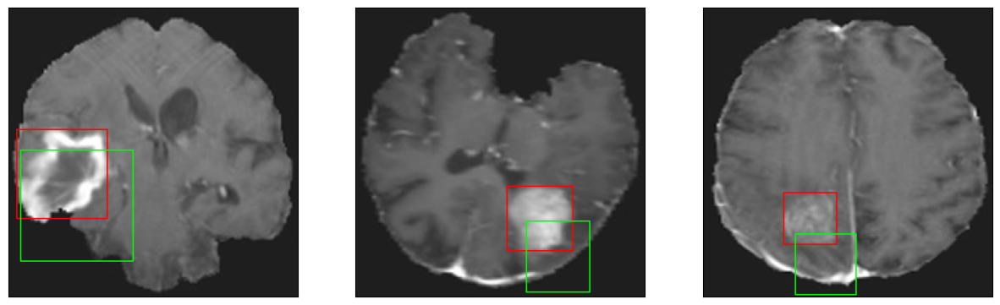

26/26 [==============================] - 3s 118ms/step - loss: 5.5644 - IoU: 0.5816 - val_loss: 13.7912 - val_IoU: 0.3182
Epoch 59/200
26/26 [==============================] - ETA: 0s - loss: 5.3581 - IoU: 0.5973
Epoch 59: val_IoU did not improve from 0.53323
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


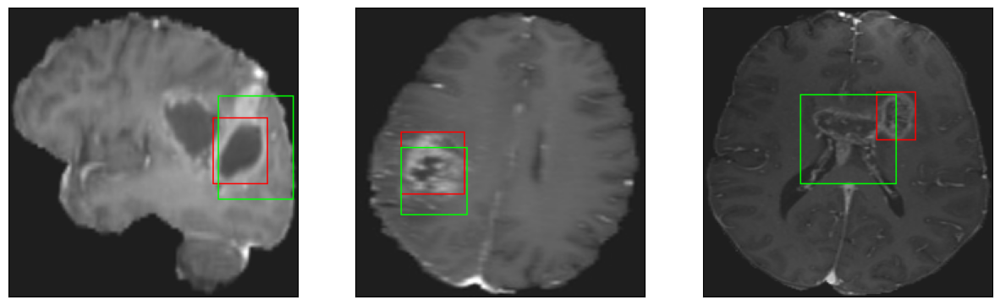

26/26 [==============================] - 3s 127ms/step - loss: 5.3581 - IoU: 0.5973 - val_loss: 11.1171 - val_IoU: 0.3737
Epoch 60/200
25/26 [===========================>..] - ETA: 0s - loss: 5.1885 - IoU: 0.6114
Epoch 60: val_IoU did not improve from 0.53323
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


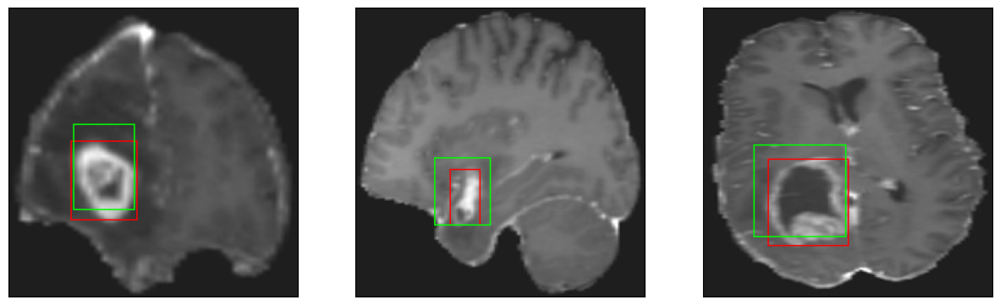

26/26 [==============================] - 3s 115ms/step - loss: 5.2459 - IoU: 0.6085 - val_loss: 10.4936 - val_IoU: 0.4327
Epoch 61/200
26/26 [==============================] - ETA: 0s - loss: 5.8072 - IoU: 0.5740
Epoch 61: val_IoU did not improve from 0.53323
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 10ms/step
4


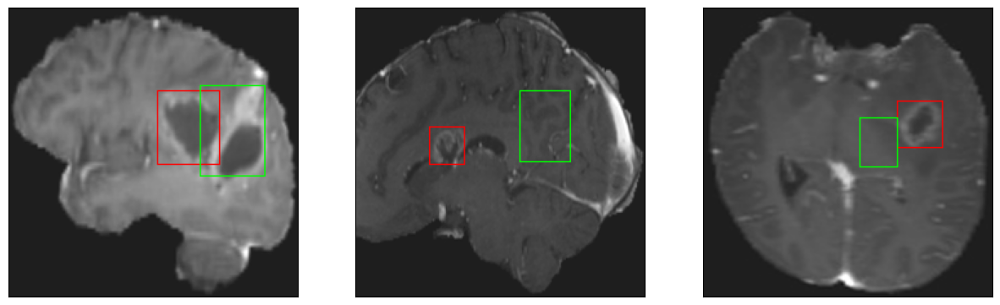

26/26 [==============================] - 3s 123ms/step - loss: 5.8072 - IoU: 0.5740 - val_loss: 8.1553 - val_IoU: 0.5258
Epoch 62/200
26/26 [==============================] - ETA: 0s - loss: 5.3335 - IoU: 0.6056
Epoch 62: val_IoU did not improve from 0.53323
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


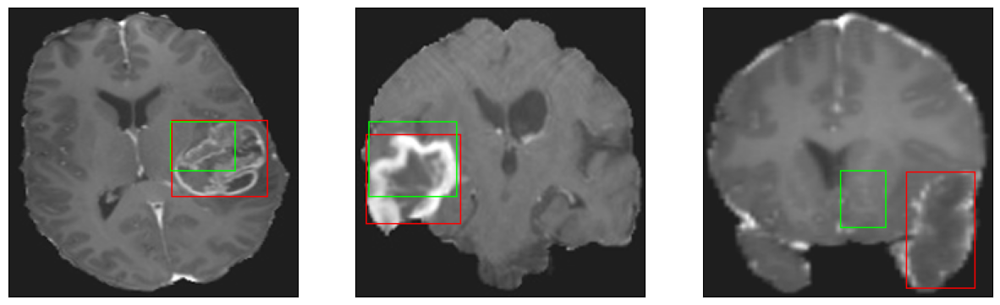

26/26 [==============================] - 3s 103ms/step - loss: 5.3335 - IoU: 0.6056 - val_loss: 8.3940 - val_IoU: 0.4925
Epoch 63/200
26/26 [==============================] - ETA: 0s - loss: 5.3700 - IoU: 0.6009
Epoch 63: val_IoU did not improve from 0.53323
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4


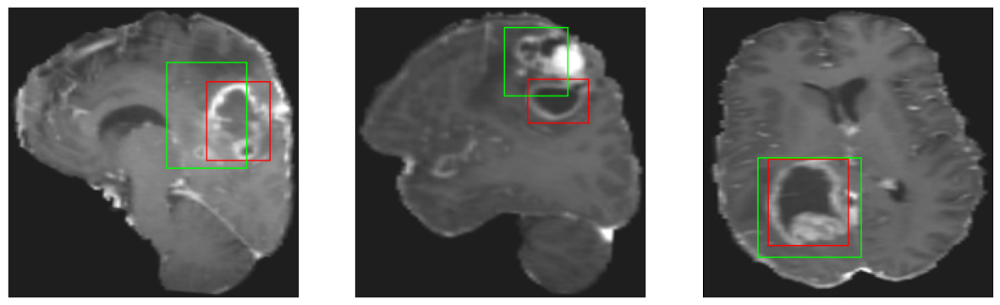

26/26 [==============================] - 3s 117ms/step - loss: 5.3700 - IoU: 0.6009 - val_loss: 10.4372 - val_IoU: 0.4683
Epoch 64/200
25/26 [===========================>..] - ETA: 0s - loss: 5.9662 - IoU: 0.5656
Epoch 64: val_IoU did not improve from 0.53323
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 12ms/step
4


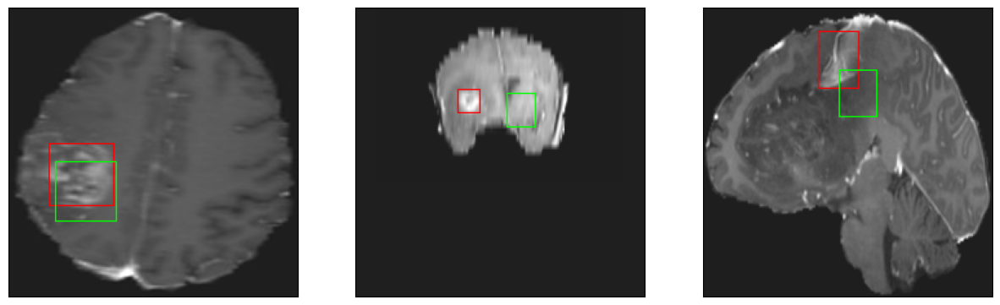

26/26 [==============================] - 3s 112ms/step - loss: 5.9404 - IoU: 0.5665 - val_loss: 10.3215 - val_IoU: 0.3907
Epoch 65/200
25/26 [===========================>..] - ETA: 0s - loss: 5.1254 - IoU: 0.6101
Epoch 65: val_IoU did not improve from 0.53323
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


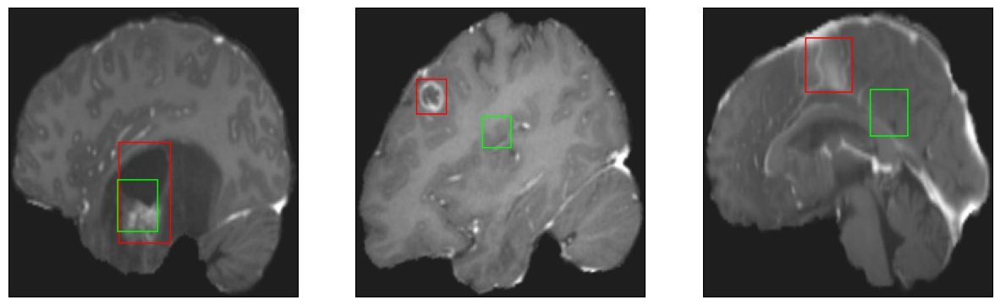

26/26 [==============================] - 3s 107ms/step - loss: 5.1217 - IoU: 0.6116 - val_loss: 8.1825 - val_IoU: 0.5133
Epoch 66/200
25/26 [===========================>..] - ETA: 0s - loss: 5.5046 - IoU: 0.5948
Epoch 66: val_IoU improved from 0.53323 to 0.53418, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


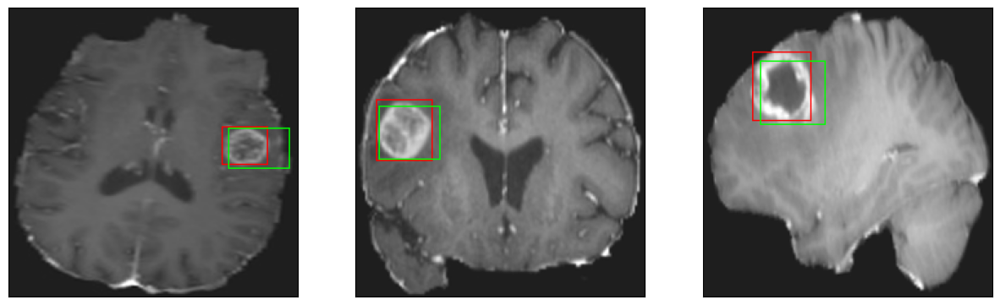

26/26 [==============================] - 3s 135ms/step - loss: 5.5004 - IoU: 0.5956 - val_loss: 7.8252 - val_IoU: 0.5342
Epoch 67/200
25/26 [===========================>..] - ETA: 0s - loss: 5.3509 - IoU: 0.6070
Epoch 67: val_IoU improved from 0.53418 to 0.53441, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


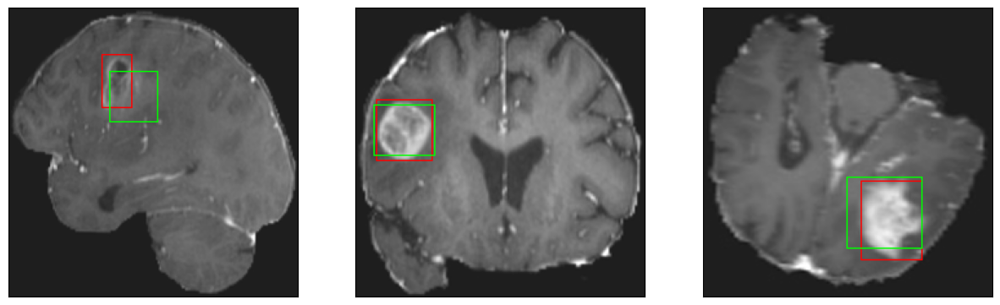

26/26 [==============================] - 3s 115ms/step - loss: 5.3885 - IoU: 0.6055 - val_loss: 8.1256 - val_IoU: 0.5344
Epoch 68/200
25/26 [===========================>..] - ETA: 0s - loss: 5.3294 - IoU: 0.5931
Epoch 68: val_IoU did not improve from 0.53441
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 10ms/step
4


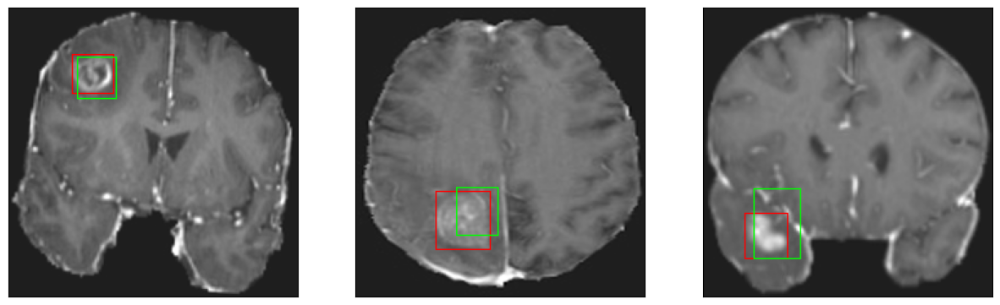

26/26 [==============================] - 3s 121ms/step - loss: 5.3245 - IoU: 0.5945 - val_loss: 8.5521 - val_IoU: 0.4969
Epoch 69/200
25/26 [===========================>..] - ETA: 0s - loss: 5.4860 - IoU: 0.6067
Epoch 69: val_IoU did not improve from 0.53441
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


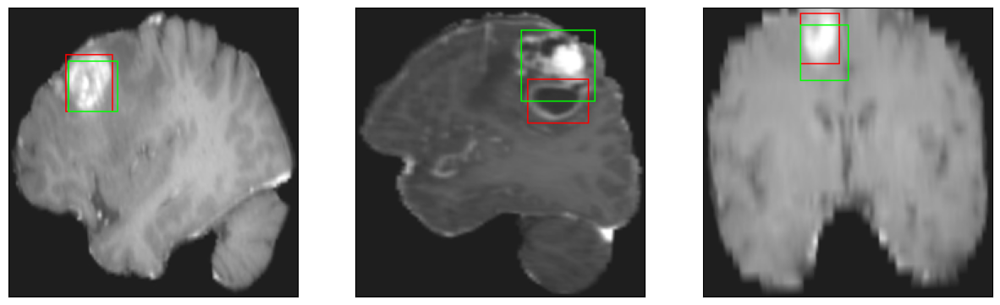

26/26 [==============================] - 3s 122ms/step - loss: 5.5227 - IoU: 0.6050 - val_loss: 12.0961 - val_IoU: 0.3696
Epoch 70/200
25/26 [===========================>..] - ETA: 0s - loss: 5.2649 - IoU: 0.6081
Epoch 70: val_IoU did not improve from 0.53441
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


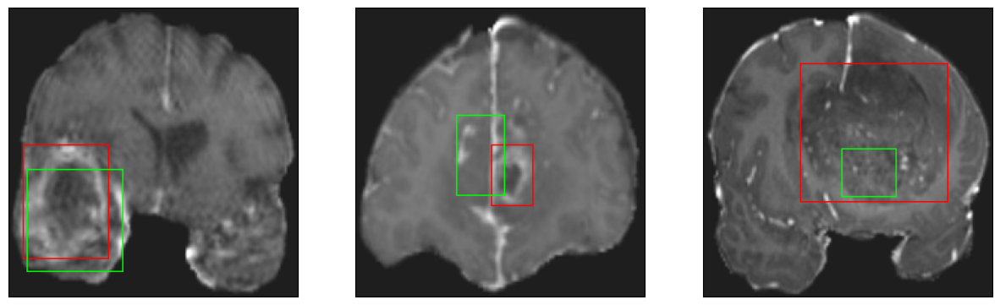

26/26 [==============================] - 3s 107ms/step - loss: 5.2531 - IoU: 0.6091 - val_loss: 8.4931 - val_IoU: 0.5198
Epoch 71/200
25/26 [===========================>..] - ETA: 0s - loss: 5.2959 - IoU: 0.6089
Epoch 71: val_IoU did not improve from 0.53441
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 10ms/step
4


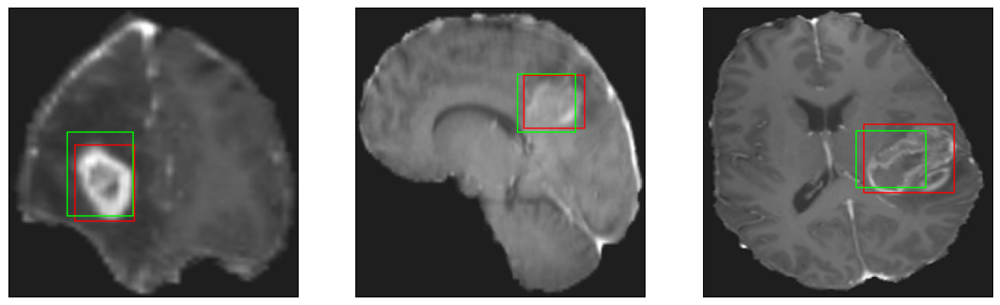

26/26 [==============================] - 3s 104ms/step - loss: 5.2894 - IoU: 0.6089 - val_loss: 10.7821 - val_IoU: 0.4357
Epoch 72/200
26/26 [==============================] - ETA: 0s - loss: 5.5240 - IoU: 0.5927
Epoch 72: val_IoU did not improve from 0.53441
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 9ms/step
4


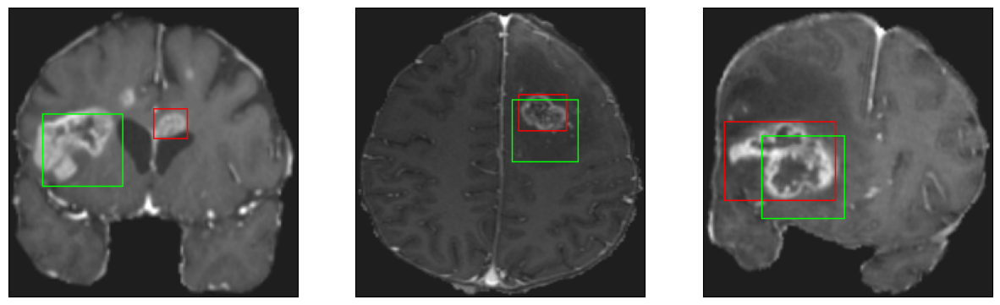

26/26 [==============================] - 3s 121ms/step - loss: 5.5240 - IoU: 0.5927 - val_loss: 11.0003 - val_IoU: 0.3787
Epoch 73/200
26/26 [==============================] - ETA: 0s - loss: 4.9137 - IoU: 0.6269
Epoch 73: val_IoU did not improve from 0.53441
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4


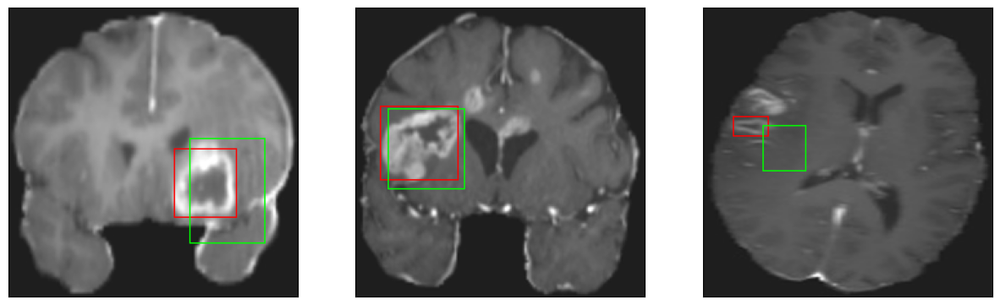

26/26 [==============================] - 3s 128ms/step - loss: 4.9137 - IoU: 0.6269 - val_loss: 11.8963 - val_IoU: 0.3296
Epoch 74/200
25/26 [===========================>..] - ETA: 0s - loss: 5.0273 - IoU: 0.6239
Epoch 74: val_IoU did not improve from 0.53441
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


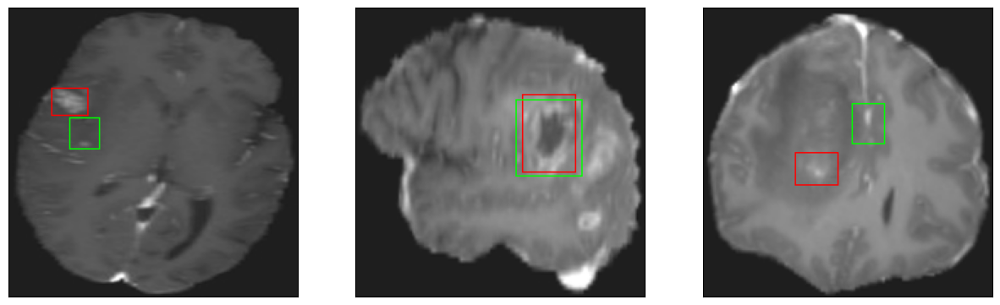

26/26 [==============================] - 3s 104ms/step - loss: 5.0232 - IoU: 0.6244 - val_loss: 8.1630 - val_IoU: 0.5154
Epoch 75/200
25/26 [===========================>..] - ETA: 0s - loss: 5.0088 - IoU: 0.6196
Epoch 75: val_IoU improved from 0.53441 to 0.55021, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


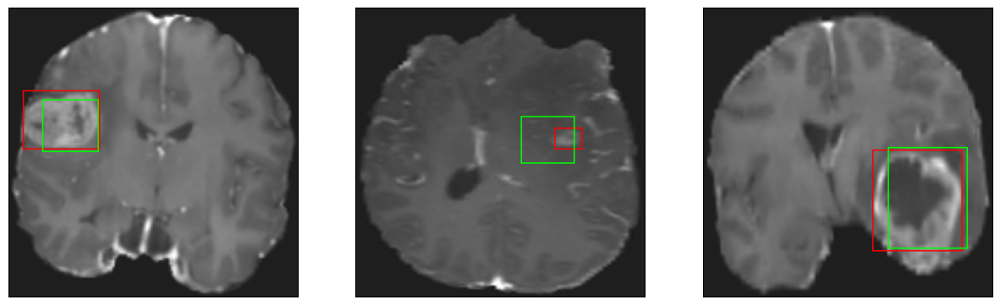

26/26 [==============================] - 3s 133ms/step - loss: 5.0144 - IoU: 0.6188 - val_loss: 7.7455 - val_IoU: 0.5502
Epoch 76/200
25/26 [===========================>..] - ETA: 0s - loss: 5.0280 - IoU: 0.6220
Epoch 76: val_IoU did not improve from 0.55021
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


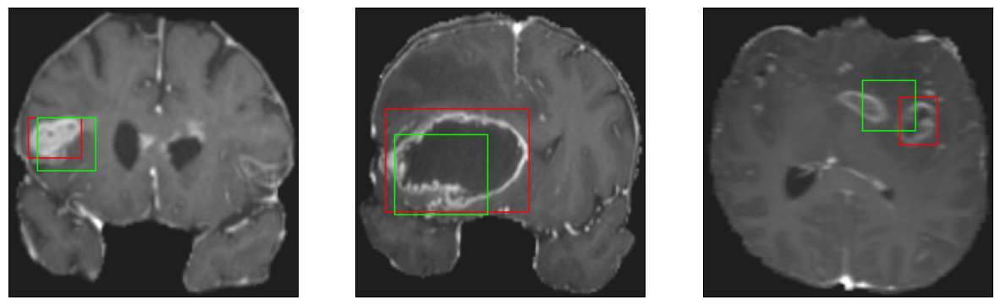

26/26 [==============================] - 3s 107ms/step - loss: 5.0253 - IoU: 0.6214 - val_loss: 8.3079 - val_IoU: 0.4851
Epoch 77/200
25/26 [===========================>..] - ETA: 0s - loss: 4.8096 - IoU: 0.6330
Epoch 77: val_IoU did not improve from 0.55021
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4


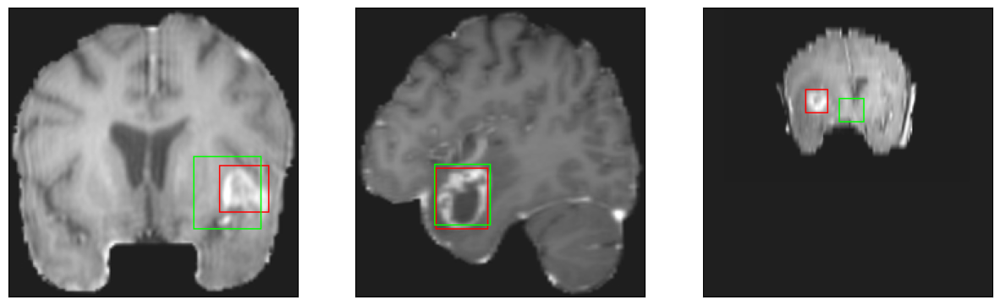

26/26 [==============================] - 3s 115ms/step - loss: 4.8048 - IoU: 0.6341 - val_loss: 7.6788 - val_IoU: 0.5205
Epoch 78/200
25/26 [===========================>..] - ETA: 0s - loss: 4.8541 - IoU: 0.6264
Epoch 78: val_IoU did not improve from 0.55021
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


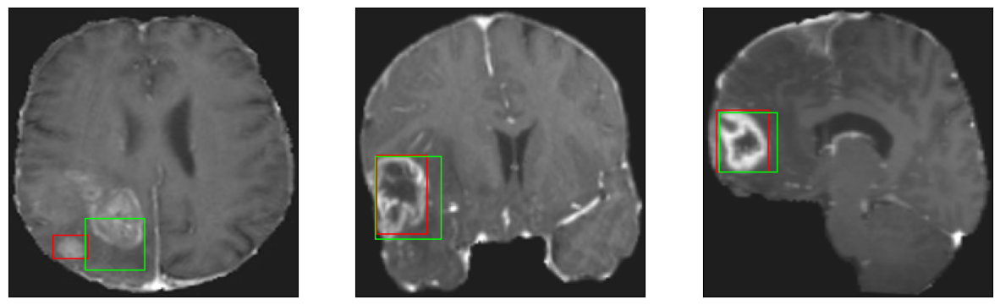

26/26 [==============================] - 3s 105ms/step - loss: 4.8120 - IoU: 0.6281 - val_loss: 8.6527 - val_IoU: 0.4671
Epoch 79/200
25/26 [===========================>..] - ETA: 0s - loss: 4.8189 - IoU: 0.6333
Epoch 79: val_IoU did not improve from 0.55021
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 8ms/step
4


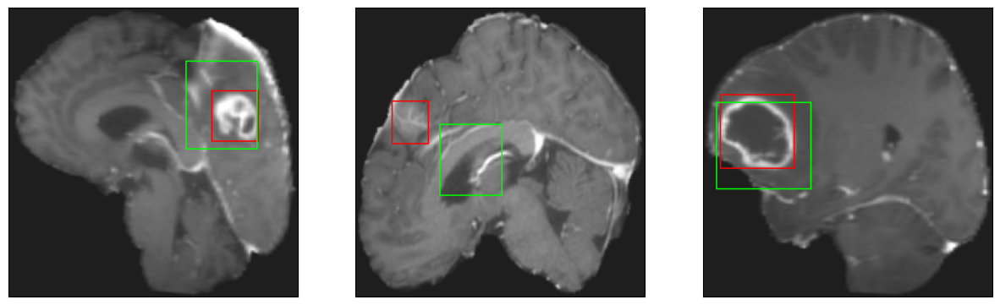

26/26 [==============================] - 3s 122ms/step - loss: 4.8696 - IoU: 0.6311 - val_loss: 10.4352 - val_IoU: 0.4219
Epoch 80/200
25/26 [===========================>..] - ETA: 0s - loss: 5.0335 - IoU: 0.6219
Epoch 80: val_IoU improved from 0.55021 to 0.56387, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


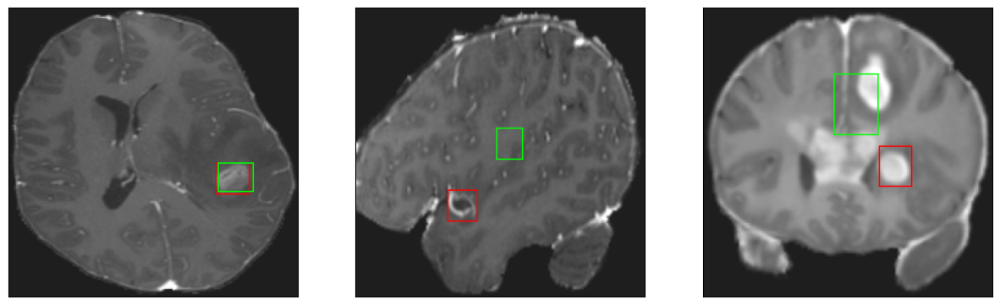

26/26 [==============================] - 4s 149ms/step - loss: 5.0100 - IoU: 0.6214 - val_loss: 7.4127 - val_IoU: 0.5639
Epoch 81/200
26/26 [==============================] - ETA: 0s - loss: 5.1062 - IoU: 0.6156
Epoch 81: val_IoU did not improve from 0.56387
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4


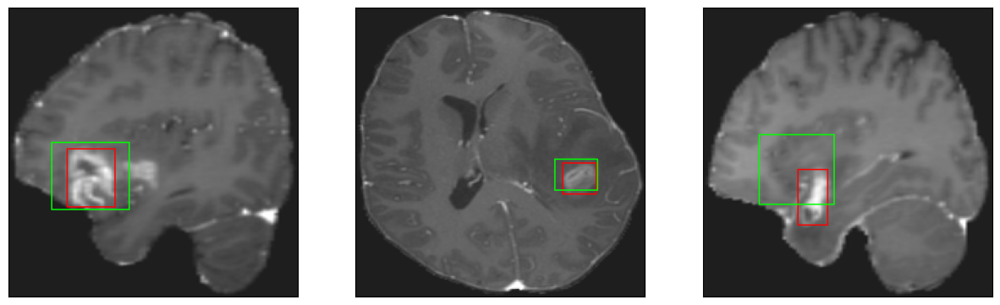

26/26 [==============================] - 3s 103ms/step - loss: 5.1062 - IoU: 0.6156 - val_loss: 10.6443 - val_IoU: 0.4446
Epoch 82/200
26/26 [==============================] - ETA: 0s - loss: 5.2698 - IoU: 0.6058
Epoch 82: val_IoU did not improve from 0.56387
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4


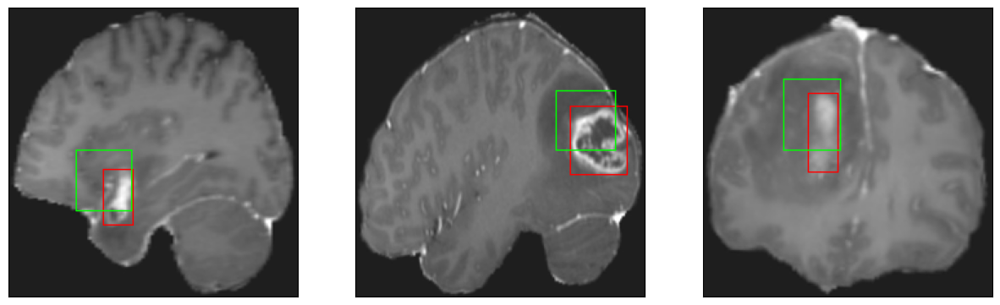

26/26 [==============================] - 3s 126ms/step - loss: 5.2698 - IoU: 0.6058 - val_loss: 8.3062 - val_IoU: 0.5157
Epoch 83/200
25/26 [===========================>..] - ETA: 0s - loss: 5.2607 - IoU: 0.6170
Epoch 83: val_IoU did not improve from 0.56387
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4


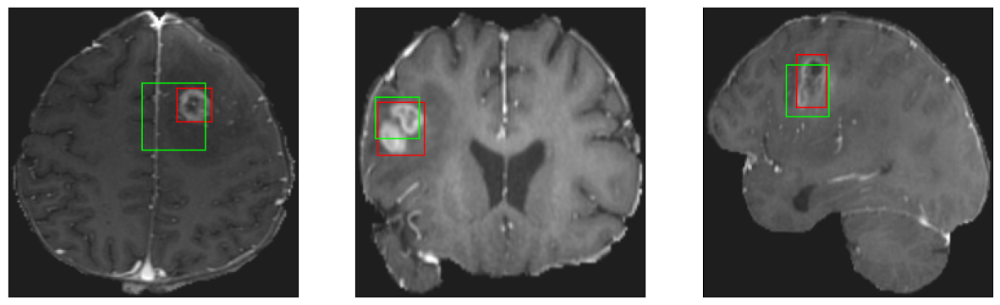

26/26 [==============================] - 3s 129ms/step - loss: 5.2122 - IoU: 0.6193 - val_loss: 7.7613 - val_IoU: 0.5139
Epoch 84/200
25/26 [===========================>..] - ETA: 0s - loss: 5.1033 - IoU: 0.6188
Epoch 84: val_IoU improved from 0.56387 to 0.56570, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


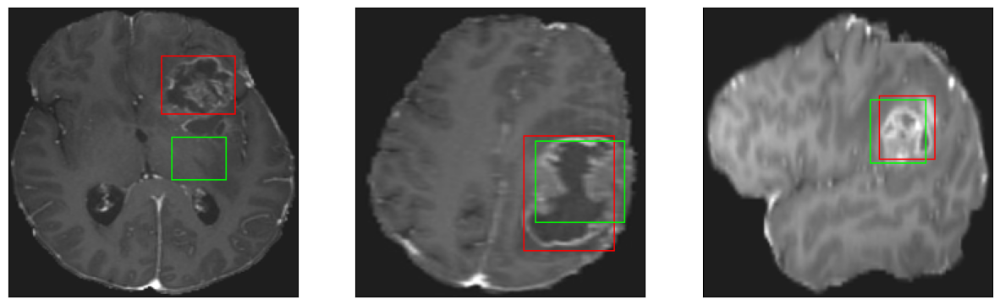

26/26 [==============================] - 3s 120ms/step - loss: 5.1166 - IoU: 0.6182 - val_loss: 7.3605 - val_IoU: 0.5657
Epoch 85/200
25/26 [===========================>..] - ETA: 0s - loss: 4.8897 - IoU: 0.6240
Epoch 85: val_IoU did not improve from 0.56570
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


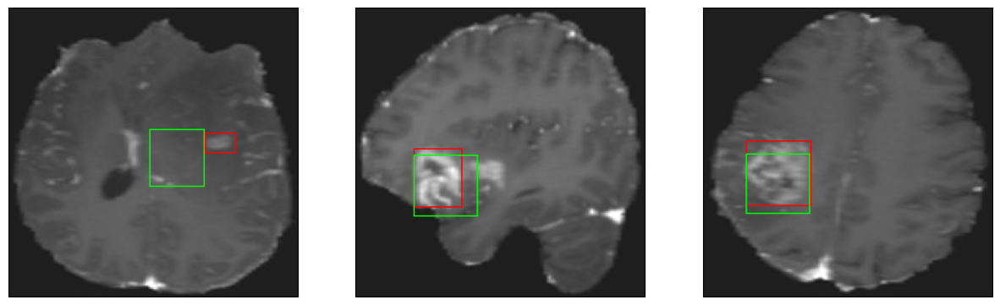

26/26 [==============================] - 3s 105ms/step - loss: 4.9059 - IoU: 0.6220 - val_loss: 9.1636 - val_IoU: 0.4379
Epoch 86/200
26/26 [==============================] - ETA: 0s - loss: 5.1630 - IoU: 0.6124
Epoch 86: val_IoU did not improve from 0.56570
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4


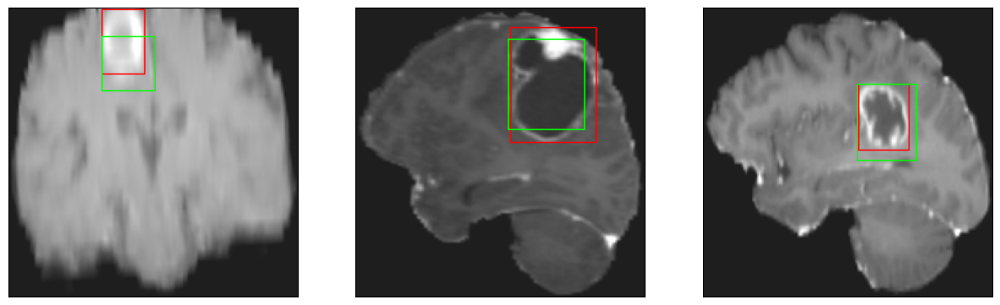

26/26 [==============================] - 3s 129ms/step - loss: 5.1630 - IoU: 0.6124 - val_loss: 9.2154 - val_IoU: 0.4670
Epoch 87/200
26/26 [==============================] - ETA: 0s - loss: 4.9911 - IoU: 0.6235
Epoch 87: val_IoU did not improve from 0.56570
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


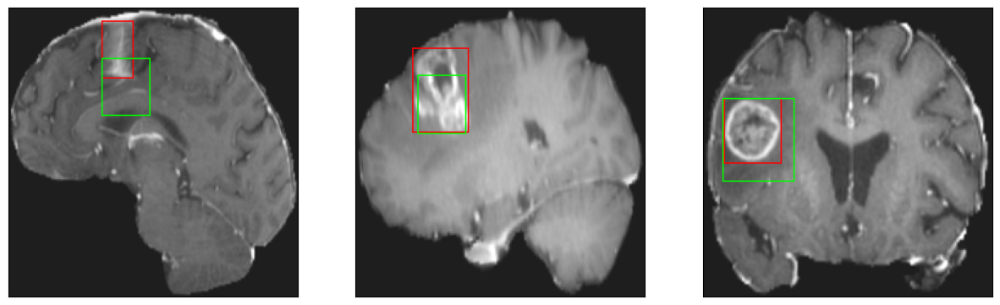

26/26 [==============================] - 3s 121ms/step - loss: 4.9911 - IoU: 0.6235 - val_loss: 8.3649 - val_IoU: 0.4811
Epoch 88/200
25/26 [===========================>..] - ETA: 0s - loss: 5.0979 - IoU: 0.6199
Epoch 88: val_IoU did not improve from 0.56570
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


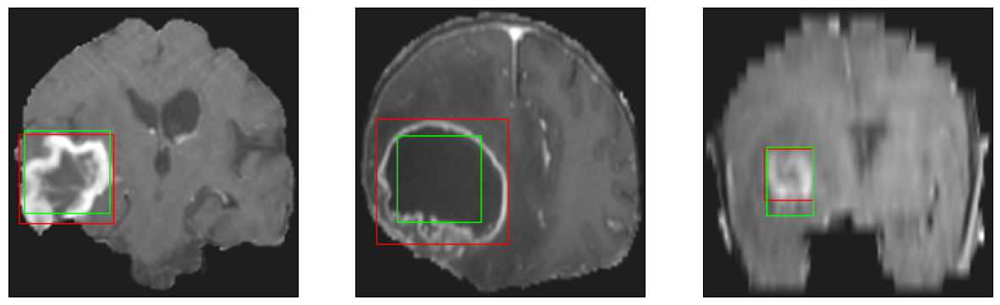

26/26 [==============================] - 3s 103ms/step - loss: 5.0576 - IoU: 0.6208 - val_loss: 7.6782 - val_IoU: 0.5420
Epoch 89/200
26/26 [==============================] - ETA: 0s - loss: 4.8755 - IoU: 0.6210
Epoch 89: val_IoU did not improve from 0.56570
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 10ms/step
4


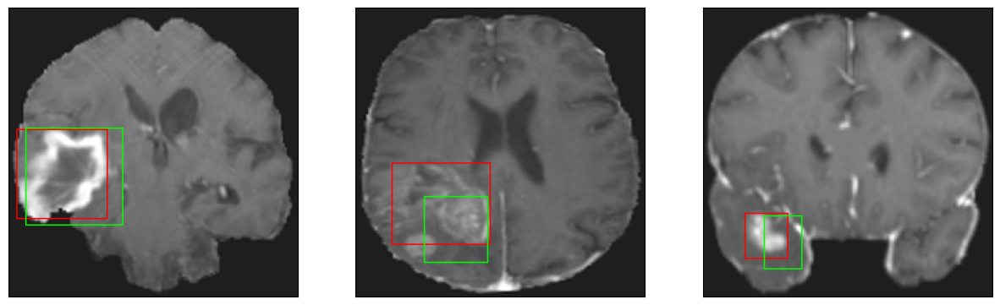

26/26 [==============================] - 3s 119ms/step - loss: 4.8755 - IoU: 0.6210 - val_loss: 9.3919 - val_IoU: 0.4488
Epoch 90/200
25/26 [===========================>..] - ETA: 0s - loss: 5.2078 - IoU: 0.6114
Epoch 90: val_IoU did not improve from 0.56570
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 8ms/step
4


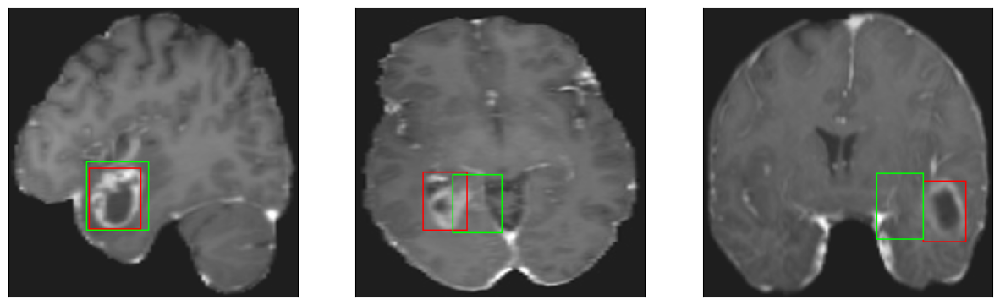

26/26 [==============================] - 3s 127ms/step - loss: 5.2064 - IoU: 0.6112 - val_loss: 9.8051 - val_IoU: 0.4896
Epoch 91/200
25/26 [===========================>..] - ETA: 0s - loss: 4.9905 - IoU: 0.6246
Epoch 91: val_IoU did not improve from 0.56570
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


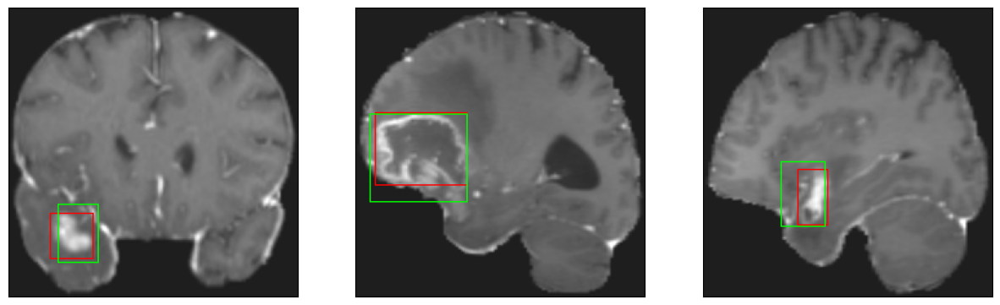

26/26 [==============================] - 3s 107ms/step - loss: 4.9785 - IoU: 0.6238 - val_loss: 7.8921 - val_IoU: 0.5279
Epoch 92/200
25/26 [===========================>..] - ETA: 0s - loss: 4.8246 - IoU: 0.6323
Epoch 92: val_IoU did not improve from 0.56570
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


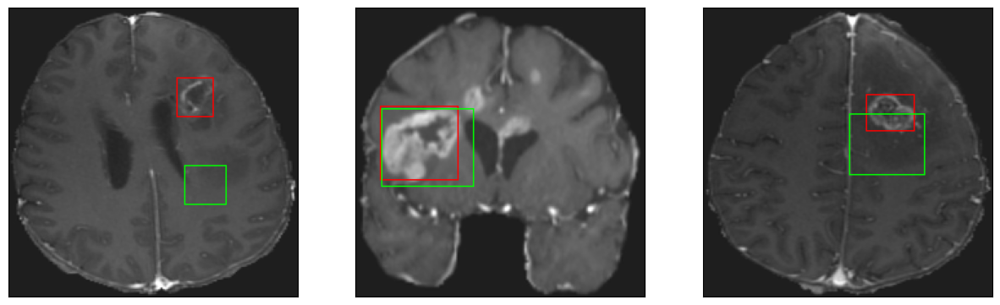

26/26 [==============================] - 3s 105ms/step - loss: 4.8418 - IoU: 0.6328 - val_loss: 10.3495 - val_IoU: 0.4236
Epoch 93/200
25/26 [===========================>..] - ETA: 0s - loss: 4.8759 - IoU: 0.6326
Epoch 93: val_IoU did not improve from 0.56570
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4


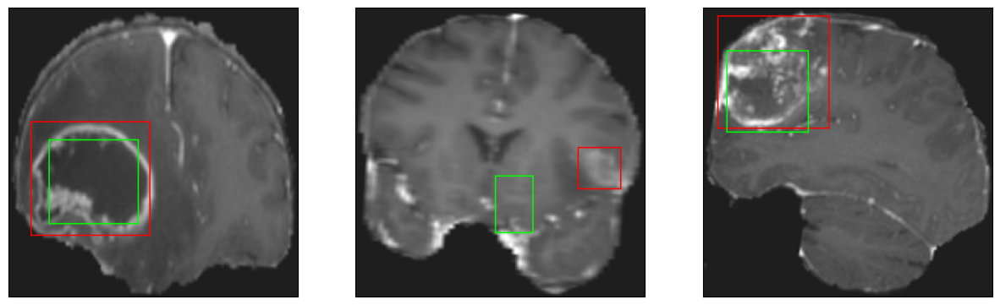

26/26 [==============================] - 3s 121ms/step - loss: 4.8822 - IoU: 0.6323 - val_loss: 7.6213 - val_IoU: 0.5260
Epoch 94/200
26/26 [==============================] - ETA: 0s - loss: 4.9192 - IoU: 0.6338
Epoch 94: val_IoU did not improve from 0.56570
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


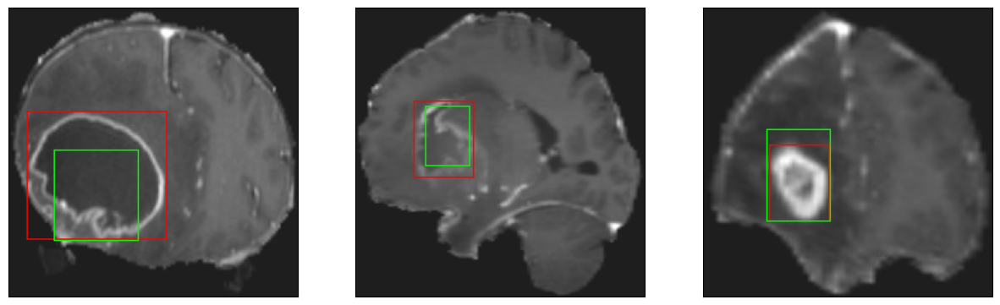

26/26 [==============================] - 3s 106ms/step - loss: 4.9192 - IoU: 0.6338 - val_loss: 8.3317 - val_IoU: 0.4812
Epoch 95/200
25/26 [===========================>..] - ETA: 0s - loss: 4.9075 - IoU: 0.6214
Epoch 95: val_IoU did not improve from 0.56570
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


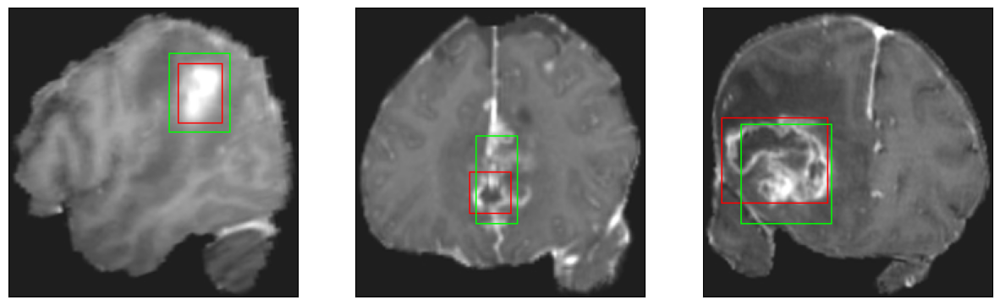

26/26 [==============================] - 3s 107ms/step - loss: 4.8956 - IoU: 0.6240 - val_loss: 8.0858 - val_IoU: 0.5523
Epoch 96/200
26/26 [==============================] - ETA: 0s - loss: 4.8096 - IoU: 0.6288
Epoch 96: val_IoU did not improve from 0.56570
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


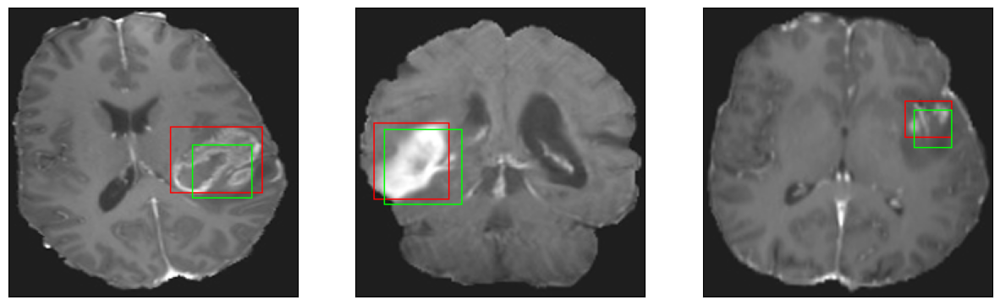

26/26 [==============================] - 3s 106ms/step - loss: 4.8096 - IoU: 0.6288 - val_loss: 7.9581 - val_IoU: 0.5301
Epoch 97/200
26/26 [==============================] - ETA: 0s - loss: 4.7998 - IoU: 0.6296
Epoch 97: val_IoU did not improve from 0.56570
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 11ms/step
4


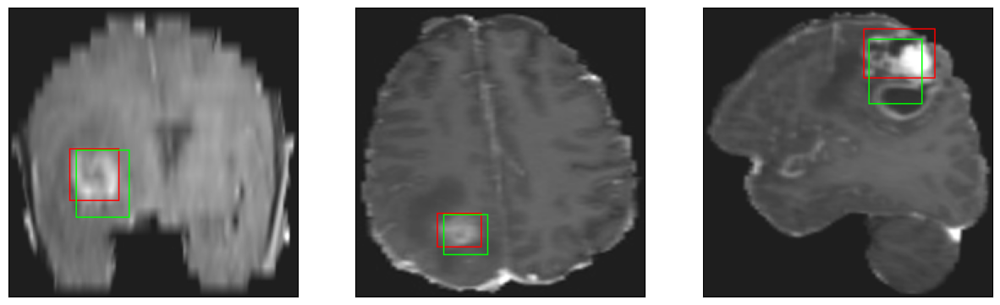

26/26 [==============================] - 3s 119ms/step - loss: 4.7998 - IoU: 0.6296 - val_loss: 9.4192 - val_IoU: 0.4316
Epoch 98/200
26/26 [==============================] - ETA: 0s - loss: 4.7286 - IoU: 0.6322
Epoch 98: val_IoU did not improve from 0.56570
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 13ms/step
4


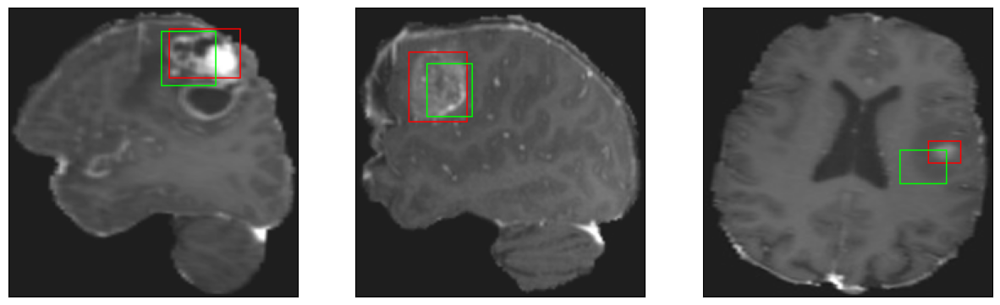

26/26 [==============================] - 3s 128ms/step - loss: 4.7286 - IoU: 0.6322 - val_loss: 7.8181 - val_IoU: 0.5293
Epoch 99/200
25/26 [===========================>..] - ETA: 0s - loss: 4.6733 - IoU: 0.6396
Epoch 99: val_IoU did not improve from 0.56570
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


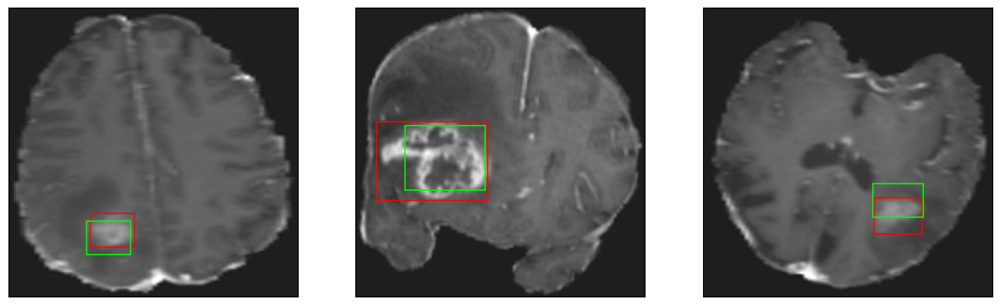

26/26 [==============================] - 3s 103ms/step - loss: 4.7319 - IoU: 0.6369 - val_loss: 7.6030 - val_IoU: 0.5552
Epoch 100/200
25/26 [===========================>..] - ETA: 0s - loss: 4.8598 - IoU: 0.6228
Epoch 100: val_IoU did not improve from 0.56570
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


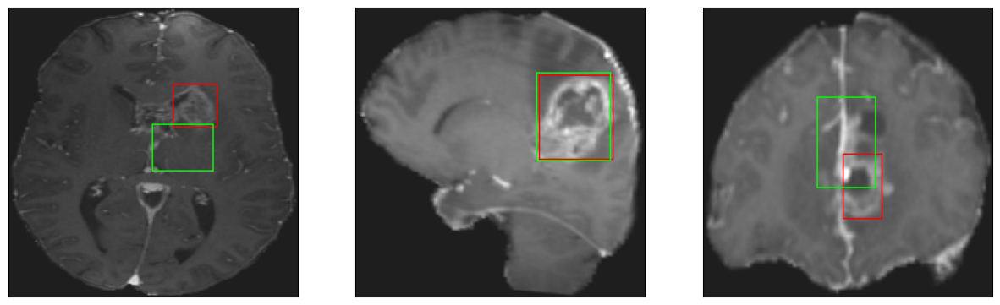

26/26 [==============================] - 3s 112ms/step - loss: 4.8775 - IoU: 0.6205 - val_loss: 8.4176 - val_IoU: 0.5176
Epoch 101/200
25/26 [===========================>..] - ETA: 0s - loss: 5.2387 - IoU: 0.6086
Epoch 101: val_IoU did not improve from 0.56570
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


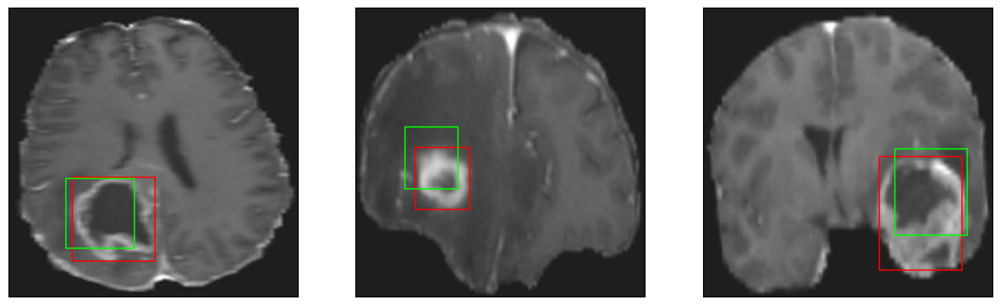

26/26 [==============================] - 3s 122ms/step - loss: 5.2264 - IoU: 0.6093 - val_loss: 8.1244 - val_IoU: 0.5157
Epoch 102/200
25/26 [===========================>..] - ETA: 0s - loss: 4.7295 - IoU: 0.6373
Epoch 102: val_IoU did not improve from 0.56570
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4


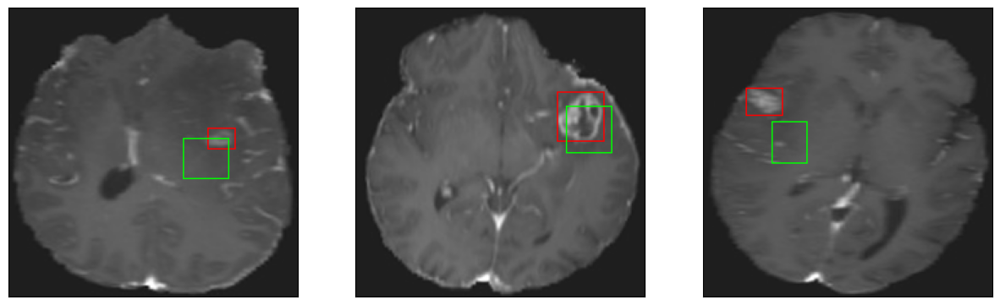

26/26 [==============================] - 3s 118ms/step - loss: 4.7288 - IoU: 0.6374 - val_loss: 7.9907 - val_IoU: 0.5082
Epoch 103/200
26/26 [==============================] - ETA: 0s - loss: 4.7800 - IoU: 0.6311
Epoch 103: val_IoU did not improve from 0.56570
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 8ms/step
4


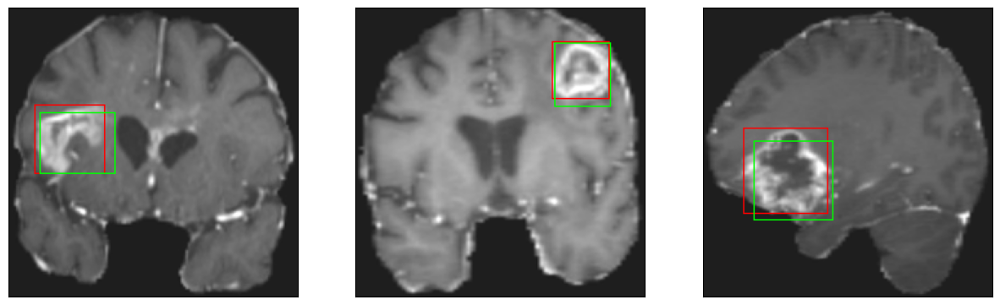

26/26 [==============================] - 3s 122ms/step - loss: 4.7800 - IoU: 0.6311 - val_loss: 8.3464 - val_IoU: 0.4626
Epoch 104/200
25/26 [===========================>..] - ETA: 0s - loss: 4.7068 - IoU: 0.6396
Epoch 104: val_IoU did not improve from 0.56570
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


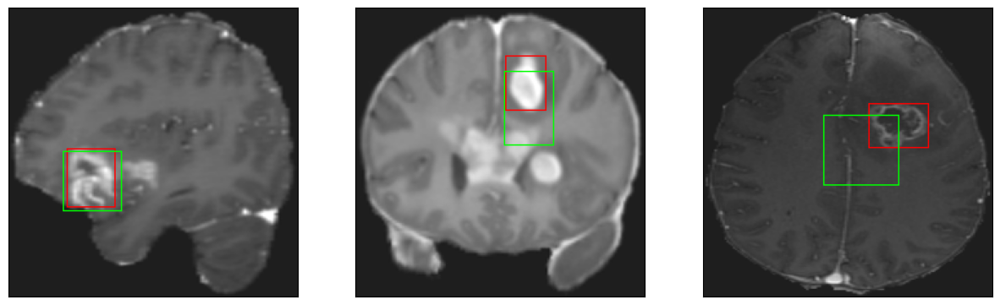

26/26 [==============================] - 3s 99ms/step - loss: 4.8129 - IoU: 0.6340 - val_loss: 7.6048 - val_IoU: 0.5346
Epoch 105/200
25/26 [===========================>..] - ETA: 0s - loss: 4.9289 - IoU: 0.6300
Epoch 105: val_IoU did not improve from 0.56570
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


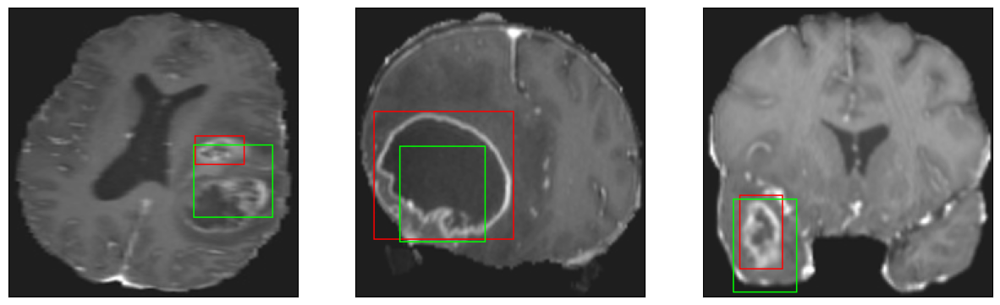

26/26 [==============================] - 3s 108ms/step - loss: 4.9353 - IoU: 0.6299 - val_loss: 7.8712 - val_IoU: 0.5411
Epoch 106/200
26/26 [==============================] - ETA: 0s - loss: 4.7277 - IoU: 0.6312
Epoch 106: val_IoU did not improve from 0.56570
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 8ms/step
4


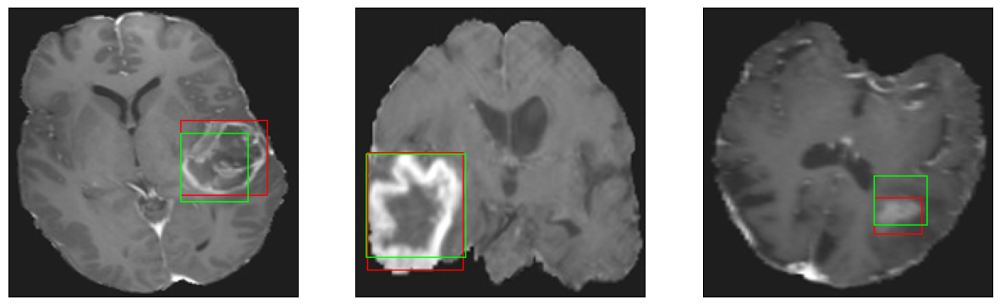

26/26 [==============================] - 3s 110ms/step - loss: 4.7277 - IoU: 0.6312 - val_loss: 8.2460 - val_IoU: 0.5311
Epoch 107/200
26/26 [==============================] - ETA: 0s - loss: 4.7139 - IoU: 0.6365
Epoch 107: val_IoU did not improve from 0.56570
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 11ms/step
4


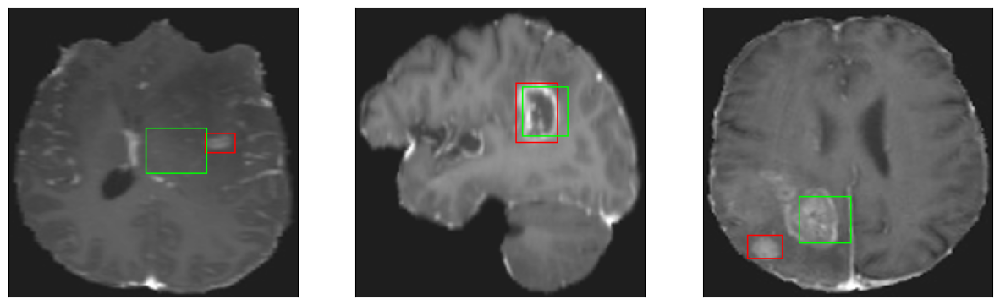

26/26 [==============================] - 3s 123ms/step - loss: 4.7139 - IoU: 0.6365 - val_loss: 8.9027 - val_IoU: 0.5027
Epoch 108/200
25/26 [===========================>..] - ETA: 0s - loss: 4.7296 - IoU: 0.6245
Epoch 108: val_IoU did not improve from 0.56570
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


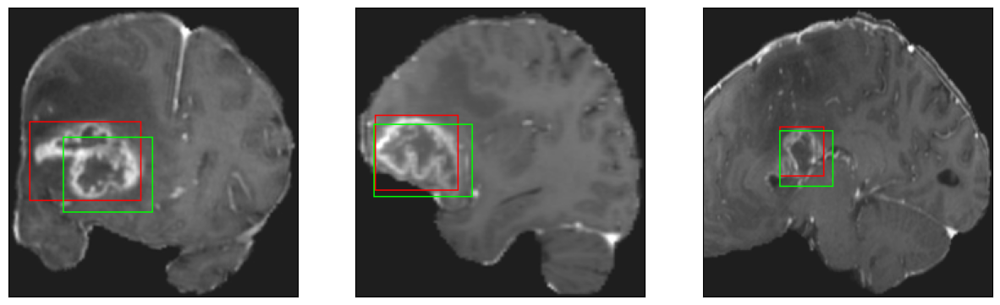

26/26 [==============================] - 3s 103ms/step - loss: 4.7084 - IoU: 0.6280 - val_loss: 8.7959 - val_IoU: 0.4848
Epoch 109/200
25/26 [===========================>..] - ETA: 0s - loss: 4.7559 - IoU: 0.6301
Epoch 109: val_IoU did not improve from 0.56570
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


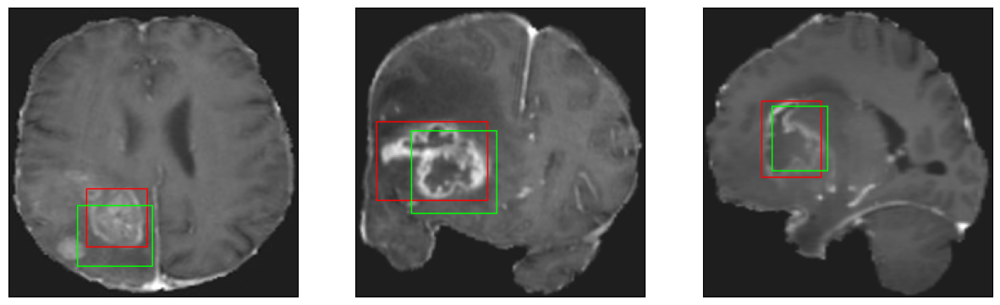

26/26 [==============================] - 3s 110ms/step - loss: 4.7263 - IoU: 0.6324 - val_loss: 10.1019 - val_IoU: 0.4518
Epoch 110/200
26/26 [==============================] - ETA: 0s - loss: 4.7390 - IoU: 0.6324
Epoch 110: val_IoU did not improve from 0.56570
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


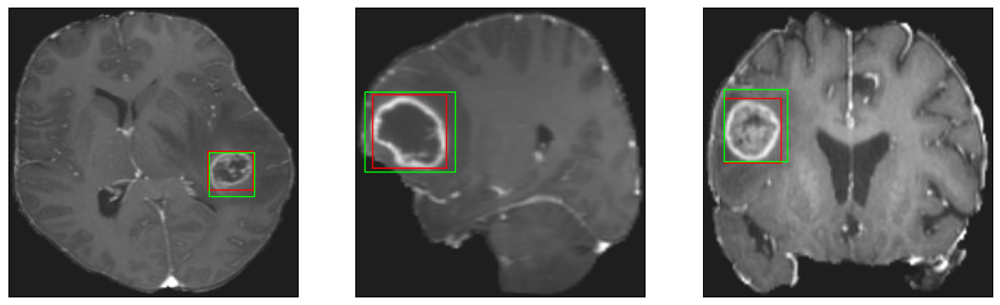

26/26 [==============================] - 3s 116ms/step - loss: 4.7390 - IoU: 0.6324 - val_loss: 7.6306 - val_IoU: 0.5393
Epoch 111/200
25/26 [===========================>..] - ETA: 0s - loss: 4.6677 - IoU: 0.6372
Epoch 111: val_IoU did not improve from 0.56570
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


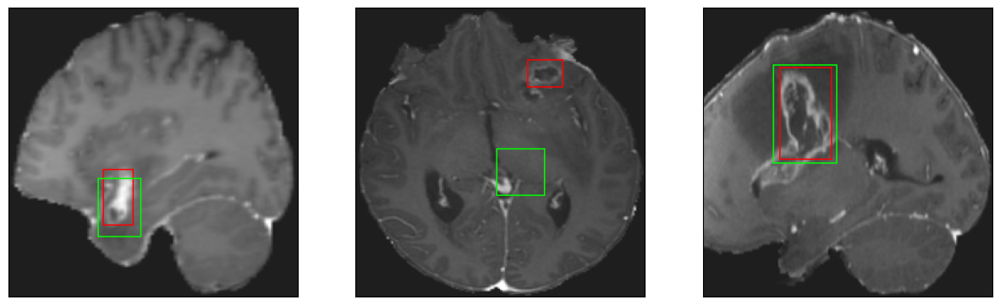

26/26 [==============================] - 3s 119ms/step - loss: 4.6235 - IoU: 0.6401 - val_loss: 9.4075 - val_IoU: 0.4136
Epoch 112/200
25/26 [===========================>..] - ETA: 0s - loss: 4.6873 - IoU: 0.6362
Epoch 112: val_IoU did not improve from 0.56570
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


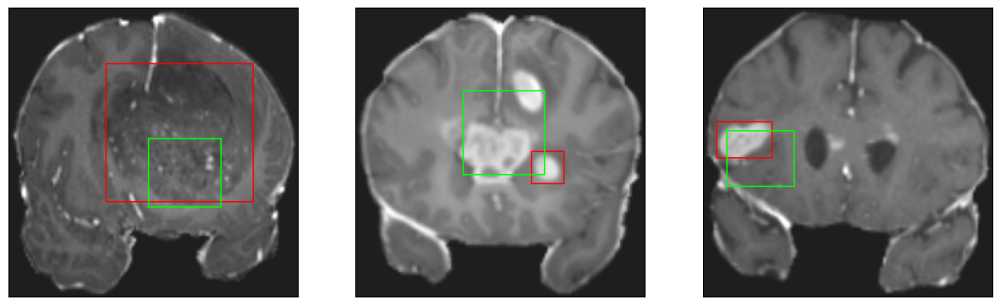

26/26 [==============================] - 3s 107ms/step - loss: 4.6485 - IoU: 0.6385 - val_loss: 9.6389 - val_IoU: 0.4449
Epoch 113/200
25/26 [===========================>..] - ETA: 0s - loss: 4.7538 - IoU: 0.6328
Epoch 113: val_IoU did not improve from 0.56570
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


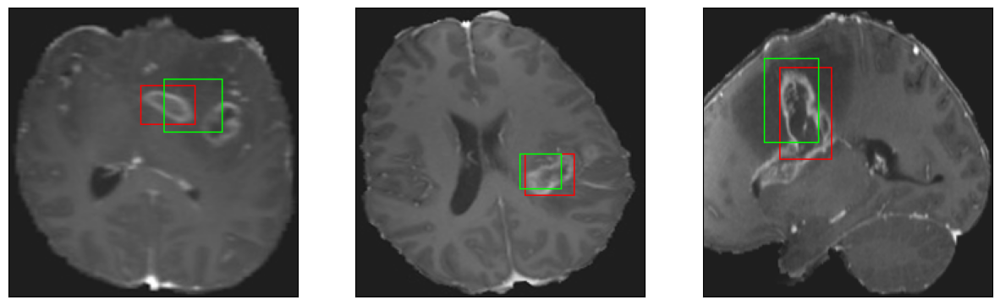

26/26 [==============================] - 3s 104ms/step - loss: 4.7161 - IoU: 0.6325 - val_loss: 7.8666 - val_IoU: 0.5319
Epoch 114/200
26/26 [==============================] - ETA: 0s - loss: 4.7314 - IoU: 0.6386
Epoch 114: val_IoU improved from 0.56570 to 0.58145, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4


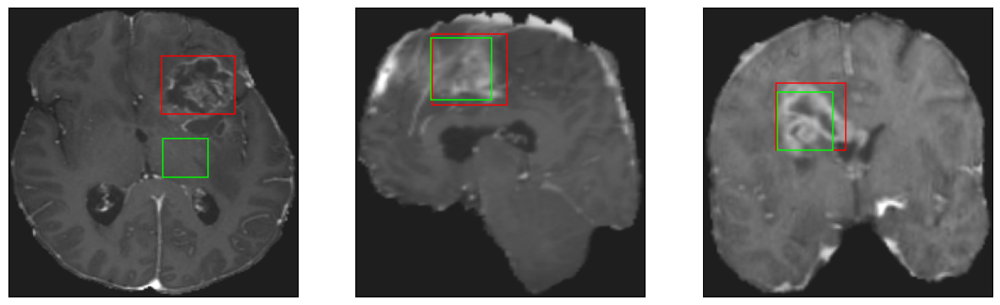

26/26 [==============================] - 4s 149ms/step - loss: 4.7314 - IoU: 0.6386 - val_loss: 6.9488 - val_IoU: 0.5814
Epoch 115/200
25/26 [===========================>..] - ETA: 0s - loss: 4.6389 - IoU: 0.6390
Epoch 115: val_IoU did not improve from 0.58145
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


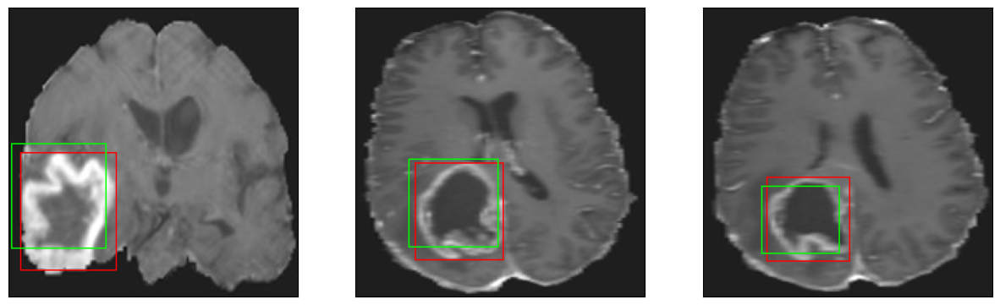

26/26 [==============================] - 3s 109ms/step - loss: 4.6666 - IoU: 0.6379 - val_loss: 7.9115 - val_IoU: 0.5370
Epoch 116/200
26/26 [==============================] - ETA: 0s - loss: 4.5157 - IoU: 0.6432
Epoch 116: val_IoU did not improve from 0.58145
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


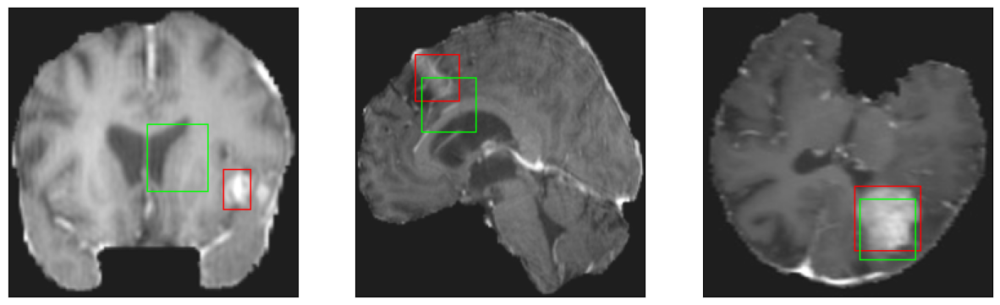

26/26 [==============================] - 3s 116ms/step - loss: 4.5157 - IoU: 0.6432 - val_loss: 7.2349 - val_IoU: 0.5723
Epoch 117/200
25/26 [===========================>..] - ETA: 0s - loss: 4.5433 - IoU: 0.6515
Epoch 117: val_IoU did not improve from 0.58145
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4


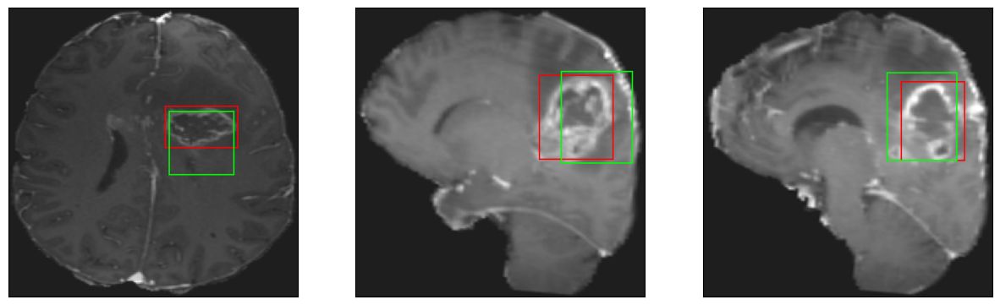

26/26 [==============================] - 3s 119ms/step - loss: 4.5149 - IoU: 0.6515 - val_loss: 7.8842 - val_IoU: 0.5354
Epoch 118/200
25/26 [===========================>..] - ETA: 0s - loss: 4.5772 - IoU: 0.6453
Epoch 118: val_IoU did not improve from 0.58145
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


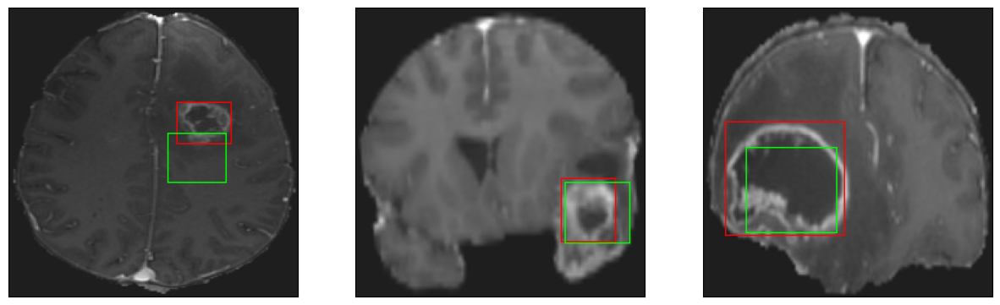

26/26 [==============================] - 3s 106ms/step - loss: 4.6076 - IoU: 0.6450 - val_loss: 9.1758 - val_IoU: 0.4525
Epoch 119/200
25/26 [===========================>..] - ETA: 0s - loss: 4.6233 - IoU: 0.6422
Epoch 119: val_IoU did not improve from 0.58145
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 8ms/step
4


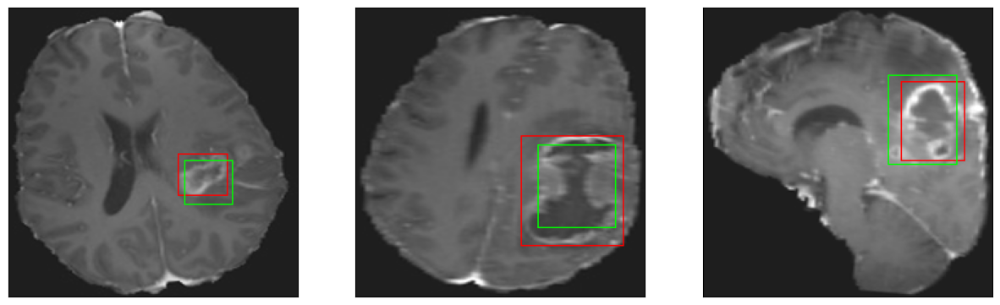

26/26 [==============================] - 3s 106ms/step - loss: 4.6382 - IoU: 0.6388 - val_loss: 10.3556 - val_IoU: 0.4503
Epoch 120/200
25/26 [===========================>..] - ETA: 0s - loss: 4.5995 - IoU: 0.6382
Epoch 120: val_IoU did not improve from 0.58145
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 12ms/step
4


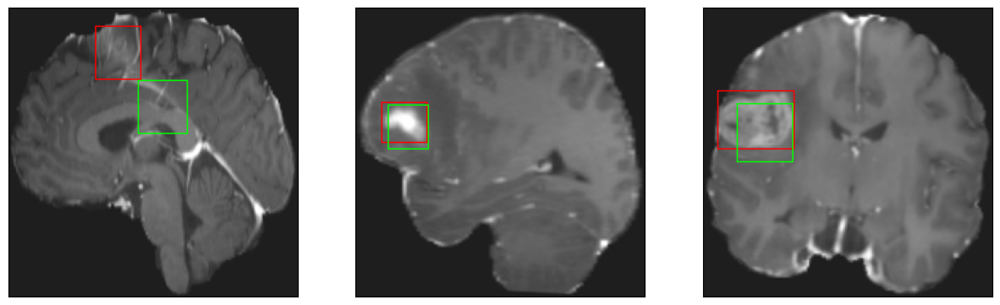

26/26 [==============================] - 3s 121ms/step - loss: 4.5842 - IoU: 0.6391 - val_loss: 8.9479 - val_IoU: 0.4468
Epoch 121/200
25/26 [===========================>..] - ETA: 0s - loss: 4.5798 - IoU: 0.6467
Epoch 121: val_IoU did not improve from 0.58145
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


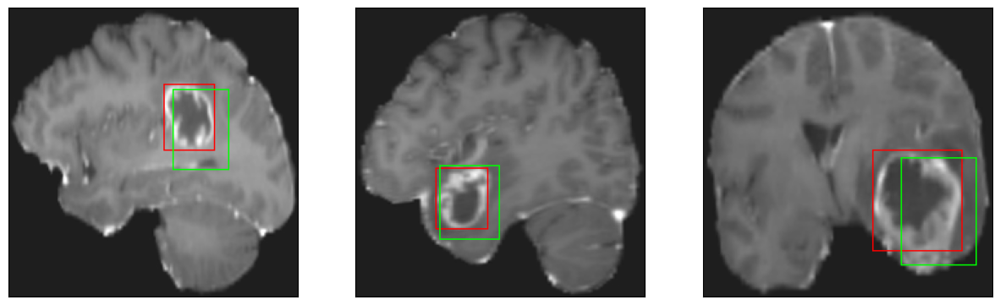

26/26 [==============================] - 3s 101ms/step - loss: 4.5758 - IoU: 0.6472 - val_loss: 11.2047 - val_IoU: 0.4007
Epoch 122/200
26/26 [==============================] - ETA: 0s - loss: 4.9886 - IoU: 0.6139
Epoch 122: val_IoU did not improve from 0.58145
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


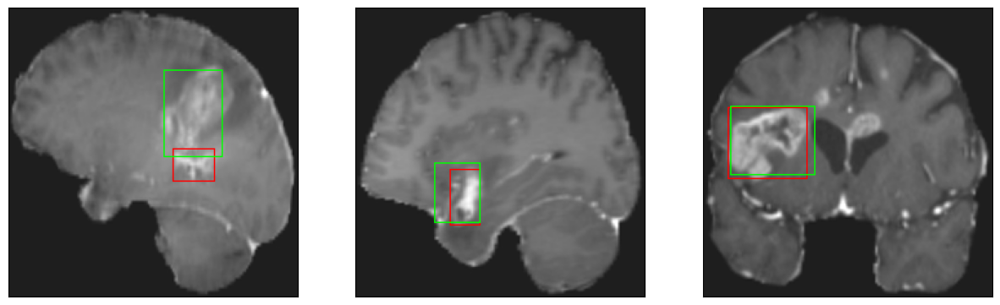

26/26 [==============================] - 3s 104ms/step - loss: 4.9886 - IoU: 0.6139 - val_loss: 7.2420 - val_IoU: 0.5681
Epoch 123/200
26/26 [==============================] - ETA: 0s - loss: 4.6231 - IoU: 0.6465
Epoch 123: val_IoU did not improve from 0.58145
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


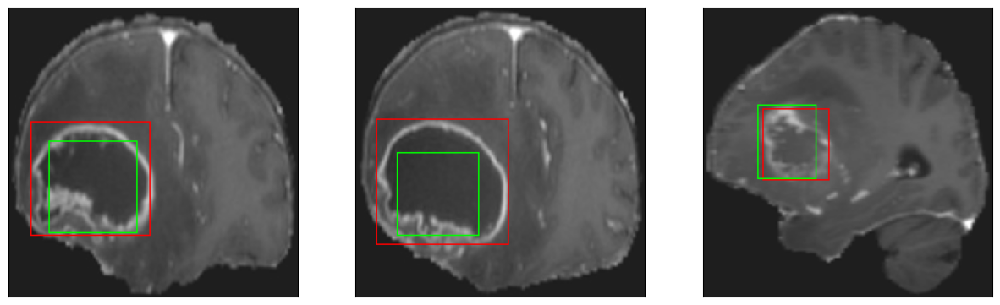

26/26 [==============================] - 3s 105ms/step - loss: 4.6231 - IoU: 0.6465 - val_loss: 8.8039 - val_IoU: 0.4860
Epoch 124/200
26/26 [==============================] - ETA: 0s - loss: 4.5456 - IoU: 0.6467
Epoch 124: val_IoU did not improve from 0.58145
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 9ms/step
4


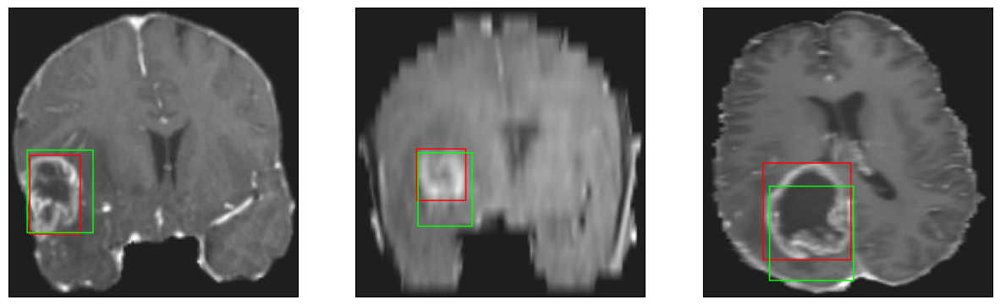

26/26 [==============================] - 3s 132ms/step - loss: 4.5456 - IoU: 0.6467 - val_loss: 8.6130 - val_IoU: 0.4719
Epoch 125/200
25/26 [===========================>..] - ETA: 0s - loss: 4.7617 - IoU: 0.6305
Epoch 125: val_IoU did not improve from 0.58145
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


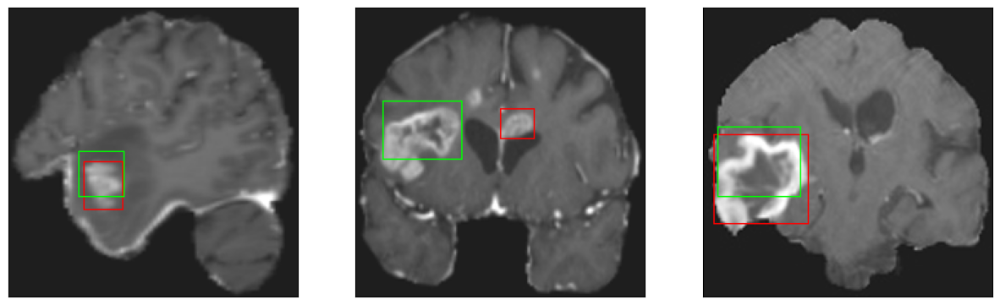

26/26 [==============================] - 3s 105ms/step - loss: 4.7527 - IoU: 0.6297 - val_loss: 8.4878 - val_IoU: 0.5011
Epoch 126/200
25/26 [===========================>..] - ETA: 0s - loss: 4.6723 - IoU: 0.6401
Epoch 126: val_IoU did not improve from 0.58145
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


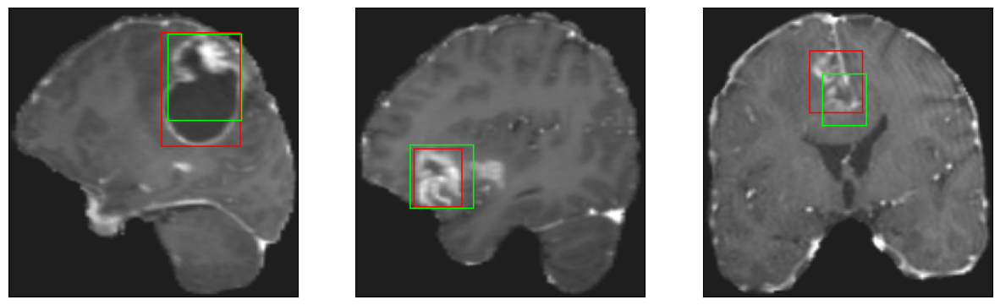

26/26 [==============================] - 3s 102ms/step - loss: 4.6647 - IoU: 0.6407 - val_loss: 8.0715 - val_IoU: 0.5301
Epoch 127/200
25/26 [===========================>..] - ETA: 0s - loss: 4.3823 - IoU: 0.6529
Epoch 127: val_IoU did not improve from 0.58145
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 11ms/step
4


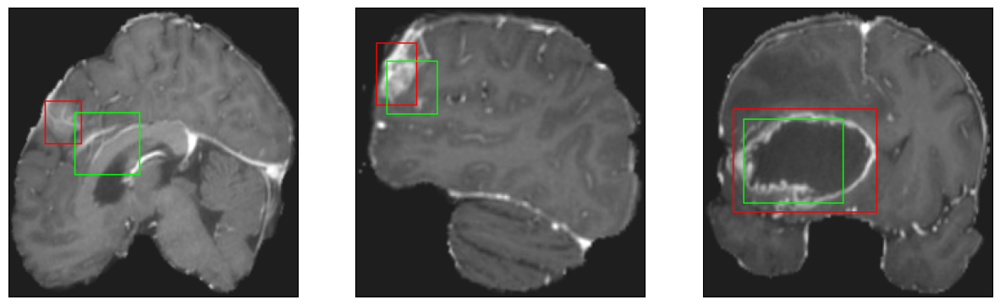

26/26 [==============================] - 3s 122ms/step - loss: 4.4477 - IoU: 0.6508 - val_loss: 7.3966 - val_IoU: 0.5620
Epoch 128/200
26/26 [==============================] - ETA: 0s - loss: 4.5709 - IoU: 0.6467
Epoch 128: val_IoU did not improve from 0.58145
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 10ms/step
4


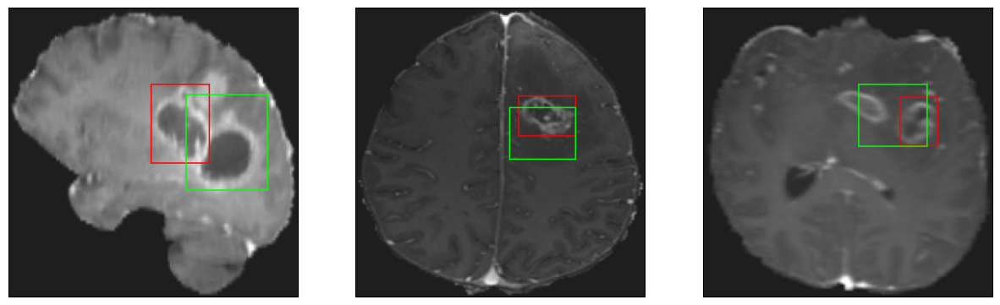

26/26 [==============================] - 3s 101ms/step - loss: 4.5709 - IoU: 0.6467 - val_loss: 8.8837 - val_IoU: 0.5222
Epoch 129/200
26/26 [==============================] - ETA: 0s - loss: 4.5852 - IoU: 0.6549
Epoch 129: val_IoU did not improve from 0.58145
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


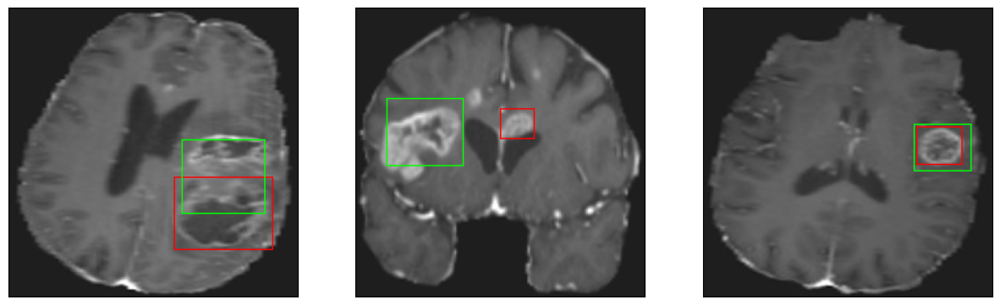

26/26 [==============================] - 3s 115ms/step - loss: 4.5852 - IoU: 0.6549 - val_loss: 6.9689 - val_IoU: 0.5763
Epoch 130/200
26/26 [==============================] - ETA: 0s - loss: 4.6136 - IoU: 0.6386
Epoch 130: val_IoU did not improve from 0.58145
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 10ms/step
4


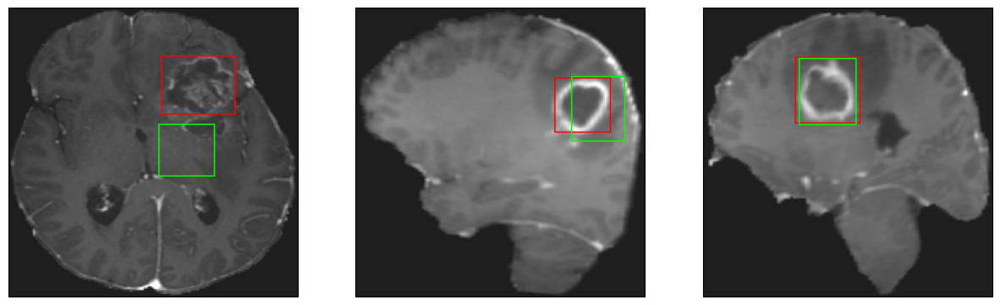

26/26 [==============================] - 3s 123ms/step - loss: 4.6136 - IoU: 0.6386 - val_loss: 7.2918 - val_IoU: 0.5605
Epoch 131/200
26/26 [==============================] - ETA: 0s - loss: 4.5478 - IoU: 0.6440
Epoch 131: val_IoU did not improve from 0.58145
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4


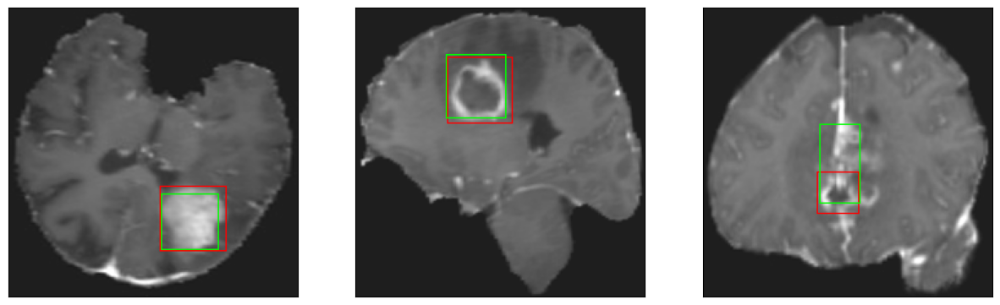

26/26 [==============================] - 3s 121ms/step - loss: 4.5478 - IoU: 0.6440 - val_loss: 7.3142 - val_IoU: 0.5772
Epoch 132/200
25/26 [===========================>..] - ETA: 0s - loss: 4.6959 - IoU: 0.6351
Epoch 132: val_IoU did not improve from 0.58145
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


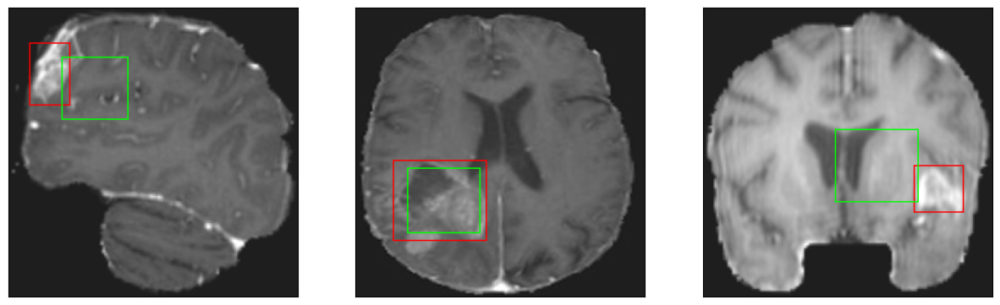

26/26 [==============================] - 3s 106ms/step - loss: 4.6802 - IoU: 0.6361 - val_loss: 8.2002 - val_IoU: 0.5379
Epoch 133/200
26/26 [==============================] - ETA: 0s - loss: 4.4914 - IoU: 0.6399
Epoch 133: val_IoU did not improve from 0.58145
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4


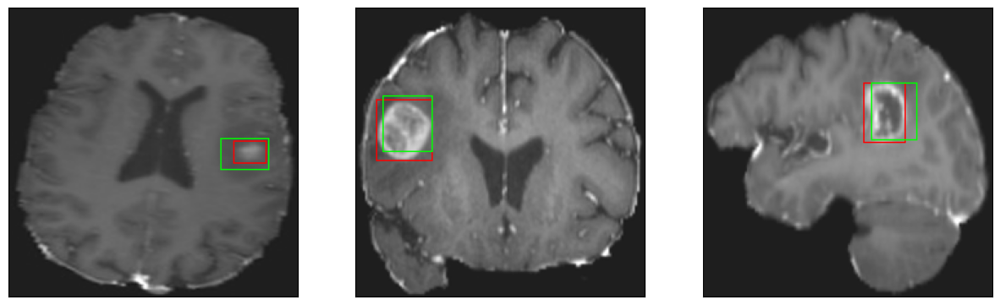

26/26 [==============================] - 3s 110ms/step - loss: 4.4914 - IoU: 0.6399 - val_loss: 7.1547 - val_IoU: 0.5575
Epoch 134/200
26/26 [==============================] - ETA: 0s - loss: 4.4414 - IoU: 0.6509
Epoch 134: val_IoU did not improve from 0.58145
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 10ms/step
4


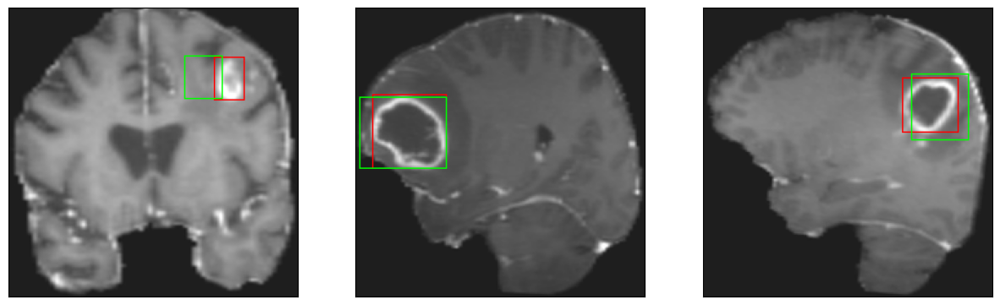

26/26 [==============================] - 3s 124ms/step - loss: 4.4414 - IoU: 0.6509 - val_loss: 7.5283 - val_IoU: 0.5363
Epoch 135/200
25/26 [===========================>..] - ETA: 0s - loss: 4.5185 - IoU: 0.6572
Epoch 135: val_IoU did not improve from 0.58145
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


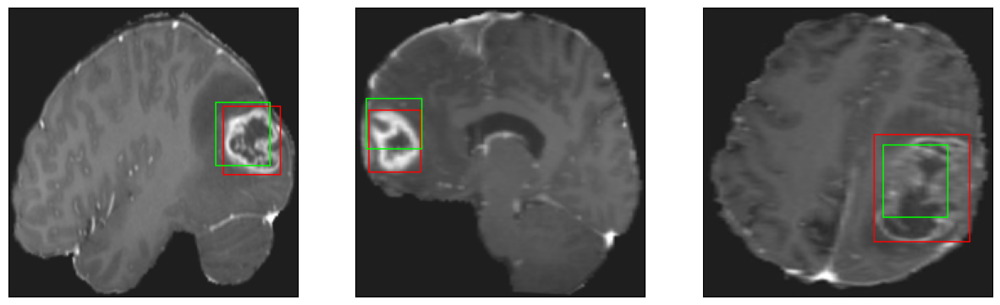

26/26 [==============================] - 3s 103ms/step - loss: 4.5164 - IoU: 0.6549 - val_loss: 7.7508 - val_IoU: 0.5221
Epoch 136/200
25/26 [===========================>..] - ETA: 0s - loss: 4.4909 - IoU: 0.6481
Epoch 136: val_IoU did not improve from 0.58145
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


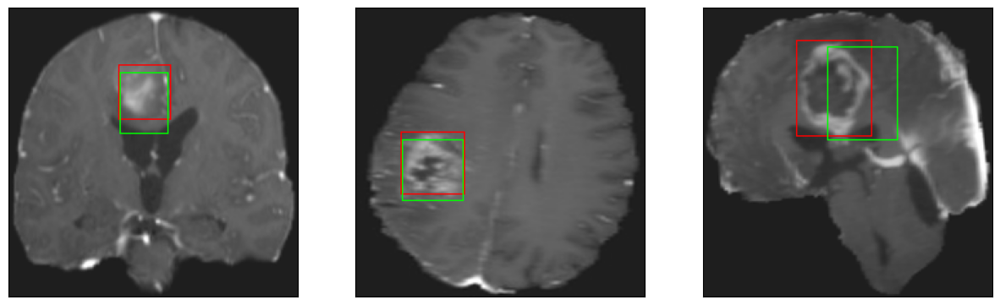

26/26 [==============================] - 3s 100ms/step - loss: 4.4603 - IoU: 0.6496 - val_loss: 8.6463 - val_IoU: 0.4712
Epoch 137/200
26/26 [==============================] - ETA: 0s - loss: 4.4395 - IoU: 0.6573
Epoch 137: val_IoU did not improve from 0.58145
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4


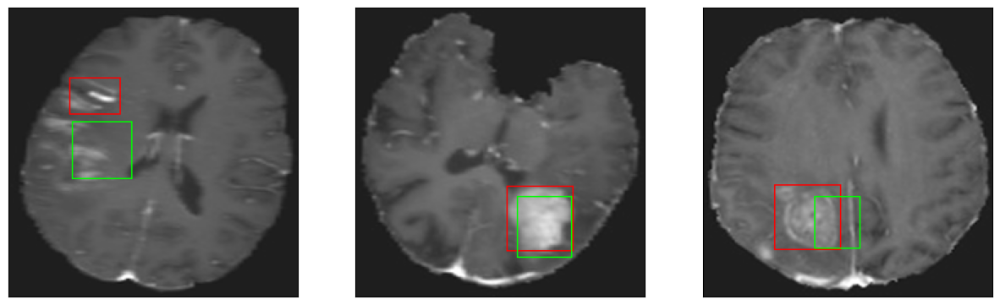

26/26 [==============================] - 3s 126ms/step - loss: 4.4395 - IoU: 0.6573 - val_loss: 9.2606 - val_IoU: 0.4685
Epoch 138/200
25/26 [===========================>..] - ETA: 0s - loss: 4.5130 - IoU: 0.6527
Epoch 138: val_IoU did not improve from 0.58145
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


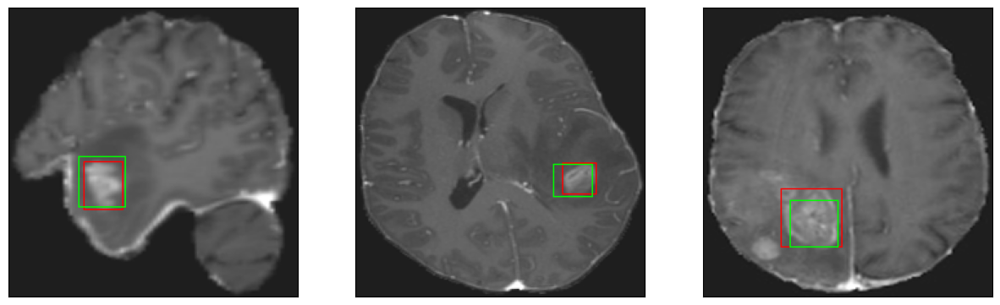

26/26 [==============================] - 3s 106ms/step - loss: 4.4923 - IoU: 0.6529 - val_loss: 8.0395 - val_IoU: 0.5277
Epoch 139/200
25/26 [===========================>..] - ETA: 0s - loss: 4.4891 - IoU: 0.6528
Epoch 139: val_IoU did not improve from 0.58145
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


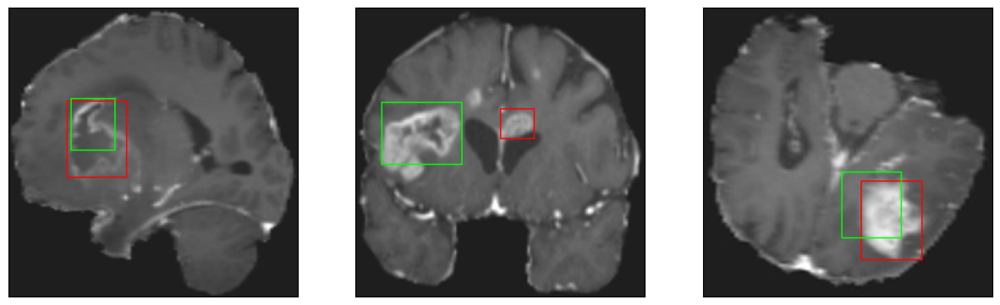

26/26 [==============================] - 3s 105ms/step - loss: 4.4646 - IoU: 0.6535 - val_loss: 7.4250 - val_IoU: 0.5417
Epoch 140/200
26/26 [==============================] - ETA: 0s - loss: 4.6443 - IoU: 0.6413
Epoch 140: val_IoU did not improve from 0.58145
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


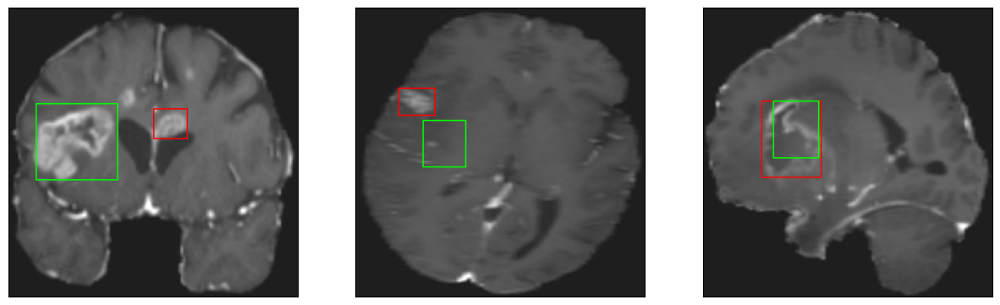

26/26 [==============================] - 3s 108ms/step - loss: 4.6443 - IoU: 0.6413 - val_loss: 7.8683 - val_IoU: 0.5382
Epoch 141/200
25/26 [===========================>..] - ETA: 0s - loss: 4.5687 - IoU: 0.6477
Epoch 141: val_IoU did not improve from 0.58145
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 10ms/step
4


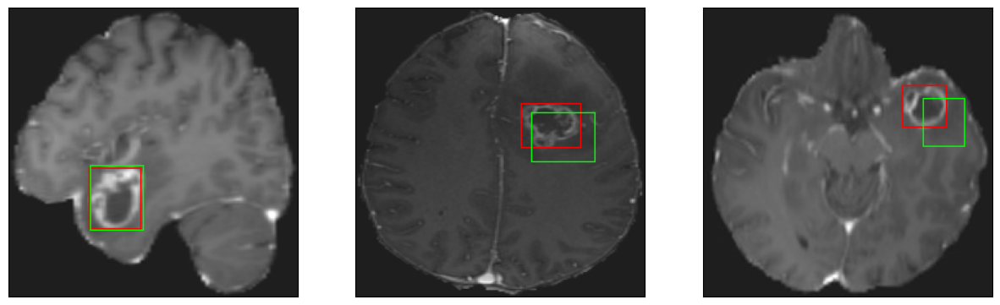

26/26 [==============================] - 3s 127ms/step - loss: 4.5456 - IoU: 0.6478 - val_loss: 8.4029 - val_IoU: 0.5004
Epoch 142/200
26/26 [==============================] - ETA: 0s - loss: 4.4652 - IoU: 0.6508
Epoch 142: val_IoU did not improve from 0.58145
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


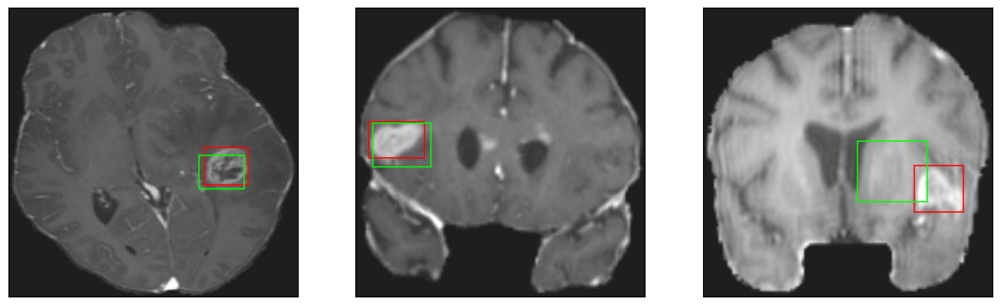

26/26 [==============================] - 3s 122ms/step - loss: 4.4652 - IoU: 0.6508 - val_loss: 7.5785 - val_IoU: 0.5447
Epoch 143/200
25/26 [===========================>..] - ETA: 0s - loss: 4.5822 - IoU: 0.6401
Epoch 143: val_IoU did not improve from 0.58145
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


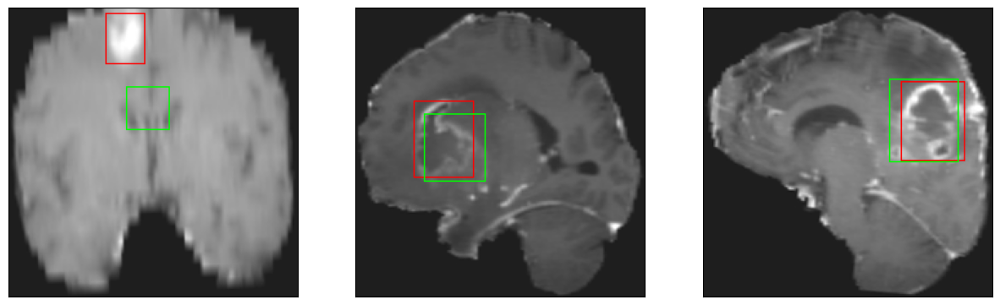

26/26 [==============================] - 3s 106ms/step - loss: 4.5894 - IoU: 0.6411 - val_loss: 9.6946 - val_IoU: 0.4741
Epoch 144/200
26/26 [==============================] - ETA: 0s - loss: 4.4918 - IoU: 0.6462
Epoch 144: val_IoU did not improve from 0.58145
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


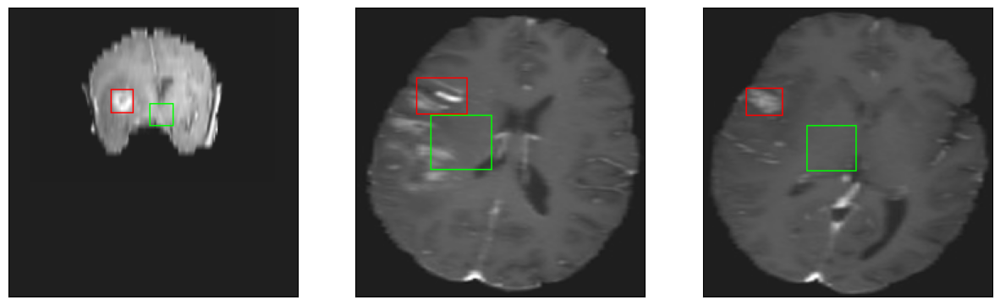

26/26 [==============================] - 3s 110ms/step - loss: 4.4918 - IoU: 0.6462 - val_loss: 9.0703 - val_IoU: 0.4867
Epoch 145/200
25/26 [===========================>..] - ETA: 0s - loss: 4.7228 - IoU: 0.6351
Epoch 145: val_IoU did not improve from 0.58145
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


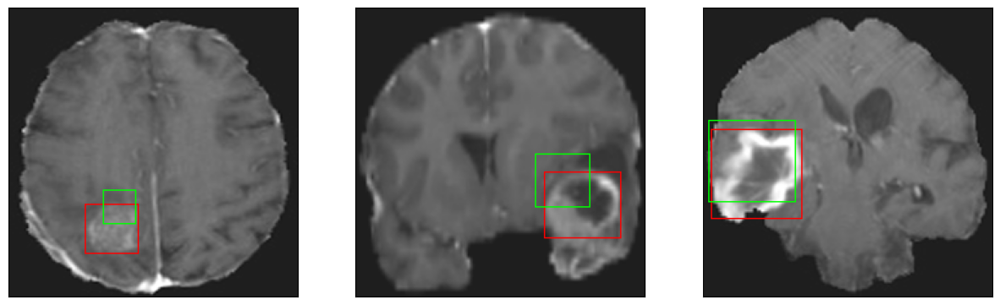

26/26 [==============================] - 3s 105ms/step - loss: 4.6893 - IoU: 0.6383 - val_loss: 9.2122 - val_IoU: 0.4177
Epoch 146/200
26/26 [==============================] - ETA: 0s - loss: 4.4108 - IoU: 0.6495
Epoch 146: val_IoU improved from 0.58145 to 0.58806, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


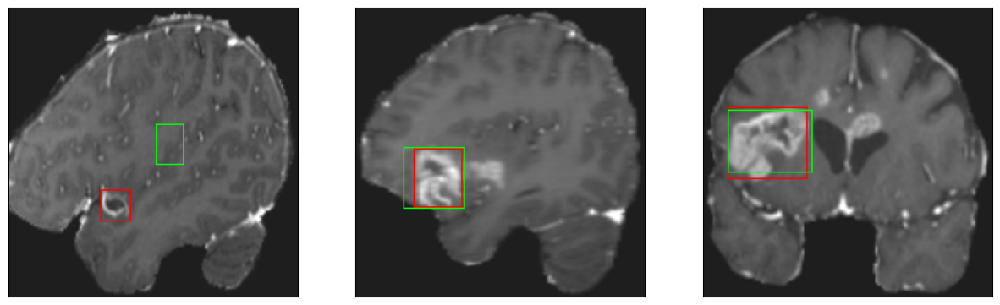

26/26 [==============================] - 3s 132ms/step - loss: 4.4108 - IoU: 0.6495 - val_loss: 6.8371 - val_IoU: 0.5881
Epoch 147/200
26/26 [==============================] - ETA: 0s - loss: 4.3100 - IoU: 0.6603
Epoch 147: val_IoU did not improve from 0.58806
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


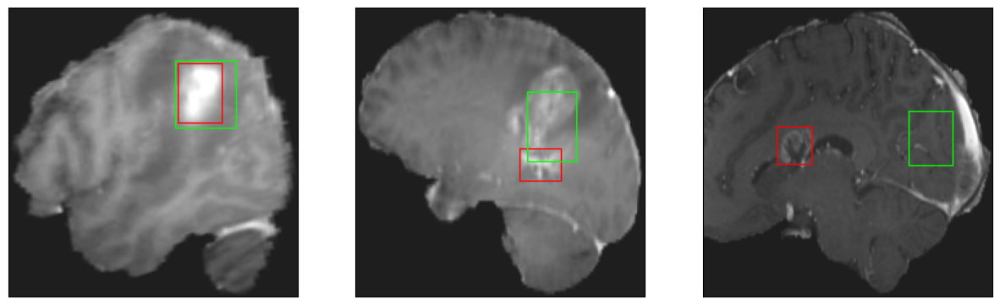

26/26 [==============================] - 3s 100ms/step - loss: 4.3100 - IoU: 0.6603 - val_loss: 8.8900 - val_IoU: 0.4934
Epoch 148/200
26/26 [==============================] - ETA: 0s - loss: 4.4424 - IoU: 0.6487
Epoch 148: val_IoU did not improve from 0.58806
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 12ms/step
4


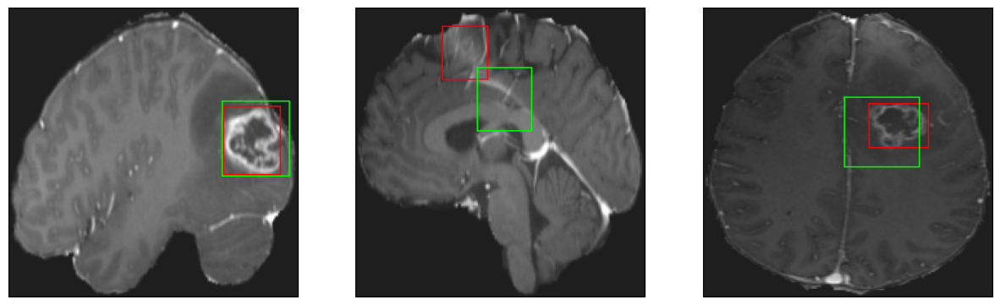

26/26 [==============================] - 3s 127ms/step - loss: 4.4424 - IoU: 0.6487 - val_loss: 7.2601 - val_IoU: 0.5761
Epoch 149/200
26/26 [==============================] - ETA: 0s - loss: 4.4900 - IoU: 0.6429
Epoch 149: val_IoU improved from 0.58806 to 0.58933, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


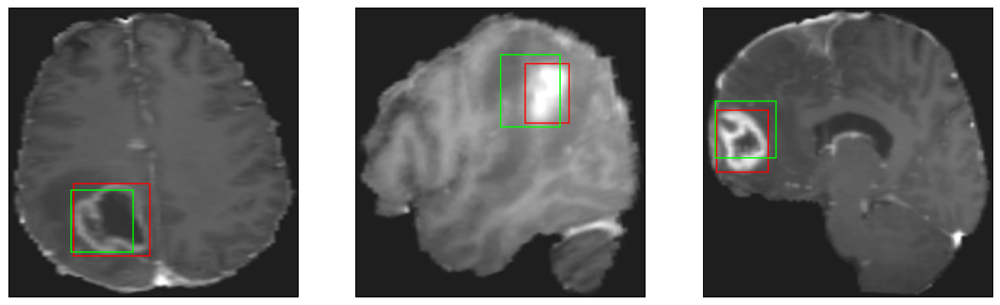

26/26 [==============================] - 4s 141ms/step - loss: 4.4900 - IoU: 0.6429 - val_loss: 6.8826 - val_IoU: 0.5893
Epoch 150/200
25/26 [===========================>..] - ETA: 0s - loss: 4.3924 - IoU: 0.6481
Epoch 150: val_IoU did not improve from 0.58933
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


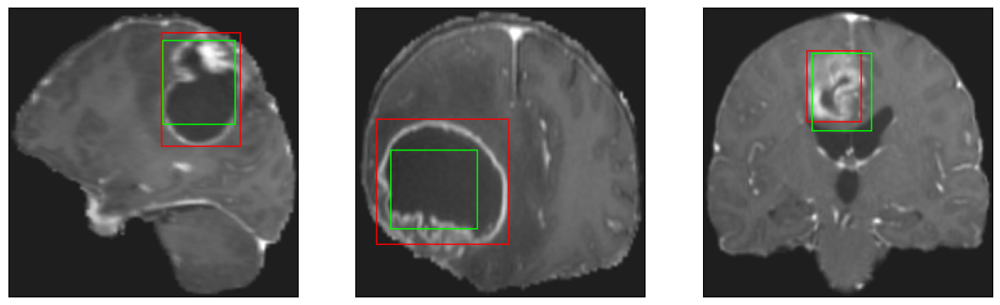

26/26 [==============================] - 3s 101ms/step - loss: 4.4679 - IoU: 0.6463 - val_loss: 6.9264 - val_IoU: 0.5810
Epoch 151/200
26/26 [==============================] - ETA: 0s - loss: 4.4446 - IoU: 0.6568
Epoch 151: val_IoU did not improve from 0.58933
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


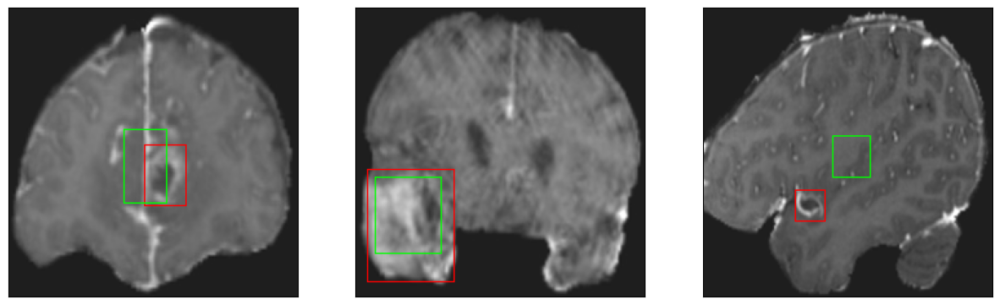

26/26 [==============================] - 3s 98ms/step - loss: 4.4446 - IoU: 0.6568 - val_loss: 8.3006 - val_IoU: 0.4743
Epoch 152/200
26/26 [==============================] - ETA: 0s - loss: 4.3446 - IoU: 0.6601
Epoch 152: val_IoU did not improve from 0.58933
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


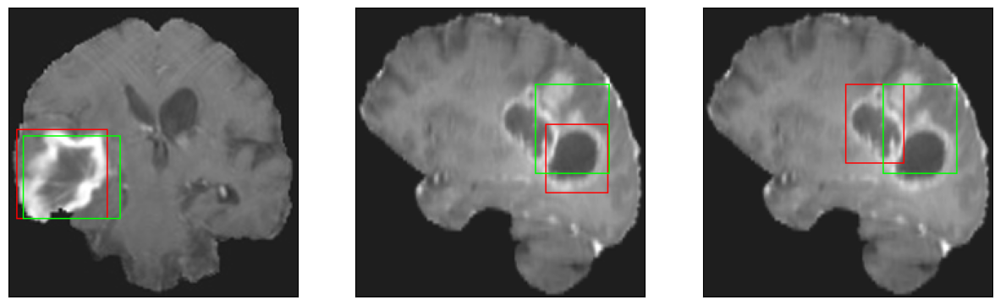

26/26 [==============================] - 3s 102ms/step - loss: 4.3446 - IoU: 0.6601 - val_loss: 7.6319 - val_IoU: 0.5292
Epoch 153/200
26/26 [==============================] - ETA: 0s - loss: 4.4022 - IoU: 0.6625
Epoch 153: val_IoU did not improve from 0.58933
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


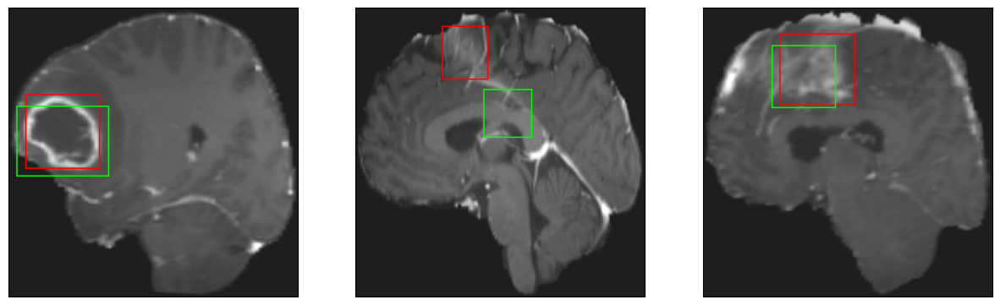

26/26 [==============================] - 3s 115ms/step - loss: 4.4022 - IoU: 0.6625 - val_loss: 7.3751 - val_IoU: 0.5683
Epoch 154/200
26/26 [==============================] - ETA: 0s - loss: 4.6014 - IoU: 0.6381
Epoch 154: val_IoU did not improve from 0.58933
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


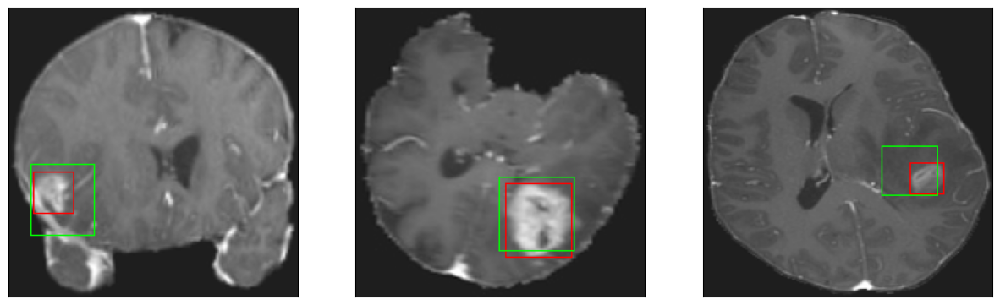

26/26 [==============================] - 3s 109ms/step - loss: 4.6014 - IoU: 0.6381 - val_loss: 8.4252 - val_IoU: 0.5339
Epoch 155/200
25/26 [===========================>..] - ETA: 0s - loss: 4.4239 - IoU: 0.6490
Epoch 155: val_IoU did not improve from 0.58933
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


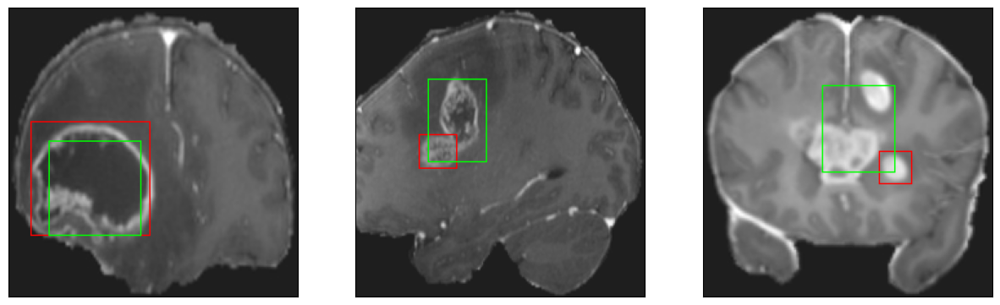

26/26 [==============================] - 3s 102ms/step - loss: 4.4489 - IoU: 0.6492 - val_loss: 8.6284 - val_IoU: 0.4855
Epoch 156/200
26/26 [==============================] - ETA: 0s - loss: 4.3825 - IoU: 0.6569
Epoch 156: val_IoU did not improve from 0.58933
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4


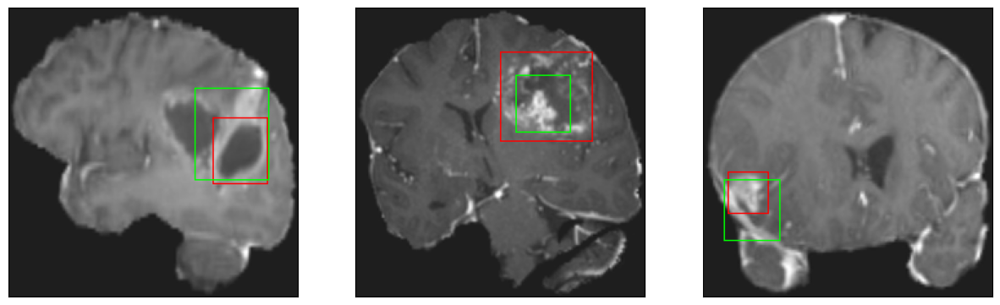

26/26 [==============================] - 4s 142ms/step - loss: 4.3825 - IoU: 0.6569 - val_loss: 7.3828 - val_IoU: 0.5533
Epoch 157/200
25/26 [===========================>..] - ETA: 0s - loss: 4.4042 - IoU: 0.6540
Epoch 157: val_IoU did not improve from 0.58933
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4


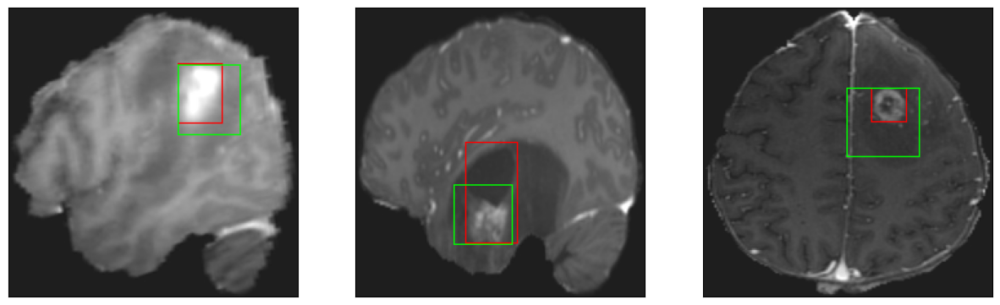

26/26 [==============================] - 3s 129ms/step - loss: 4.3950 - IoU: 0.6541 - val_loss: 9.9751 - val_IoU: 0.4088
Epoch 158/200
25/26 [===========================>..] - ETA: 0s - loss: 4.3394 - IoU: 0.6515
Epoch 158: val_IoU did not improve from 0.58933
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 10ms/step
4


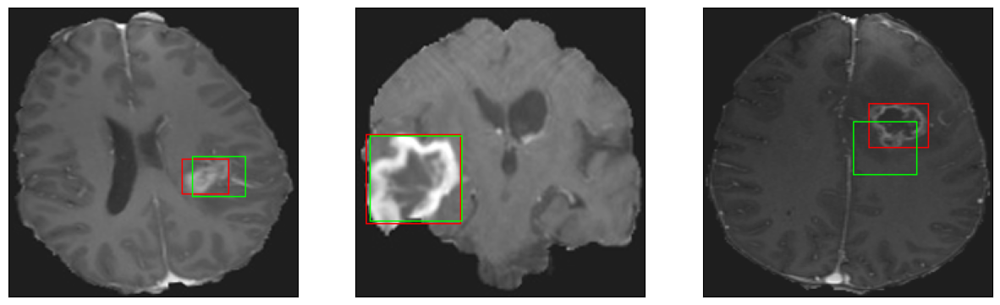

26/26 [==============================] - 3s 102ms/step - loss: 4.2798 - IoU: 0.6545 - val_loss: 7.7323 - val_IoU: 0.5443
Epoch 159/200
25/26 [===========================>..] - ETA: 0s - loss: 4.4004 - IoU: 0.6544
Epoch 159: val_IoU did not improve from 0.58933
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4


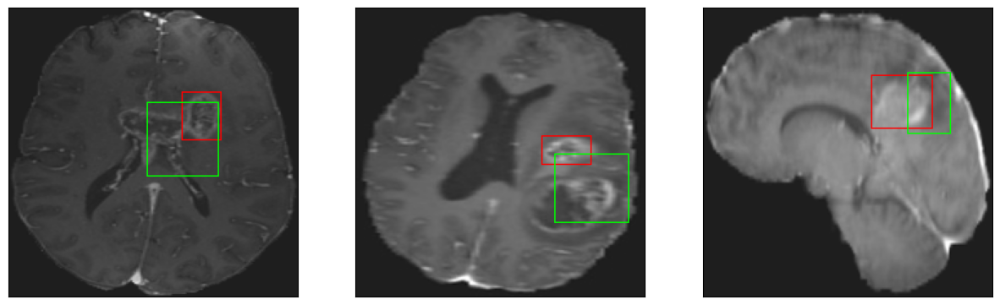

26/26 [==============================] - 3s 108ms/step - loss: 4.4301 - IoU: 0.6540 - val_loss: 7.9792 - val_IoU: 0.4925
Epoch 160/200
25/26 [===========================>..] - ETA: 0s - loss: 4.3537 - IoU: 0.6563
Epoch 160: val_IoU did not improve from 0.58933
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


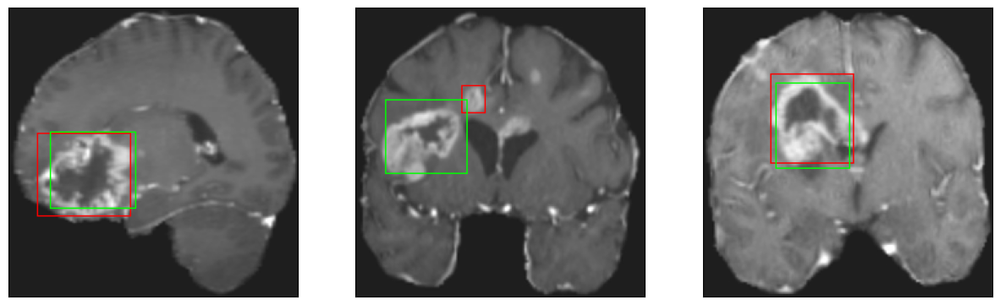

26/26 [==============================] - 3s 102ms/step - loss: 4.3449 - IoU: 0.6551 - val_loss: 7.3222 - val_IoU: 0.5496
Epoch 161/200
25/26 [===========================>..] - ETA: 0s - loss: 4.4134 - IoU: 0.6573
Epoch 161: val_IoU did not improve from 0.58933
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 11ms/step
4


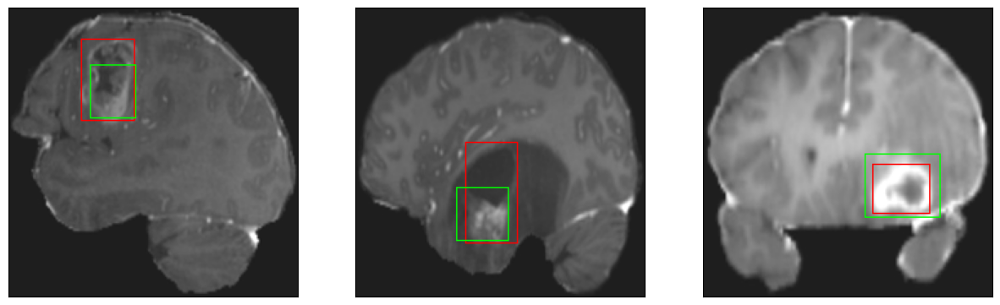

26/26 [==============================] - 4s 147ms/step - loss: 4.4225 - IoU: 0.6582 - val_loss: 8.1968 - val_IoU: 0.5099
Epoch 162/200
25/26 [===========================>..] - ETA: 0s - loss: 4.7500 - IoU: 0.6158
Epoch 162: val_IoU did not improve from 0.58933
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


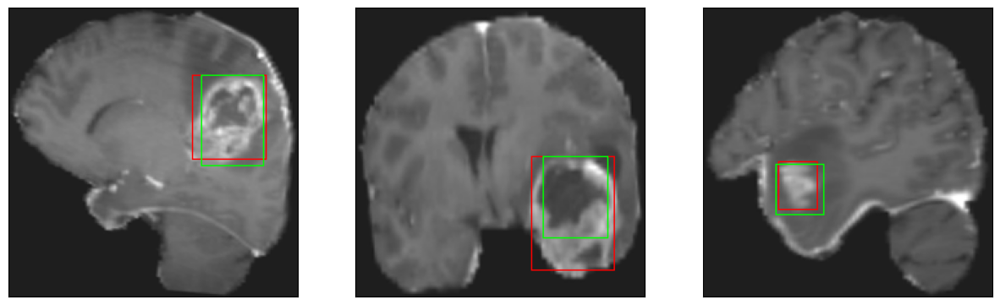

26/26 [==============================] - 3s 109ms/step - loss: 4.8004 - IoU: 0.6144 - val_loss: 7.1814 - val_IoU: 0.5733
Epoch 163/200
25/26 [===========================>..] - ETA: 0s - loss: 4.1609 - IoU: 0.6656
Epoch 163: val_IoU improved from 0.58933 to 0.59192, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


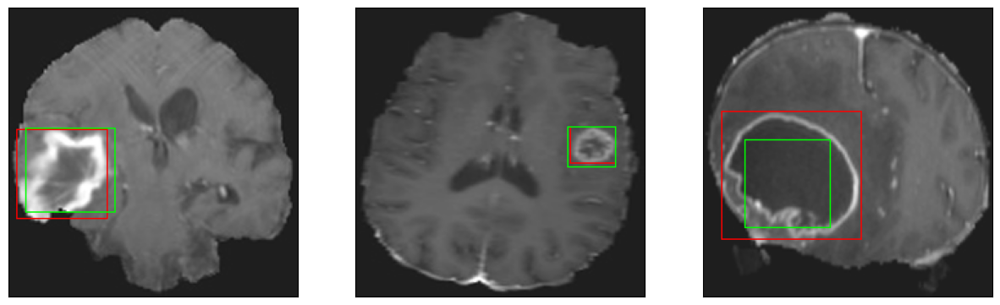

26/26 [==============================] - 3s 134ms/step - loss: 4.1348 - IoU: 0.6679 - val_loss: 6.7558 - val_IoU: 0.5919
Epoch 164/200
25/26 [===========================>..] - ETA: 0s - loss: 4.2383 - IoU: 0.6613
Epoch 164: val_IoU did not improve from 0.59192
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


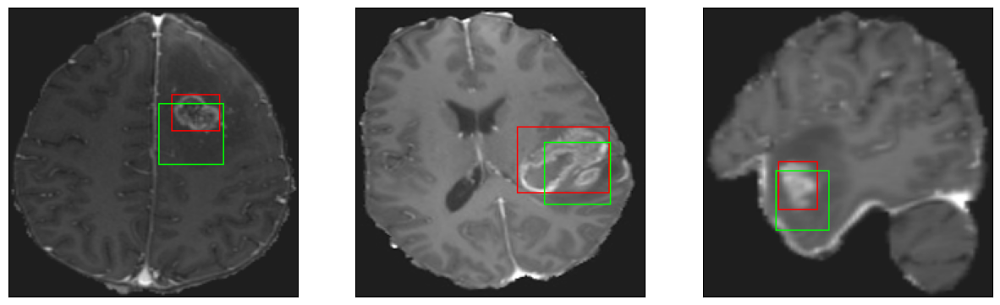

26/26 [==============================] - 3s 98ms/step - loss: 4.2987 - IoU: 0.6597 - val_loss: 8.6991 - val_IoU: 0.4826
Epoch 165/200
25/26 [===========================>..] - ETA: 0s - loss: 4.2926 - IoU: 0.6572
Epoch 165: val_IoU did not improve from 0.59192
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 9ms/step
4


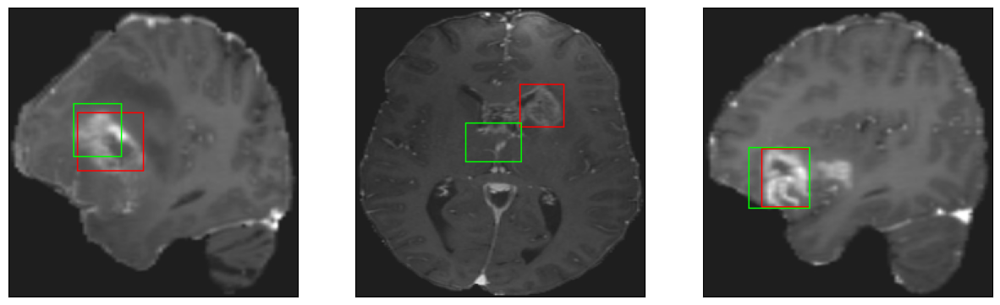

26/26 [==============================] - 3s 123ms/step - loss: 4.3131 - IoU: 0.6559 - val_loss: 7.6387 - val_IoU: 0.5386
Epoch 166/200
25/26 [===========================>..] - ETA: 0s - loss: 4.3884 - IoU: 0.6508
Epoch 166: val_IoU did not improve from 0.59192
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4


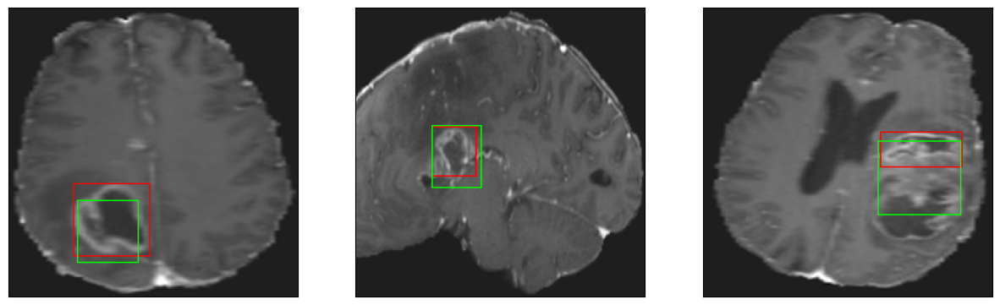

26/26 [==============================] - 3s 107ms/step - loss: 4.3834 - IoU: 0.6491 - val_loss: 7.6534 - val_IoU: 0.5468
Epoch 167/200
26/26 [==============================] - ETA: 0s - loss: 4.3000 - IoU: 0.6577
Epoch 167: val_IoU did not improve from 0.59192
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4


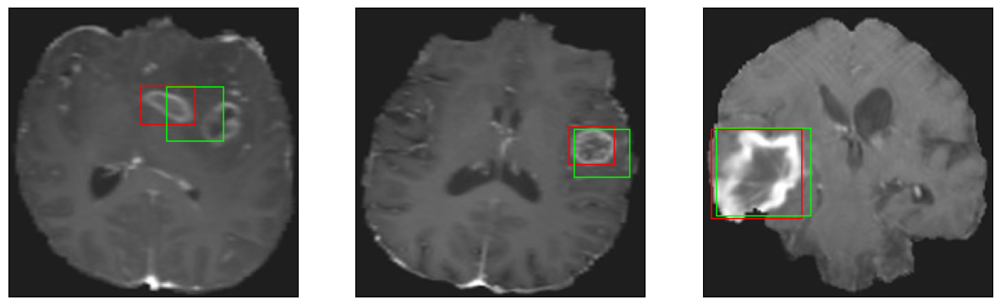

26/26 [==============================] - 3s 99ms/step - loss: 4.3000 - IoU: 0.6577 - val_loss: 7.5770 - val_IoU: 0.5320
Epoch 168/200
25/26 [===========================>..] - ETA: 0s - loss: 4.2480 - IoU: 0.6637
Epoch 168: val_IoU did not improve from 0.59192
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


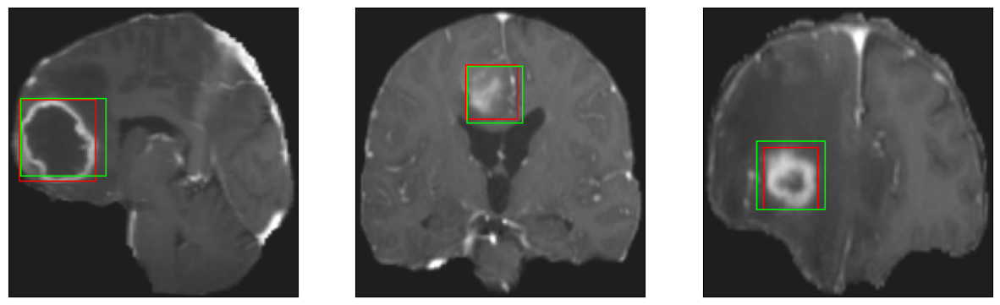

26/26 [==============================] - 3s 116ms/step - loss: 4.2494 - IoU: 0.6628 - val_loss: 7.7548 - val_IoU: 0.5338
Epoch 169/200
26/26 [==============================] - ETA: 0s - loss: 4.4440 - IoU: 0.6504
Epoch 169: val_IoU did not improve from 0.59192
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4


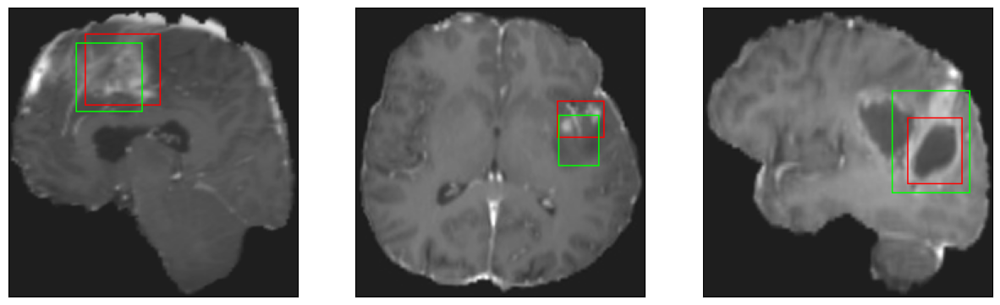

26/26 [==============================] - 3s 117ms/step - loss: 4.4440 - IoU: 0.6504 - val_loss: 8.0433 - val_IoU: 0.5322
Epoch 170/200
26/26 [==============================] - ETA: 0s - loss: 4.5993 - IoU: 0.6425
Epoch 170: val_IoU did not improve from 0.59192
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 11ms/step
4


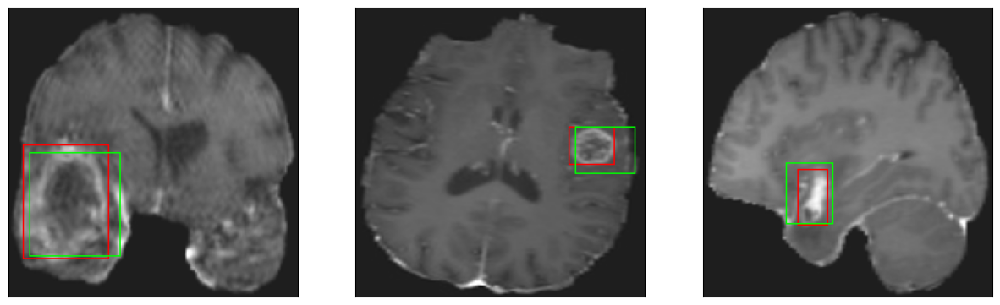

26/26 [==============================] - 3s 124ms/step - loss: 4.5993 - IoU: 0.6425 - val_loss: 7.3519 - val_IoU: 0.5633
Epoch 171/200
26/26 [==============================] - ETA: 0s - loss: 4.2784 - IoU: 0.6595
Epoch 171: val_IoU did not improve from 0.59192
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


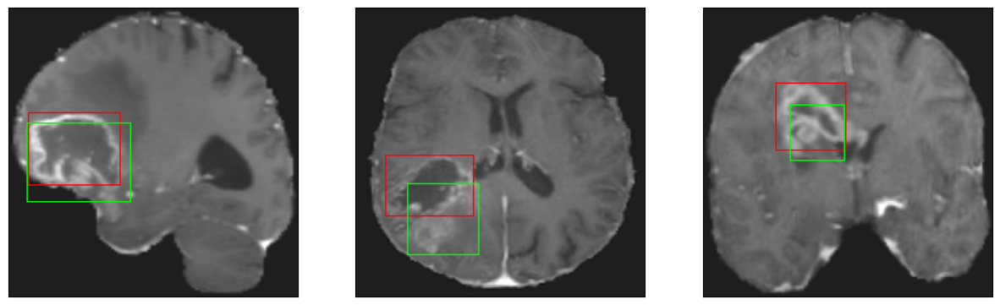

26/26 [==============================] - 3s 107ms/step - loss: 4.2784 - IoU: 0.6595 - val_loss: 9.0659 - val_IoU: 0.4577
Epoch 172/200
25/26 [===========================>..] - ETA: 0s - loss: 4.3607 - IoU: 0.6554
Epoch 172: val_IoU did not improve from 0.59192
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4


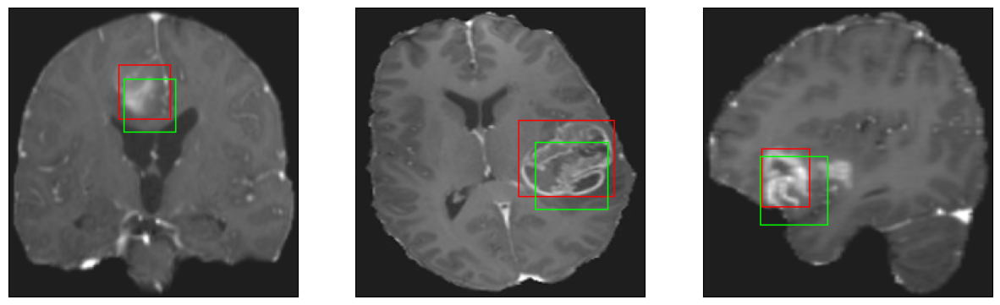

26/26 [==============================] - 3s 106ms/step - loss: 4.3460 - IoU: 0.6558 - val_loss: 10.6579 - val_IoU: 0.3901
Epoch 173/200
25/26 [===========================>..] - ETA: 0s - loss: 4.5184 - IoU: 0.6546
Epoch 173: val_IoU did not improve from 0.59192
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 10ms/step
4


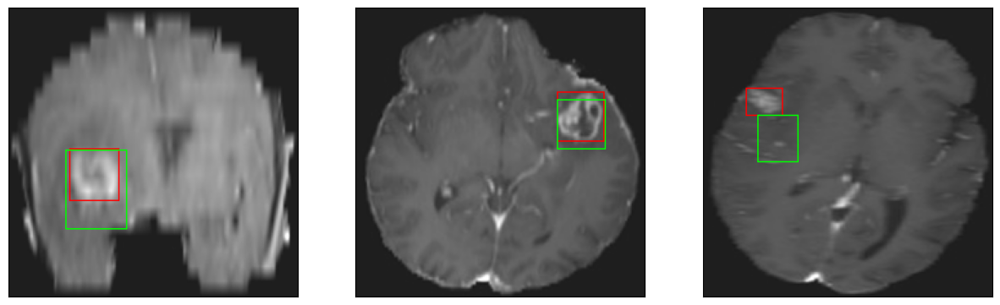

26/26 [==============================] - 3s 113ms/step - loss: 4.5862 - IoU: 0.6505 - val_loss: 7.6380 - val_IoU: 0.5577
Epoch 174/200
25/26 [===========================>..] - ETA: 0s - loss: 4.4087 - IoU: 0.6516
Epoch 174: val_IoU did not improve from 0.59192
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


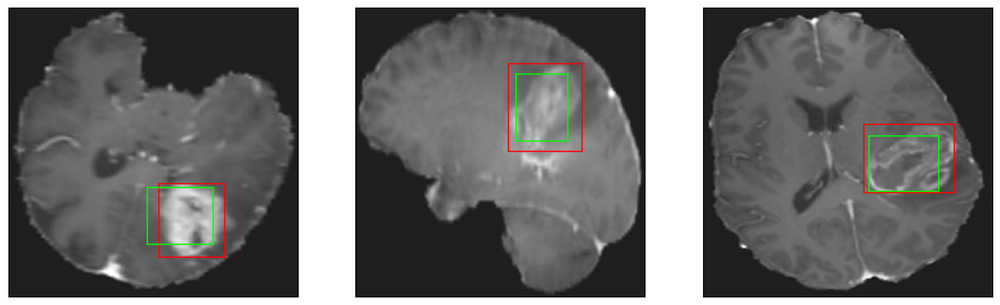

26/26 [==============================] - 3s 113ms/step - loss: 4.4256 - IoU: 0.6504 - val_loss: 7.4262 - val_IoU: 0.5479
Epoch 175/200
26/26 [==============================] - ETA: 0s - loss: 4.3967 - IoU: 0.6499
Epoch 175: val_IoU did not improve from 0.59192
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


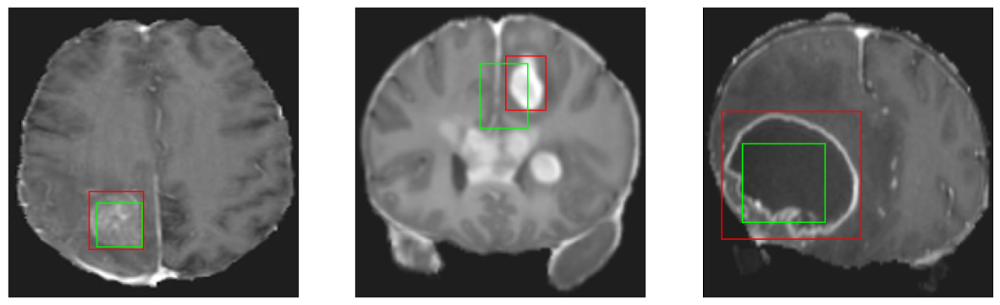

26/26 [==============================] - 3s 111ms/step - loss: 4.3967 - IoU: 0.6499 - val_loss: 7.2916 - val_IoU: 0.5614
Epoch 176/200
25/26 [===========================>..] - ETA: 0s - loss: 4.2916 - IoU: 0.6562
Epoch 176: val_IoU did not improve from 0.59192
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4


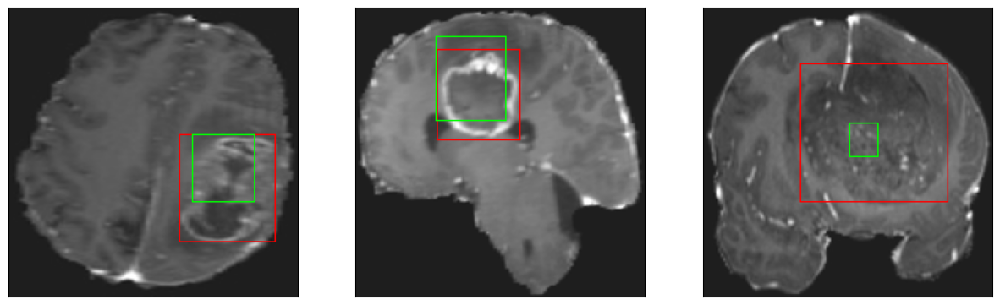

26/26 [==============================] - 3s 104ms/step - loss: 4.2941 - IoU: 0.6577 - val_loss: 8.7975 - val_IoU: 0.4511
Epoch 177/200
25/26 [===========================>..] - ETA: 0s - loss: 4.3655 - IoU: 0.6545
Epoch 177: val_IoU did not improve from 0.59192
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4


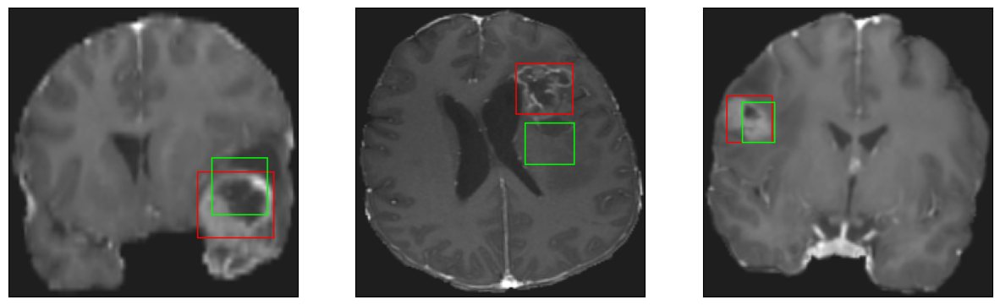

26/26 [==============================] - 3s 129ms/step - loss: 4.3285 - IoU: 0.6559 - val_loss: 7.0151 - val_IoU: 0.5721
Epoch 178/200
26/26 [==============================] - ETA: 0s - loss: 4.4174 - IoU: 0.6503
Epoch 178: val_IoU did not improve from 0.59192
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


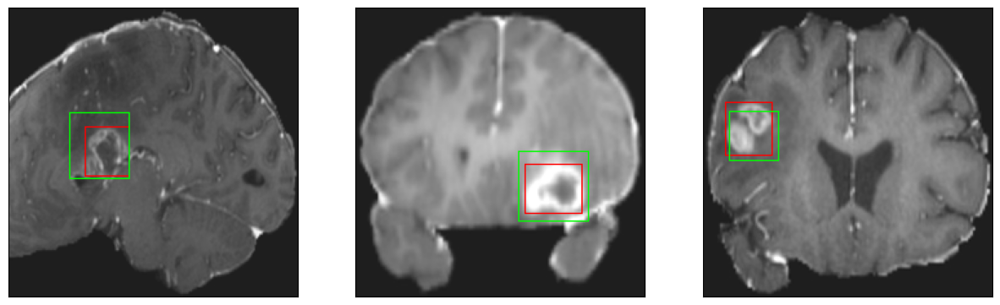

26/26 [==============================] - 3s 115ms/step - loss: 4.4174 - IoU: 0.6503 - val_loss: 7.5139 - val_IoU: 0.5524
Epoch 179/200
26/26 [==============================] - ETA: 0s - loss: 4.3443 - IoU: 0.6618
Epoch 179: val_IoU did not improve from 0.59192
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


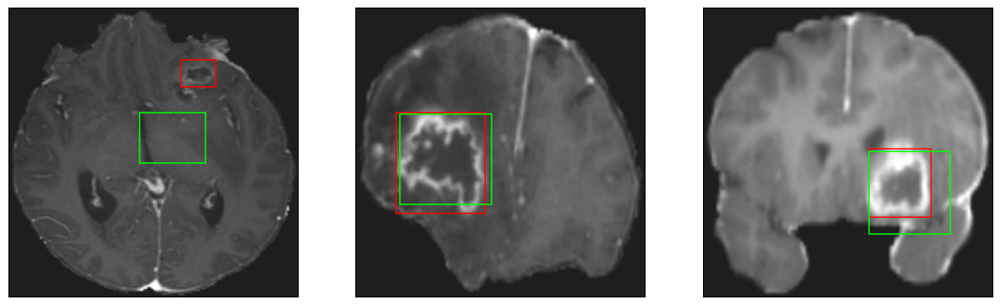

26/26 [==============================] - 3s 110ms/step - loss: 4.3443 - IoU: 0.6618 - val_loss: 7.9748 - val_IoU: 0.4931
Epoch 180/200
25/26 [===========================>..] - ETA: 0s - loss: 4.3408 - IoU: 0.6555
Epoch 180: val_IoU did not improve from 0.59192
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 10ms/step
4


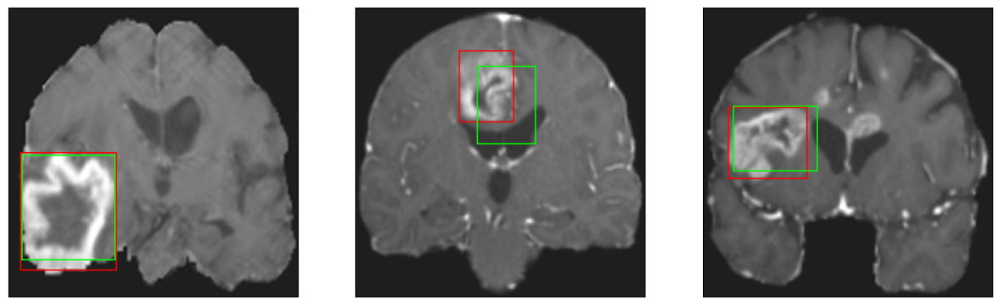

26/26 [==============================] - 3s 114ms/step - loss: 4.3505 - IoU: 0.6560 - val_loss: 7.4833 - val_IoU: 0.5241
Epoch 181/200
25/26 [===========================>..] - ETA: 0s - loss: 4.3855 - IoU: 0.6496
Epoch 181: val_IoU did not improve from 0.59192
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


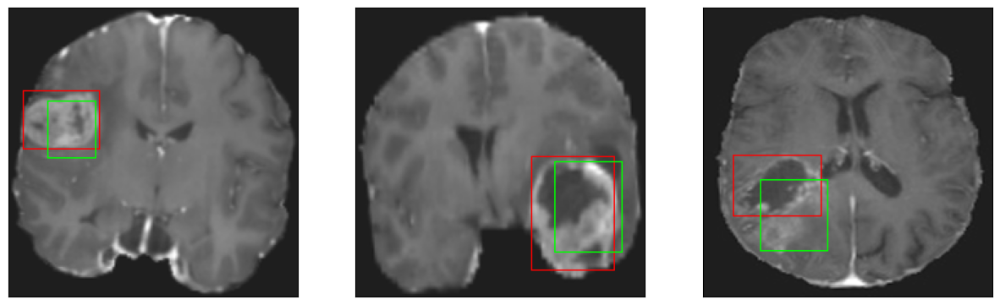

26/26 [==============================] - 3s 131ms/step - loss: 4.3450 - IoU: 0.6504 - val_loss: 7.6475 - val_IoU: 0.5141
Epoch 182/200
25/26 [===========================>..] - ETA: 0s - loss: 4.4736 - IoU: 0.6559
Epoch 182: val_IoU improved from 0.59192 to 0.59362, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


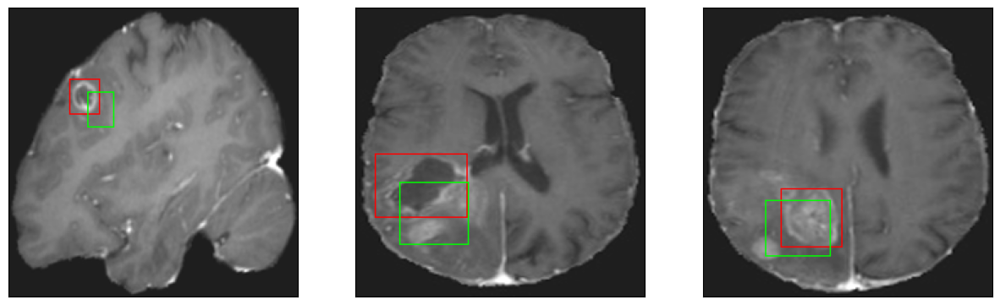

26/26 [==============================] - 4s 137ms/step - loss: 4.4206 - IoU: 0.6588 - val_loss: 6.6359 - val_IoU: 0.5936
Epoch 183/200
25/26 [===========================>..] - ETA: 0s - loss: 4.2262 - IoU: 0.6600
Epoch 183: val_IoU did not improve from 0.59362
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


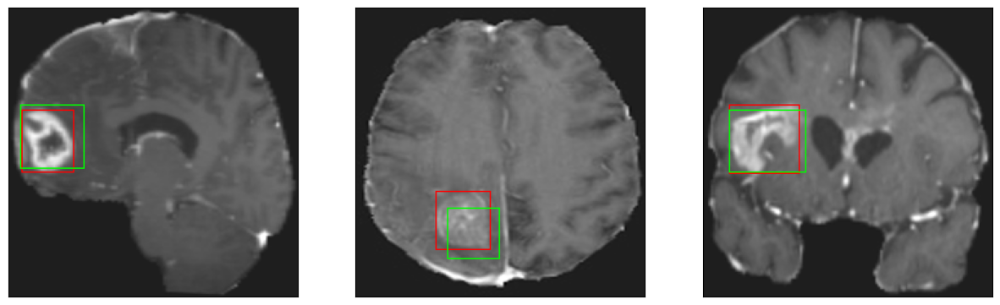

26/26 [==============================] - 3s 110ms/step - loss: 4.2836 - IoU: 0.6588 - val_loss: 7.6224 - val_IoU: 0.5395
Epoch 184/200
26/26 [==============================] - ETA: 0s - loss: 4.2948 - IoU: 0.6605
Epoch 184: val_IoU did not improve from 0.59362
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 8ms/step
4


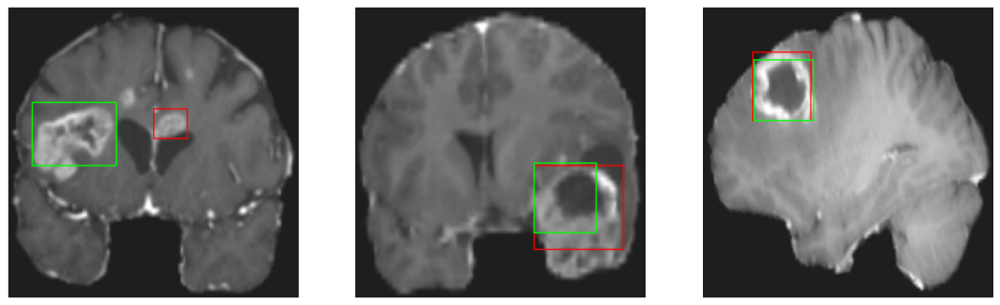

26/26 [==============================] - 3s 111ms/step - loss: 4.2948 - IoU: 0.6605 - val_loss: 6.9284 - val_IoU: 0.5680
Epoch 185/200
26/26 [==============================] - ETA: 0s - loss: 4.5081 - IoU: 0.6467
Epoch 185: val_IoU did not improve from 0.59362
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 10ms/step
4


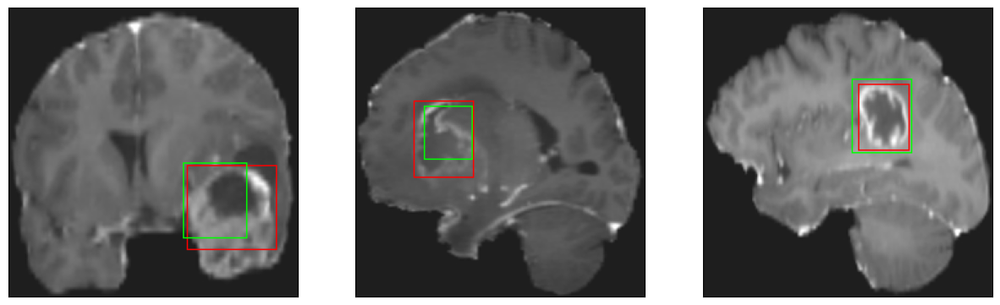

26/26 [==============================] - 4s 136ms/step - loss: 4.5081 - IoU: 0.6467 - val_loss: 6.9665 - val_IoU: 0.5793
Epoch 186/200
26/26 [==============================] - ETA: 0s - loss: 4.1059 - IoU: 0.6710
Epoch 186: val_IoU did not improve from 0.59362
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


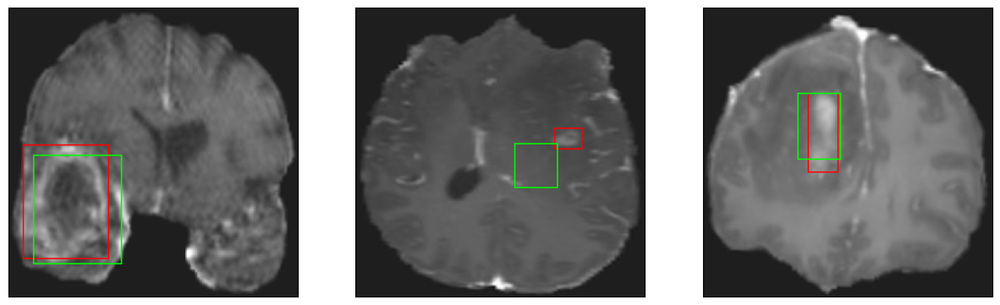

26/26 [==============================] - 3s 118ms/step - loss: 4.1059 - IoU: 0.6710 - val_loss: 8.2766 - val_IoU: 0.4985
Epoch 187/200
26/26 [==============================] - ETA: 0s - loss: 4.1756 - IoU: 0.6656
Epoch 187: val_IoU did not improve from 0.59362
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


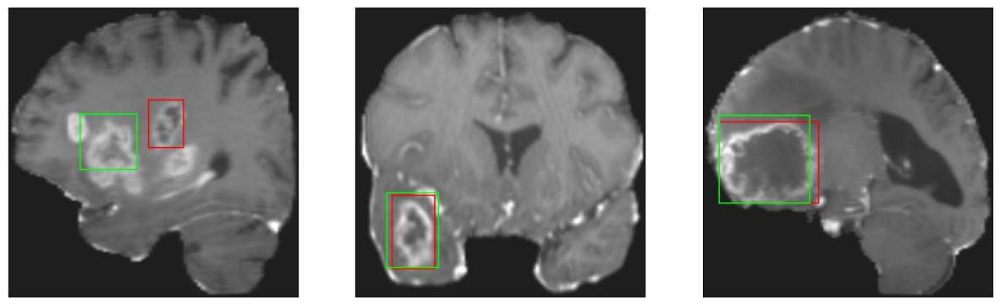

26/26 [==============================] - 3s 103ms/step - loss: 4.1756 - IoU: 0.6656 - val_loss: 7.1720 - val_IoU: 0.5718
Epoch 188/200
26/26 [==============================] - ETA: 0s - loss: 4.4395 - IoU: 0.6557
Epoch 188: val_IoU did not improve from 0.59362
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


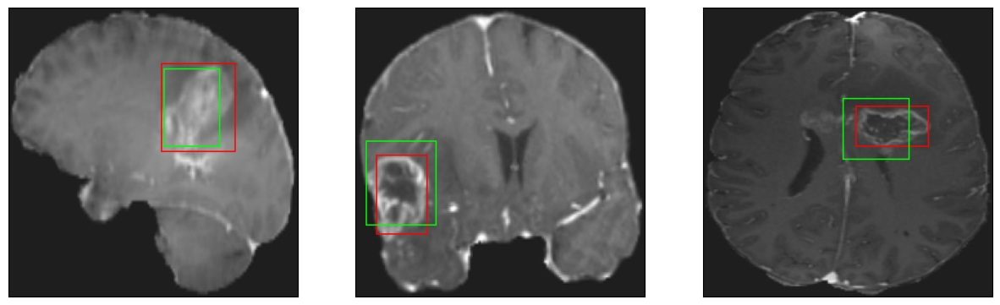

26/26 [==============================] - 3s 113ms/step - loss: 4.4395 - IoU: 0.6557 - val_loss: 7.2300 - val_IoU: 0.5607
Epoch 189/200
25/26 [===========================>..] - ETA: 0s - loss: 4.1564 - IoU: 0.6720
Epoch 189: val_IoU did not improve from 0.59362
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


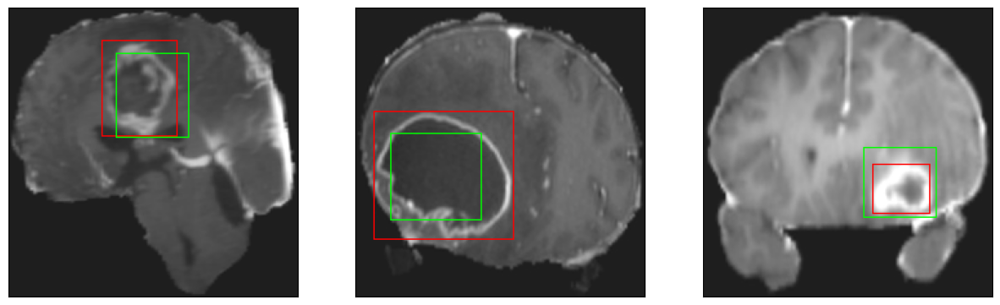

26/26 [==============================] - 3s 111ms/step - loss: 4.1635 - IoU: 0.6726 - val_loss: 6.9068 - val_IoU: 0.5900
Epoch 190/200
25/26 [===========================>..] - ETA: 0s - loss: 4.2971 - IoU: 0.6612
Epoch 190: val_IoU did not improve from 0.59362
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4


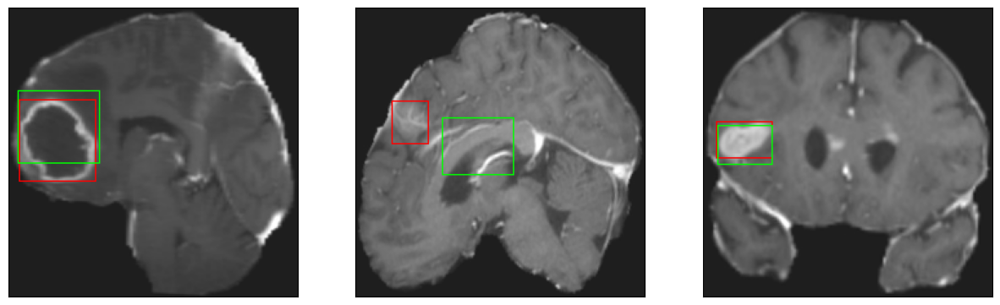

26/26 [==============================] - 3s 102ms/step - loss: 4.3067 - IoU: 0.6596 - val_loss: 6.7940 - val_IoU: 0.5726
Epoch 191/200
25/26 [===========================>..] - ETA: 0s - loss: 4.1482 - IoU: 0.6699
Epoch 191: val_IoU did not improve from 0.59362
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


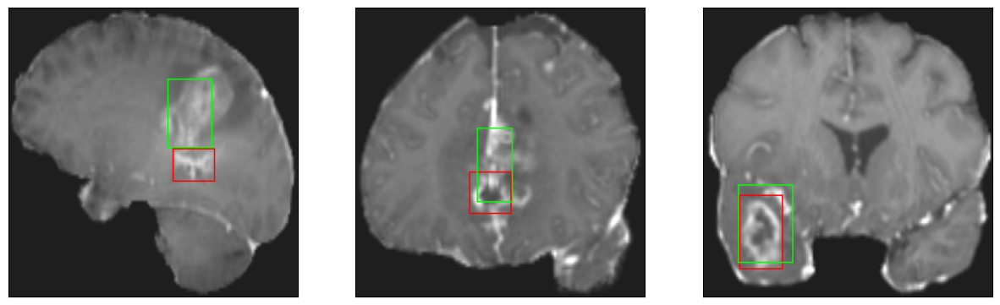

26/26 [==============================] - 3s 106ms/step - loss: 4.1363 - IoU: 0.6686 - val_loss: 9.3446 - val_IoU: 0.4617
Epoch 192/200
25/26 [===========================>..] - ETA: 0s - loss: 4.3750 - IoU: 0.6576
Epoch 192: val_IoU did not improve from 0.59362
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4


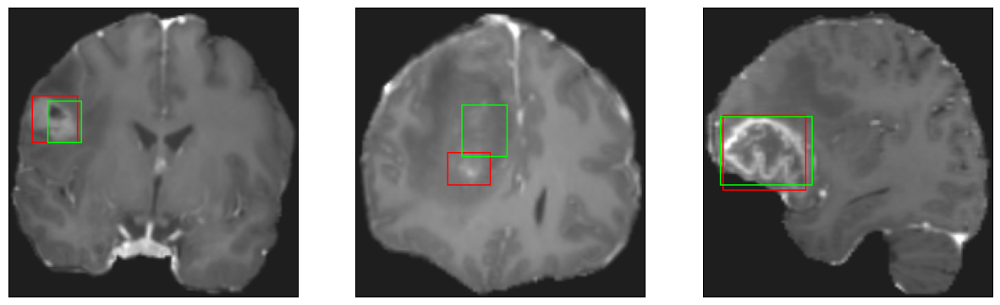

26/26 [==============================] - 3s 124ms/step - loss: 4.3690 - IoU: 0.6579 - val_loss: 6.8495 - val_IoU: 0.5797
Epoch 193/200
26/26 [==============================] - ETA: 0s - loss: 4.2222 - IoU: 0.6652
Epoch 193: val_IoU did not improve from 0.59362
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


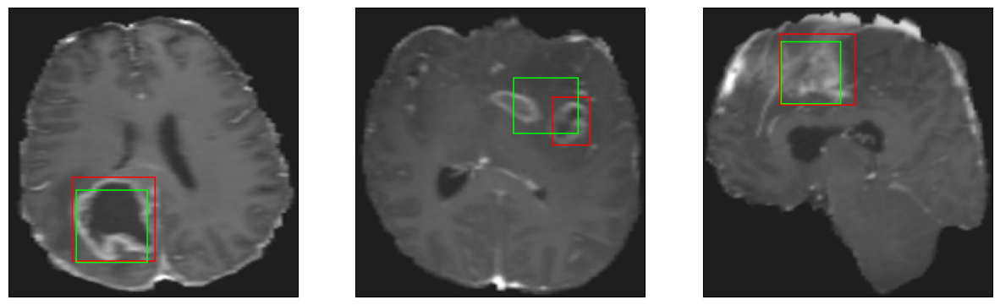

26/26 [==============================] - 3s 125ms/step - loss: 4.2222 - IoU: 0.6652 - val_loss: 7.0779 - val_IoU: 0.5685
Epoch 194/200
25/26 [===========================>..] - ETA: 0s - loss: 4.1973 - IoU: 0.6654
Epoch 194: val_IoU did not improve from 0.59362
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


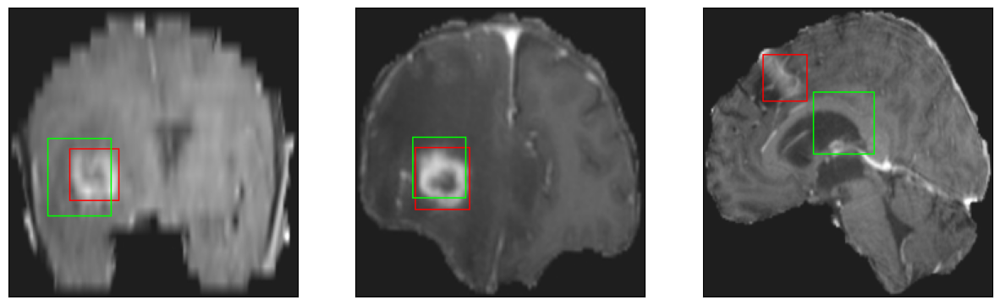

26/26 [==============================] - 3s 105ms/step - loss: 4.2178 - IoU: 0.6644 - val_loss: 9.2040 - val_IoU: 0.4754
Epoch 195/200
26/26 [==============================] - ETA: 0s - loss: 4.2206 - IoU: 0.6705
Epoch 195: val_IoU did not improve from 0.59362
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 10ms/step
4


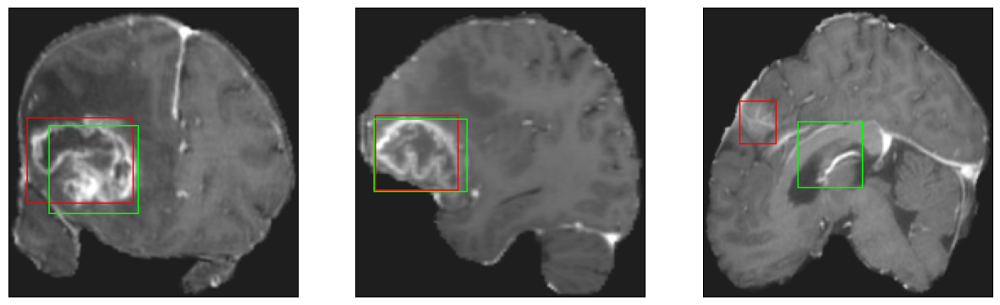

26/26 [==============================] - 3s 121ms/step - loss: 4.2206 - IoU: 0.6705 - val_loss: 6.9879 - val_IoU: 0.5780
Epoch 196/200
25/26 [===========================>..] - ETA: 0s - loss: 4.3694 - IoU: 0.6549
Epoch 196: val_IoU did not improve from 0.59362
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


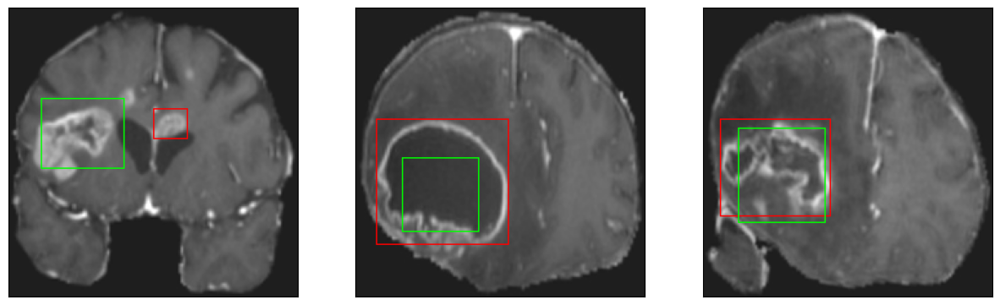

26/26 [==============================] - 3s 109ms/step - loss: 4.3670 - IoU: 0.6540 - val_loss: 8.0770 - val_IoU: 0.5146
Epoch 197/200
26/26 [==============================] - ETA: 0s - loss: 4.2385 - IoU: 0.6594
Epoch 197: val_IoU did not improve from 0.59362
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


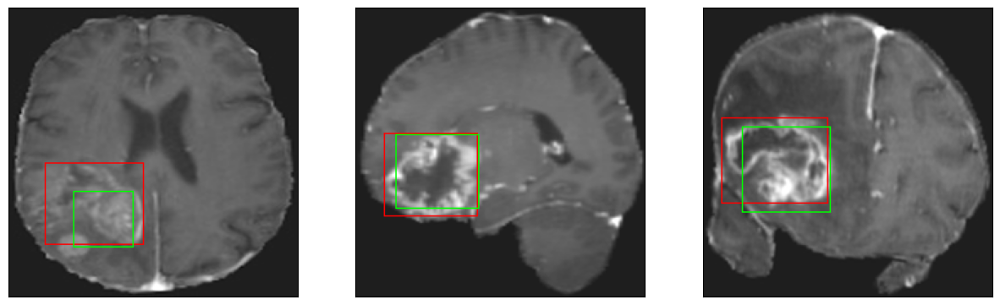

26/26 [==============================] - 3s 107ms/step - loss: 4.2385 - IoU: 0.6594 - val_loss: 7.1564 - val_IoU: 0.5764
Epoch 198/200
25/26 [===========================>..] - ETA: 0s - loss: 4.1626 - IoU: 0.6710
Epoch 198: val_IoU did not improve from 0.59362
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


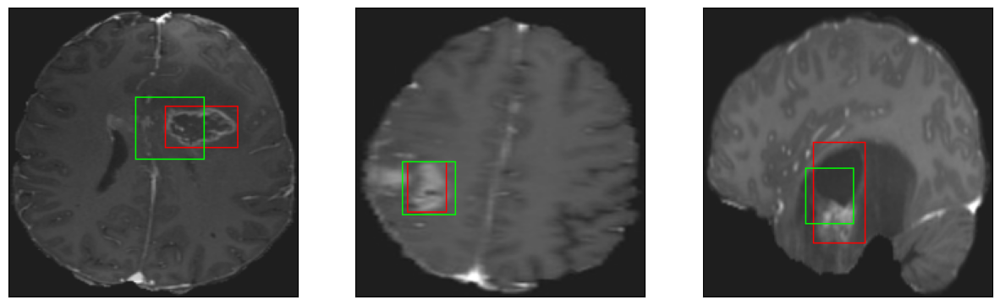

26/26 [==============================] - 3s 99ms/step - loss: 4.1921 - IoU: 0.6709 - val_loss: 7.6023 - val_IoU: 0.5502
Epoch 199/200
25/26 [===========================>..] - ETA: 0s - loss: 4.2139 - IoU: 0.6697
Epoch 199: val_IoU did not improve from 0.59362
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


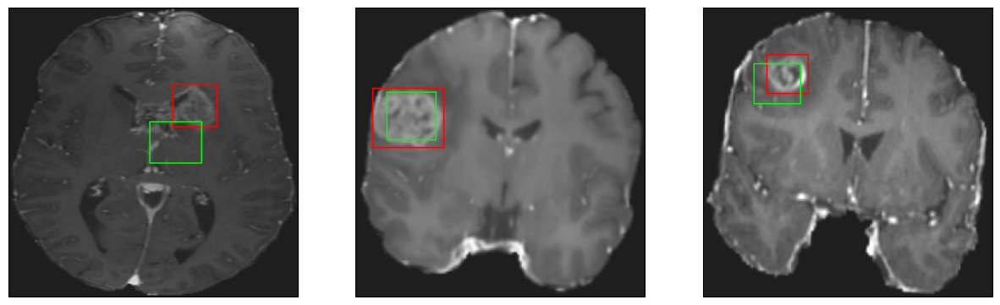

26/26 [==============================] - 3s 125ms/step - loss: 4.1755 - IoU: 0.6711 - val_loss: 7.7748 - val_IoU: 0.5188
Epoch 200/200
25/26 [===========================>..] - ETA: 0s - loss: 4.3861 - IoU: 0.6546
Epoch 200: val_IoU did not improve from 0.59362
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4


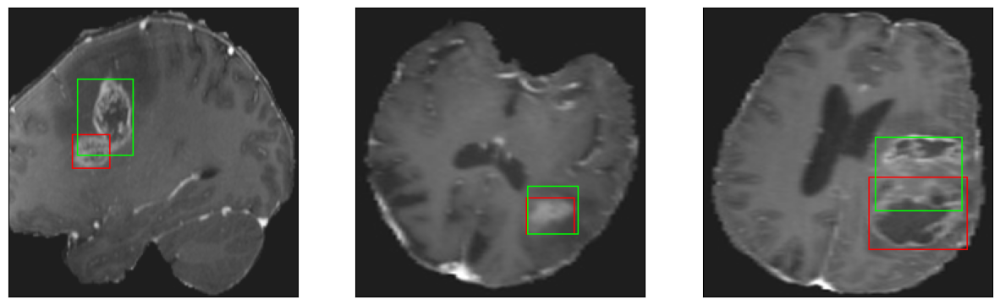

26/26 [==============================] - 3s 130ms/step - loss: 4.3633 - IoU: 0.6553 - val_loss: 7.9205 - val_IoU: 0.5327


In [25]:
hist = model.fit(
        train_dataset,
        epochs=200,
        validation_data = val_dataset,
        callbacks = callbacks_list
        )

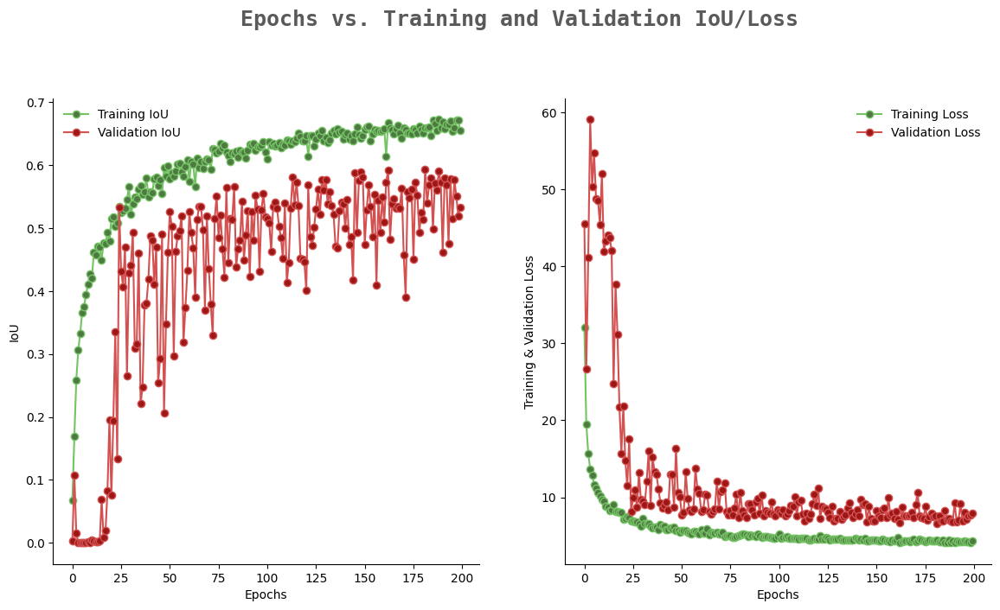

In [26]:
import seaborn as sns
colors_dark = ["#1F1F1F", "#313131", '#636363', '#AEAEAE', '#DADADA']
colors_red = ["#331313", "#582626", '#9E1717', '#D35151', '#E9B4B4']
colors_green = ['#01411C','#4B6F44','#4F7942','#74C365','#D0F0C0']
from warnings import filterwarnings
filterwarnings('ignore')

epochs = [i for i in range(200)]
fig, ax = plt.subplots(1,2,figsize=(14,7))
train_acc = hist.history['IoU']
train_loss = hist.history['loss']
val_acc = hist.history['val_IoU']
val_loss = hist.history['val_loss']

fig.text(s='Epochs vs. Training and Validation IoU/Loss',size=18,fontweight='bold',
             fontname='monospace',color=colors_dark[1],y=1,x=0.28,alpha=0.8)

sns.despine()
ax[0].plot(epochs, train_acc, marker='o',markerfacecolor=colors_green[2],color=colors_green[3],
           label = 'Training IoU')
ax[0].plot(epochs, val_acc, marker='o',markerfacecolor=colors_red[2],color=colors_red[3],
           label = 'Validation IoU')
ax[0].legend(frameon=False)
ax[0].set_xlabel('Epochs')
ax[0].set_ylabel('IoU')

sns.despine()
ax[1].plot(epochs, train_loss, marker='o',markerfacecolor=colors_green[2],color=colors_green[3],
           label ='Training Loss')
ax[1].plot(epochs, val_loss, marker='o',markerfacecolor=colors_red[2],color=colors_red[3],
           label = 'Validation Loss')
ax[1].legend(frameon=False)
ax[1].set_xlabel('Epochs')
ax[1].set_ylabel('Training & Validation Loss')

fig.show()

In [27]:
#iou = IoU(y_true, y_pred, 4, [1])
model = tf.keras.models.load_model('./model_checkpoint_SCRATCH/model_SCRATCH.h5',compile = False)

In [28]:
model.compile(
    loss={
        'coords': 'mae'
    },
    optimizer=tf.keras.optimizers.Adam(1e-3),
    metrics=[IoU]
)

In [29]:
model.evaluate(test_dataset)

8/8 [==============================] - 1s 41ms/step - loss: 9.4659 - IoU: 0.4827


[9.465899467468262, 0.48268061876296997]